In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy
import numpy as np
from google.colab import drive
import os
import torch
import torchvision.datasets as datasets
from torch.utils.data import Dataset, DataLoader
import numpy as np
import pandas as pd
import sys
from sklearn.preprocessing import StandardScaler
from scipy.interpolate import griddata
import random
from sklearn.decomposition import PCA
from sklearn.preprocessing import LabelEncoder
from sklearn.cluster import DBSCAN
import re
from scipy import stats
from sklearn.model_selection import train_test_split
from sklearn.metrics import pairwise_distances

In [2]:
class BrainDataset(Dataset):
    def __init__(self, data_file):
        loaded      = np.load(data_file)
        self.data   = loaded['corr_matrix']      # Shape: (N, 200, 200)
        self.labels = loaded['label']    # Shape: (N,)
        self.ids    = loaded['id']        # Shape: (N,)
        self.sites = []

        # Convert string labels to numeric
        self.label_mapping = {
          'Autism'            : 0,
          'Asperger'          : 1,
          'ADHD-Combined'     : 2,
          'ADHD-Hyperactive'  : 3,
          'ADHD-Inattentive'  : 4,
        }
        self.label_name = self.labels

        self.labels = np.array([self.label_mapping[label] for label in self.labels])

    def save_data(self, file_path):
      if not os.path.exists(file_path):
          self.reverse_mapping = self.reverse_label_mapping = {v: k for k, v in self.label_mapping.items()}
          label_name = np.array([self.reverse_mapping[label] for label in self.labels])
          np.savez(file_path, corr_matrix=self.data, label=label_name, id=self.ids)
          print("File saved successfully.")
      else:
          print("File already exists. No new file created.")

    def add_sites(self, sites):
        self.sites = sites

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        # Return each data slice as a tensor
        corr_matrix = torch.tensor(self.data[idx], dtype=torch.float32).unsqueeze(0)
        label       = torch.tensor(self.labels[idx], dtype=torch.long)
        subject_id  = self.ids[idx]

        return corr_matrix, label, subject_id


In [3]:
def flatten_upper_triangle(matrix):
    """
    Flatten the upper triangular part of a square matrix, excluding the diagonal.

    Args:
    - matrix (np.array): A 190x190 matrix to be flattened.

    Returns:
    - np.array: Flattened 1D array of upper triangular elements, excluding the diagonal.
    """
    # Get the upper triangular indices (excluding the diagonal)
    upper_triangle = np.triu(matrix, k=1)

    # Flatten the upper triangular part into a 1D array
    return upper_triangle[upper_triangle != 0]



def index_to_row_col(flat_index):
    """
    Convert a flattened upper triangular index (excluding diagonal) to a row and column in the original matrix.

    Args:
    - flat_index (int): Index in the flattened upper triangular array.
    - matrix_size (int): Size of the square matrix (e.g., 190 for a 190x190 matrix).

    Returns:
    - tuple: (row, col) corresponding to the original matrix.
    """

    matrix_size = 190
    # Calculate the row using the inverse sum formula
    row = int(np.floor((2 * matrix_size - 1 - np.sqrt((2 * matrix_size - 1)**2 - 8 * flat_index)) / 2))

    # Calculate the column based on the row
    col = flat_index - (row * (2 * matrix_size - row - 1)) // 2 + row + 1

    return row, col



def calculate_feature_variance(df):
  asd_df = df[df['label']=="ASD"]
  adhd_df = df[df['label']=="ADHD"]
  asd_vars = []
  adhd_vars = []

  for i, col in enumerate(df.columns):
    if col not in ['label', 'bin', 'cluster']:
      asd_var = np.var(asd_df[col].values)
      adhd_var = np.var(adhd_df[col].values)
      asd_vars.append((col, asd_var))
      adhd_vars.append((col, adhd_var))
  asd_vars.sort(key=lambda x: x[1], reverse=True)
  adhd_vars.sort(key=lambda x: x[1], reverse=True)
  return asd_vars, adhd_vars

def calculate_t_test_all_features(df):
  asd_df = df[df['label']=="ASD"]
  adhd_df = df[df['label']=="ADHD"]
  significant_feautres = []
  for i, col in enumerate(df.columns):
    if col not in ['label', 'bin', 'cluster']:
      t_stat, p_value = stats.ttest_ind(asd_df[col].values, adhd_df[col].values)
      # if p_value > 0.01:
      significant_feautres.append((col, t_stat, p_value))
    if ((i+1) % 100) == 0:
      print(f"Progress: {i + 1}/{len(df.columns)-1} features processed")

  significant_feautres.sort(key=lambda x: x[2], reverse=True)
  # significant_feautres = [x[0] for x in significant_feautres]
  # sf = np.array(significant_feautres)
  # reduced_df = df[sf]
  # reduced_df['label'] = df['label']
  return significant_feautres


def parse_aal(aal):
  pairs = re.findall(r'\["(.*?)": ([\d\.]+)\]', aal)
  max_val = -9999999999
  final_name = None
  for pair in pairs:
    name = pair[0]
    val = float(pair[1])
    if val > max_val:
      max_val = val
      final_name = name
  return final_name

def clean_net_df(df, map_df):
  roi_no = []
  reg_name = []
  net_id = []
  sys_name = []

  for i in range(df.shape[0]):
    row = df.iloc[i]

    roi_map = map_df[map_df['Mapping to 200 ROIs (atlas ROI number)'] == row['ROI no.']].values
    if(roi_map.shape[0] != 0):
      roi_no.append(roi_map[0][0])
      reg_name.append(parse_aal(row['AAL']))
      net_id.append(row['NetID'])
      sys_name.append(row['Suggested System'])

  df = pd.DataFrame({'roi_no': roi_no, 'name': reg_name, 'net_id': net_id, 'sys_name': sys_name})
  sorted_df = df.sort_values(by='roi_no').reset_index(drop=True)
  return sorted_df

def convert_to_asd_adhd(df):
  asd = ['Autism', 'Asperger']
  adhd = ['ADHD-Combined', 'ADHD-Hyperactive', 'ADHD-Inattentive']
  new_labels = []
  for label in df['label']:
    if label in asd:
      new_labels.append('ASD')
    elif label in adhd:
      new_labels.append('ADHD')
  df['label'] = new_labels
  return df



def extract_site_info():
  sites = []

  site_map = {
      1 : 'PEKING',
      2 : 'BRADLEY',
      3 : 'KKI',
      4 : 'NEURO',
      5 : 'NYU',
      6 : 'OREGON',
      7 : 'PITT',
      8 : 'WU',
  }

  name = {
      'CALTECH' : 'CALTECH',
      'CMU' : 'CMU',
      'KKI' : 'KKI',
      'LEUVEN_1' : 'LEUVEN',
      'LEUVEN_2' : 'LEUVEN',
      'MAX_MUN' : 'MAX_MUN',
      'NYU' : 'NYU',
      'OLIN' : 'OLIN',
      'PITT' : 'PITT',
      'SBL' : 'SBL',
      'SDSU' : 'SDSU',
      'TRINITY' : 'TRINITY',
      'UCLA_1' : 'UCLA',
      'UCLA_2' : 'UCLA',
      'UM_1' : 'UM',
      'UM_2' : 'UM',
      'USM' : 'USM',
      'YALE' : 'YALE'

  }
  autis_df = pd.read_excel(f"{SOURCE_DIR}/ABIDE_1_Autism.xlsx")
  aspgr_df = pd.read_excel(f"{SOURCE_DIR}/ABIDE_2_Asperger.xlsx")
  adhd1_df = pd.read_excel(f"{SOURCE_DIR}/ADHD_1_ADHD1.xlsx")
  adhd2_df = pd.read_excel(f"{SOURCE_DIR}/ADHD_2_ADHD2.xlsx")
  adhd3_df = pd.read_excel(f"{SOURCE_DIR}/ADHD_3_ADHD3.xlsx")
  for i in range(autis_df.shape[0]):
    row = autis_df.iloc[i]
    sites.append(name[row['SITE_ID']])

  for i in range(aspgr_df.shape[0]):
    row = aspgr_df.iloc[i]
    sites.append(name[row['SITE_ID']])

  for i in range(adhd1_df.shape[0]):
    row = adhd1_df.iloc[i]
    sites.append(site_map[int(row['Site'])])

  for i in range(adhd2_df.shape[0]):
    row = adhd2_df.iloc[i]
    sites.append(site_map[int(row['Site'])])

  for i in range(adhd3_df.shape[0]):
    row = adhd3_df.iloc[i]
    sites.append(site_map[int(row['Site'])])

  return sites

def split_discovery_vs_replication(df):
  # 'OLIN': ASD 0
  # 'WU' : ADHD 0

  replication_sites = ['LEUVEN', 'MAX_MUN', 'TRINITY', 'SBL', 'NEURO']
  discovery_sites = ['CALTECH', 'CMU', 'NYU', 'KKI', 'PITT', 'SDSU', 'OLIN', 'UCLA', 'YALE', 'USM', 'UM', 'OREGON', 'PEKING', 'WU']
  # discovery_sites = ['CALTECH', 'CMU', 'KKI', 'LEUVEN', 'MAX-MUN', 'KKI', 'UM', 'TRINITY', 'NEURO', 'OREGON', 'SDSU']
  # replication_sites = ['NYU', 'PITT', 'SBL', 'UCLA', 'USM', 'YALE', 'PEKING']

  discovery_df = df[df['site'].isin(discovery_sites)]
  replication_df = df[df['site'].isin(replication_sites)]

  return discovery_df, replication_df

In [5]:
drive.mount('/content/drive')

Mounted at /content/drive


In [6]:
SOURCE_DIR = '/content/drive/MyDrive/BrainMapper'

In [7]:
dataset = BrainDataset(f"{SOURCE_DIR}/adhd_autism_balanced.npz")
map_df = pd.read_excel(f"{SOURCE_DIR}/mapping_from_190_to_200_ROIs.xlsx")
net_df = clean_net_df(pd.read_excel(f"{SOURCE_DIR}/brainnet/ABIDE_CC200_ROI_labels_netID.xlsx"), map_df)

In [8]:
sites = extract_site_info()
dataset.add_sites(sites)

In [9]:
flattened_data = np.array([flatten_upper_triangle(data) for data in dataset.data])

In [10]:
disorders_df = pd.DataFrame(flattened_data)
disorders_df['label'] = dataset.label_name
disorders_df['site'] = dataset.sites

In [11]:
disorders_df = convert_to_asd_adhd(disorders_df)

In [12]:
disorders_df

,0,1,2,3,4,5,6,7,8,9,...,17947,17948,17949,17950,17951,17952,17953,17954,label,site
0,-0.159003,0.121674,-0.110528,0.040946,0.061012,0.218532,-0.116653,-0.127646,-0.072935,0.159911,...,0.034595,-0.036011,-0.167147,-0.024334,0.058773,0.379620,-0.257534,0.037078,ASD,PITT
1,0.134749,-0.030202,-0.022602,-0.124251,0.311727,0.260374,-0.215447,0.026495,-0.146986,0.296062,...,-0.092513,-0.241298,0.142973,-0.017589,0.003593,0.156665,0.093604,0.145610,ASD,PITT
2,-0.008385,-0.106489,0.021105,-0.170466,0.012640,-0.077925,0.198790,-0.092148,0.101080,0.174465,...,-0.256040,-0.068893,0.062609,-0.040470,-0.056836,0.342685,-0.208628,0.055516,ASD,PITT
3,-0.083274,0.160009,-0.043249,0.100278,0.128468,-0.153655,-0.095791,-0.030722,-0.163404,-0.106271,...,-0.236650,-0.006124,0.266625,-0.021530,-0.037560,0.321644,-0.061440,0.089409,ASD,PITT
4,-0.002659,-0.130369,-0.130934,0.199572,0.519946,0.019540,0.131425,-0.124215,-0.042407,0.351939,...,0.034837,-0.023036,-0.022289,0.088563,0.219354,0.286932,-0.274767,0.083007,ASD,PITT
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
784,-0.122717,0.116301,-0.144153,-0.067895,0.035930,0.083082,-0.042607,0.113966,0.123379,0.202125,...,0.097179,-0.014457,0.125590,0.092041,-0.116011,0.062645,-0.166518,-0.011614,ADHD,PEKING
785,0.070323,-0.426320,-0.130980,-0.406507,-0.331305,0.668001,-0.029118,0.017075,-0.466841,0.570739,...,-0.300257,-0.402185,0.076603,0.237105,0.254215,-0.132144,-0.254622,0.323329,ADHD,OREGON
786,0.217768,0.044758,0.121610,-0.010863,0.169100,0.549613,-0.023648,0.068217,-0.227158,0.259704,...,-0.111034,-0.322116,0.190658,0.010924,-0.183800,0.366018,-0.340124,-0.191144,ADHD,PEKING
787,0.072705,-0.169827,-0.183667,-0.026850,0.106967,-0.307535,0.091945,-0.068768,-0.154723,0.075556,...,-0.074016,-0.002468,0.060399,0.072375,0.105013,0.026564,-0.215515,0.091839,ADHD,PEKING


In [21]:
dataset.data[0].shape

(190, 190)

In [20]:
dataset.label_name[0]

np.str_('Autism')

In [ ]:
disorders_df['site'].value_counts()

,count
site,
NYU,221
PEKING,102
UM,65
USM,57
UCLA,54
KKI,47
OREGON,43
NEURO,36
PITT,34


In [ ]:
# disorders_df[disorders_df['site']=="NEURO"]

In [ ]:
discovery_df, replication_df = split_discovery_vs_replication(disorders_df)
print(discovery_df.shape, replication_df.shape)
discovery_df = discovery_df.drop(columns=['site'])
replication_df = replication_df.drop(columns=['site'])

(674, 17957) (115, 17957)


In [ ]:
discovery_df.to_csv(f'{SOURCE_DIR}/discovery_df_572.csv', index=False)

In [ ]:
replication_df.to_csv(f'{SOURCE_DIR}/replication_df_217.csv', index=False)

In [ ]:
def plot_projection_function(df, proj_f):
  if proj_f == "PC1":
    pca = PCA(n_components=1)
    pca_data = pca.fit_transform(df.iloc[:, :-1].values)
    x = pca_data

  elif proj_f == "l1-norm":
    l1norm = np.linalg.norm(df.iloc[:, :-1].values, ord=1, axis=1)
    x = l1norm

  elif proj_f == "l2-norm":
    l2norm = np.linalg.norm(df.iloc[:, :-1].values, ord=2, axis=1)
    x = l2norm

  print("min=", np.min(x))
  print("max=", np.max(x))
  labels = df.iloc[:, -1].values  # Labels
  # Encode the labels to numeric values
  encoded_labels = LabelEncoder().fit_transform(labels)

  # Separate x values by class
  class_0_x = x[encoded_labels == 0]  # x values for class 0
  class_1_x = x[encoded_labels == 1]  # x values for class 1

  # Get the original class labels (before encoding)
  original_labels = np.unique(labels)

  # Plot histograms for each class
  plt.hist(class_0_x, bins=20, alpha=0.7, label=original_labels[0], color='#1f77b4', edgecolor='black')
  plt.hist(class_1_x, bins=20, alpha=0.7, label=original_labels[1], color='#ff7f0e', edgecolor='black')

  # Add labels and title
  plt.xlabel(proj_f, fontsize=20)
  plt.ylabel('Frequency', fontsize=20)
  plt.xticks(fontsize=16)
  plt.yticks(fontsize=16)


  # Add legend with original string labels
  plt.legend(fontsize=20)

  # plt.savefig(f"{proj_f}.png")
  plt.savefig(f"{proj_f}.png", dpi=300, bbox_inches='tight')
  # Show plot
  plt.show()

  # return pca_data

min= -10.356653146437997
max= 7.027641733997794


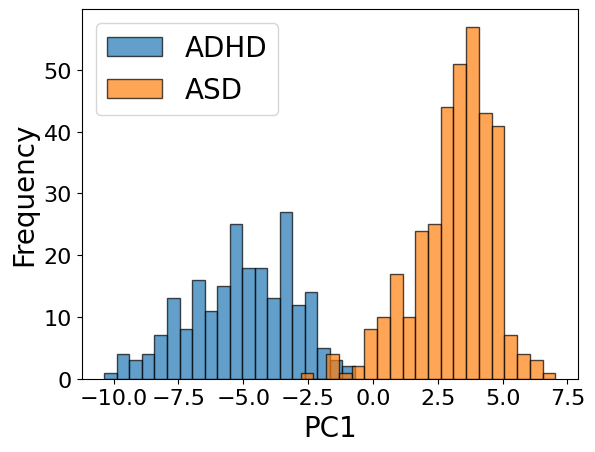

In [ ]:
pca_data = plot_projection_function(discovery_df, "PC1")

min= 1609.6157075381702
max= 4449.304049124703


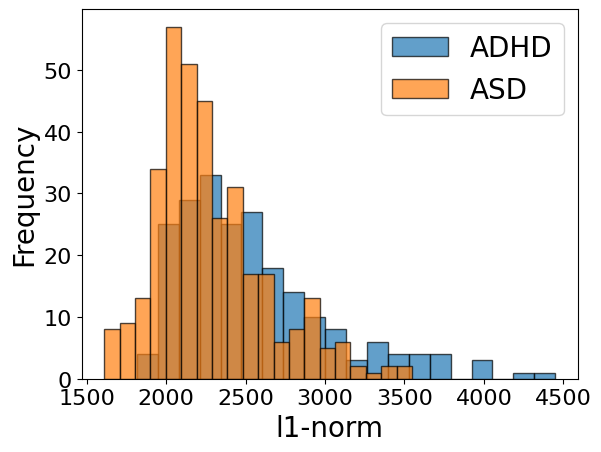

In [ ]:
plot_projection_function(discovery_df, "l1-norm")

min= 15.730292367448977
max= 41.4723584813477


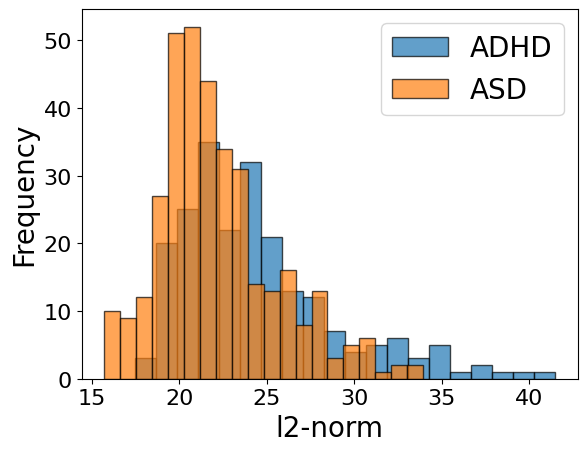

In [ ]:
plot_projection_function(discovery_df, "l2-norm")

In [ ]:
def plot_overlapping_area(df):

  # Assuming disorders_df is your DataFrame
  x = df.iloc[:, :-1].values # Feature 1
  labels = df.iloc[:, -1].values  # Labels

  # Encode the labels to numeric values
  encoded_labels = LabelEncoder().fit_transform(labels)

  # Separate x values by class
  class_0_x = x[encoded_labels == 0]  # x values for class 0
  class_1_x = x[encoded_labels == 1]  # x values for class 1

  # Get the original class labels (before encoding)
  original_labels = np.unique(labels)

  # Plot histograms for each class
  plt.hist(class_0_x, bins=20, alpha=0.7, label=original_labels[0], color='#1f77b4', edgecolor='black')
  plt.hist(class_1_x, bins=20, alpha=0.7, label=original_labels[1], color='#ff7f0e', edgecolor='black')

  # Add labels and title
  plt.xlabel('PC1', fontsize=16)
  plt.ylabel('Frequency', fontsize=16)
  plt.xticks(fontsize=12)
  plt.yticks(fontsize=12)
  plt.title('Histogram of x for Class 0 and Class 1')

  # Add legend with original string labels
  plt.legend(title="Classes")

  # Show plot
  plt.show()


def get_features_contribution_on_pca(df):
  # array_sf = np.array(sf)
  # selected_features = array_sf[0:, 0]
  # selected_features = np.sort(selected_features)

  # filt_df = df[selected_features]
  feature_cols = [x for x in df.columns.to_list() if x not in ['bin', 'second_bin', 'label', 'cluster']]
  pca = PCA(n_components=1)
  pca_data = pca.fit_transform(df[feature_cols].values)

  W = pca.components_.T.flatten()

  return W

def project_data_to_pca_axis(df, weight):
  feature_cols = [x for x in df.columns.to_list() if x not in ['bin', 'second_bin', 'label', 'cluster']]
  X_centered = df[feature_cols].values - np.mean(df[feature_cols].values, axis=0)
  xw = np.dot(X_centered, weight)
  final_df = pd.DataFrame(xw, columns=['PC1'])
  # print(final_df.shape, df['label'].shape)
  final_df['label'] = df['label'].reset_index(drop=True)
  return final_df


def extract_bin_intervals(df, num_intervals, perc_overlap):
    # Extract labels
    labels = df['label'].values

    # Apply PCA (reduce to 1D)
    pca = PCA(n_components=1)
    pca_data = pca.fit_transform(df.iloc[:, :-1].values).flatten()  # Convert to 1D array

    # Compute min and max values of PCA-transformed data
    bound_min, bound_max = np.min(pca_data), np.max(pca_data)

    # Compute interval length based on Mapper algorithm
    total_length = bound_max - bound_min
    interval_length = total_length / (num_intervals * (1 - perc_overlap / 100) + perc_overlap / 100)
    overlap_length = interval_length * (perc_overlap / 100)

    # Generate bin intervals
    bins = []
    start_of_interval = bound_min

    for i in range(num_intervals):
        end_of_interval = start_of_interval + interval_length
        bins.append((start_of_interval, end_of_interval))

        # Shift start for the next interval (overlap at the beginning except the first one)
        start_of_interval = end_of_interval - overlap_length if i > 0 else end_of_interval

    return np.array(bins)

def classify_val_data_on_train_bins(train_df, test_df):
    # Extract labels
    bins = extract_bin_intervals(train_df, 15, 35)
    labels = train_df['label'].values

    pca_weight = get_features_contribution_on_pca(train_df)

    projected_test_df = project_data_to_pca_axis(test_df, pca_weight)
    projected_test = projected_test_df['PC1'].values

    bins_1 = np.full(len(projected_test), -1)  # Default to -1 (no bin found)
    bins_2 = np.full(len(projected_test), -1)
    for i, value in enumerate(projected_test):
        for bin_idx, (start, end) in enumerate(bins):
            # print(start, end, value)
            if start <= value and value < end:  # Assign data point to the correct bin
                if(bins_1[i] == -1):
                  bins_1[i] = bin_idx + 1
                else:
                  bins_2[i] = bin_idx + 1
                break  # Stop searching once a match is found

    test_df = test_df.reset_index(drop=True)
    test_df['bin'] = bins_1
    test_df['second_bin'] = bins_2
    # test_df = test_df[test_df['bin'] != -1]
    # test_df = test_df.reset_index(drop=True)
    return test_df

In [ ]:
discovery_weight = get_features_contribution_on_pca(discovery_df)
projected_repli_df = project_data_to_pca_axis(replication_df, discovery_weight)

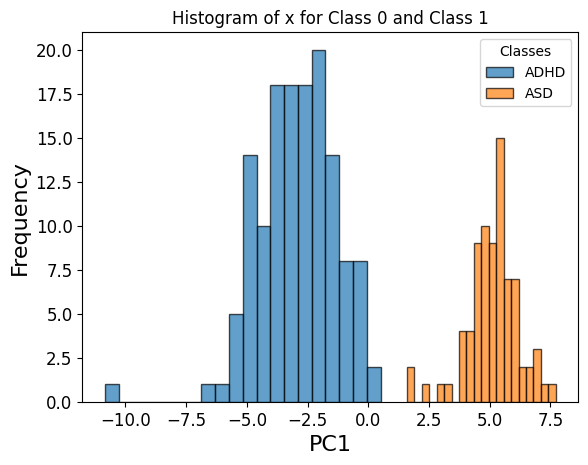

In [ ]:
plot_overlapping_area(projected_repli_df)

In [ ]:
def count_outliers(labels):
    return len([label for label in labels if label == -1])

def count_non_outliers(labels):
    return len([label for label in labels if label != -1])

def count_clusters(labels):
    return len(set(labels)) - (1 if -1 in labels else 0)


In [ ]:
def plot_epsilon_vs_outlier(df, plot_label, eps_start, eps_end, eps_step, min_pts):

  feature_columns = [col for col in df.columns if col not in ['label', 'bin', 'second_bin', 'cluster', 'second_cluster']]
  data = df[feature_columns + ['label']].values
  X_data, y_data = data[:, :-1], data[:, -1]

  outliers = []
  non_outliers = []
  clusters = []
  outliers_percentage = []

  eps_range = np.arange(eps_start, eps_end, eps_step)


  for eps in eps_range:
  # Create DBSCAN model
    dbscan = DBSCAN(eps=eps, min_samples=min_pts, metric='euclidean')

    # Fit the model to the scaled data
    dbscan.fit(X_data)

    # Get the cluster labels (-1 means outliers)
    labels = dbscan.labels_

    n_outliers = count_outliers(labels)
    n_non_outliers = count_non_outliers(labels)
    n_clusters = count_clusters(labels)
    n_outliers_percentage = n_outliers / len(labels) * 100

    outliers.append(n_outliers)
    non_outliers.append(n_non_outliers)
    clusters.append(n_clusters)
    outliers_percentage.append(n_outliers_percentage)

  x = eps_range

  # Create a plot
  fig, ax1 = plt.subplots()

  # Plot outliers on the left y-axis
  ax1.plot(x, outliers_percentage, label='Outliers Percentage(%)', color='g', linewidth=4)
  ax1.set_xlabel('Epsilon', fontsize=16)
  ax1.set_ylabel('Outliers (%)', color='g', fontsize=16)
  ax1.tick_params(axis='y', labelcolor='g')

  # Create a second y-axis
  ax2 = ax1.twinx()

  # Plot clusters on the right y-axis
  ax2.plot(x, clusters, label='Clusters', color='b', linewidth=4)
  ax2.set_ylabel('Number of Clusters', color='b', fontsize=16)
  ax2.tick_params(axis='y', labelcolor='b')
  print(outliers_percentage)
  ax1.set_xticks(np.arange(eps_start, eps_end, 1))
  ax1.set_yticks(np.arange(0, 100, 10))
  ax2.set_yticks(np.arange(0, 10, 1))


  ax1.set_xticklabels(ax1.get_xticks(), fontsize=13)
  ax1.set_yticklabels(ax1.get_yticks(), fontsize=13)
  ax2.set_yticklabels(ax2.get_yticks(), fontsize=13)

  # Add a title and legends
  # plt.title(f"DBSCAN Analysis ({plot_label};min_pts={min_pts})")
  # ax1.legend(loc='upper left')
  # ax2.legend(loc='upper right')

[67.83216783216784, 50.87412587412587, 38.98601398601399, 31.46853146853147, 24.475524475524477, 16.083916083916083, 11.888111888111888, 8.566433566433567, 6.993006993006993, 5.244755244755245, 4.195804195804196, 3.3216783216783217, 2.6223776223776225]


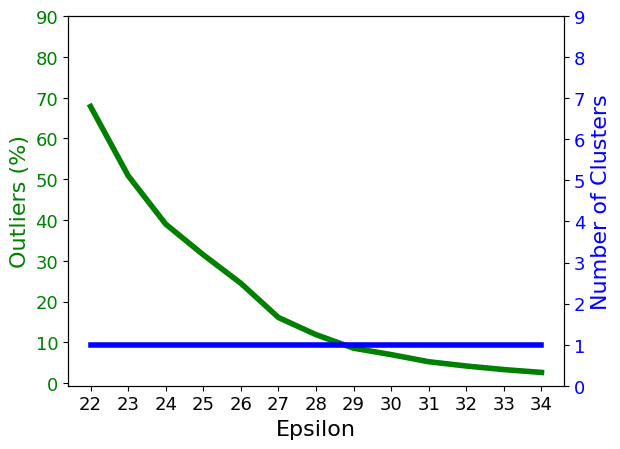

In [ ]:
plot_epsilon_vs_outlier(discovery_df, 'All Disorders', 22, 35, 1, 5)

In [ ]:
from sklearn.neighbors import NearestNeighbors

def elbow_methods(df, k):
  feature_columns = [col for col in df.columns if col not in ['label', 'bin', 'second_bin', 'cluster', 'second_cluster']]
  data = df[feature_columns].values
  neighbors = NearestNeighbors(n_neighbors=k)
  neighbors_fit = neighbors.fit(data)
  distances, indices = neighbors_fit.kneighbors(data)

  k_distances = np.sort(distances[:, k-1])
  plt.plot(k_distances, linewidth=5)
  plt.xlabel("Sorted points", fontsize=20)
  plt.ylabel(f"{k}-NN distance", fontsize=20)
  # plt.title("k-distance Graph (Elbow Method)")
  plt.xticks(fontsize=20)
  plt.yticks(fontsize=20)
  plt.grid(True)

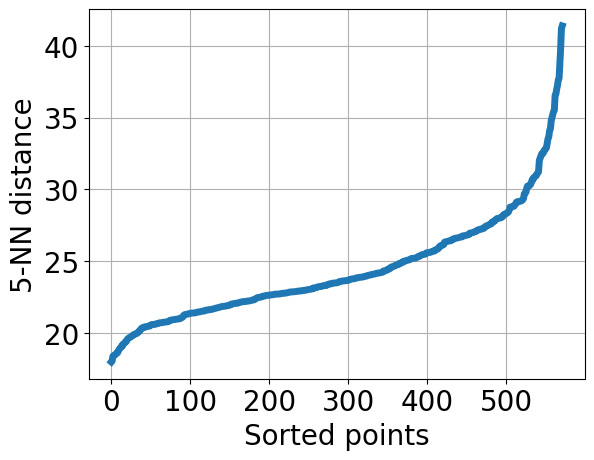

In [ ]:
elbow_methods(discovery_df, 5)

## Apply binning and DBSCAN to the replication dataset

In [ ]:
def extract_bin_intervals(df, num_intervals, perc_overlap):
    n_cubes = np.array([num_intervals])
    perc_overlap = np.array([perc_overlap / 100])
    # Extract labels
    print("n_cubes:", n_cubes)
    print("perc_overlap:", perc_overlap)

    labels = df['label'].values

    # Apply PCA (reduce to 1D)
    feature_cols = [x for x in df.columns.to_list() if x not in ['bin', 'second_bin', 'label', 'cluster']]
    pca = PCA(n_components=1)
    pca_data = pca.fit_transform(df[feature_cols].values).flatten()  # Convert to 1D array
    bounds = (np.array([np.min(pca_data)]), np.array([np.max(pca_data)]))


    ranges = bounds[1] - bounds[0]

    print("bounds:", bounds)
    # (n-1)/n |range|
    inner_range = ((n_cubes - 1) / n_cubes) * ranges
    inset = (ranges - inner_range) / 2

    # |range| / (2n ( 1 - p))
    radius = ranges / (2 * ((n_cubes) - (n_cubes - 1) * perc_overlap))
    print("inner_range:", inner_range)
    print('radius:', radius)
    print('inset:', inset)
    zip_items = list(bounds)  # work around 2.7,3.4 weird behavior
    zip_items.extend([n_cubes, radius])
    for b, c, n, r in zip(*zip_items):
      print(b)
    centers = [
        np.linspace(b + r, c - r, num=n) for b, c, n, r in zip(*zip_items)
    ]

    bins = []
    for center in centers[0]:
      # bins.append(center)
    # start = centers[0]
    # for center in centers:
      start = center - radius
      end = center + radius
    #   print("start:", start)
    #   print("end:", end)
      bins.append((start[0], end[0]))

    W = pca.components_.T.flatten()

    return bins, W


def assign_discovery_bins_to_dataframe(discovery_df, replication_df, num_intervals, perc_overlap, clip):
    # Extract labels
    print("START")
    bins, pca_weight = extract_bin_intervals(discovery_df, num_intervals, perc_overlap)

    labels = discovery_df['label'].values
    # print("TEST")
    # pca_weight = get_features_contribution_on_pca(discovery_df)
    print("X")
    projected_replication_df = project_data_to_pca_axis(replication_df, pca_weight)
    print("Y")
    projected_replication = projected_replication_df['PC1'].values
    print(projected_replication.shape)
    print("Z")
    bins_labels = np.full(len(projected_replication), -1)  # Default to -1 (no bin found)
    bins_labels_2 = np.full(len(projected_replication), -1)
    print("K")

    if(clip==True):
      projected_replication = np.clip(projected_replication, bins[0][0], bins[-1][1]-0.0000001)

    for i, value in enumerate(projected_replication):
        for bin_idx, (start, end) in enumerate(bins):
            # print(start, end, value)
            if start <= value and  value < end:  # Assign data point to the correct bin
                if(bins_labels[i] == -1):
                  bins_labels[i] = bin_idx + 1
                else:
                  bins_labels_2[i] = bin_idx + 1

    # print("shape1:", replication_df.shape)
    # replication_df = replication_df.reset_index(drop=True)
    # print("shape2:", replication_df.shape)
    replication_df['bin'] = bins_labels
    replication_df['second_bin'] = bins_labels_2

    # replication_df = replication_df[replication_df['bin'] != -1]
    # print("shape3:", replication_df.shape)
    # replication_df = replication_df.reset_index(drop=True)
    return replication_df


def dbscan_predict(db, X_new):
    """
    Assign cluster labels to new data points X_new using a DBSCAN model 'db'
    that was trained on some other data.

    Since DBSCAN does not have a built-in predict() method, this function
    uses the trained core samples. Points within the eps-neighborhood of a core
    sample are assigned the corresponding cluster label.

    Parameters:
        db (DBSCAN): A fitted DBSCAN instance.
        X_new (array-like or DataFrame): New data points.

    Returns:
        np.array: Cluster labels for the new points. Points not close to any core point
                  are labeled as noise (-1).
    """
    # Default: mark all as noise (-1)
    labels = np.full(shape=len(X_new), fill_value=-1, dtype=int)

    if len(db.components_) == 0:  # In case all training points were noise.
        return labels

    # Compute pairwise distances between each new point and DBSCAN's core samples.
    distances = pairwise_distances(X_new, db.components_)

    # Get the closest core point for each new point.
    closest_core = np.argmin(distances, axis=1)
    closest_distance = distances[np.arange(len(X_new)), closest_core]

    # Assign cluster label if within eps.
    for i, (dist, core_idx) in enumerate(zip(closest_distance, closest_core)):
        if dist <= db.eps:
            labels[i] = db.labels_[db.core_sample_indices_[core_idx]]
    return labels


def fit_dbscan_models(df1, eps=0.5, min_samples=5):
    """
    Trains a DBSCAN model for each unique bin in df1.

    Parameters:
    - df1: pandas.DataFrame — training dataframe; must have a 'bin' column.
    - feature_cols: list — names of feature columns to use for clustering.
    - eps: float — the eps parameter for DBSCAN.
    - min_samples: int — the min_samples parameter for DBSCAN.

    Returns:
    - A dictionary mapping each bin value to its trained DBSCAN model.
    """

    feature_cols = [x for x in df1.columns.to_list() if x not in ['bin', 'second_bin', 'label', 'cluster']]
    models = {}
    for b in df1['bin'].unique():
        bin_mask = df1['bin'] == b
        X = df1.loc[bin_mask, feature_cols]
        db = DBSCAN(eps=eps, min_samples=min_samples).fit(X)
        models[b] = db

    return models

def assign_discovery_clusters_to_dataframe(df, models):
    """
    For each 'bin' in df2, assign cluster labels using the corresponding DBSCAN model
    trained on df1. The function automatically selects all numeric feature columns except 'bin'
    to perform the cluster assignment.

    Parameters:
        df2 (pd.DataFrame): New dataframe that also contains a fixed 'bin' column.
        models (dict): Mapping from bin value to a trained DBSCAN model from df1.
        eps (float): (Optional) eps parameter used in DBSCAN.
        min_samples (int): (Optional) min_samples parameter used in DBSCAN.

    Returns:
        pd.DataFrame: A copy of df2 with an additional 'cluster' column based on the prediction.
    """
    df = df.copy()
    # Initialize cluster column with noise (-1)
    df['cluster'] = -1
    df['second_cluster'] = -1

    # Automatically determine feature columns: all numeric columns except 'bin'
    feature_cols = [x for x in df.columns.to_list() if x not in ['bin', 'second_bin', 'label', 'cluster', 'second_cluster']]

    for b, model in models.items():
        bin_mask = df['bin'] == b
        # If df2 doesn't have any entries for a bin, skip.
        if not bin_mask.any():
            continue
        X_new = df.loc[bin_mask, feature_cols]
        # Use the custom prediction function based on the trained DBSCAN model.
        df.loc[bin_mask, 'cluster'] = dbscan_predict(model, X_new)

        bin_mask_2 = df['second_bin'] == b
        # If df2 doesn't have any entries for a bin, skip.
        if not bin_mask_2.any():
            continue
        X_new_2 = df.loc[bin_mask_2, feature_cols]
        # Use the custom prediction function based on the trained DBSCAN model.
        df.loc[bin_mask_2, 'second_cluster'] = dbscan_predict(model, X_new_2)

    return df

In [ ]:
discovery_df.shape

(572, 17956)

In [ ]:
bins = extract_bin_intervals(discovery_df, 20, 40)

n_cubes: [20]
perc_overlap: [0.4]
bounds: (array([-10.35665263]), array([7.0276421]))
inner_range: [16.51507999]
radius: [0.70097963]
inset: [0.43460737]
-10.35665263438376


In [ ]:
discovery_df = assign_discovery_bins_to_dataframe(discovery_df, discovery_df, 20, 40, clip=True)

START
n_cubes: [20]
perc_overlap: [0.4]
bounds: (array([-10.35665263]), array([7.02764158]))
inner_range: [16.51507951]
radius: [0.70097961]
inset: [0.43460736]
-10.356652634293328
X
Y
(572,)
Z
K


In [ ]:
replication_df = assign_discovery_bins_to_dataframe(discovery_df, replication_df, 20, 40, clip=False)

START
n_cubes: [20]
perc_overlap: [0.4]
bounds: (array([-10.35665231]), array([7.02764226]))
inner_range: [16.51507985]
radius: [0.70097962]
inset: [0.43460736]
-10.356652314906604
X
Y
(217,)
Z
K


In [ ]:
replication_df

,0,1,2,3,4,5,6,7,8,9,...,17948,17949,17950,17951,17952,17953,17954,label,bin,second_bin
33,0.075701,0.081820,-0.040122,-0.062227,-0.363567,0.196391,0.191007,-0.015258,-0.179575,0.152842,...,0.224652,0.227869,0.279223,0.005037,0.547072,-0.007738,-0.110212,ASD,19,20
34,-0.116911,0.177304,-0.015677,-0.270591,0.175830,0.140213,0.253586,-0.186481,-0.107089,0.364425,...,-0.132036,-0.065224,-0.082156,0.261959,0.320268,0.175399,-0.041337,ASD,18,-1
35,-0.076555,-0.071126,-0.101328,-0.066012,-0.130520,-0.215245,0.079164,-0.179072,0.195775,0.148682,...,-0.126751,0.117920,0.363306,-0.014241,-0.012333,-0.041279,0.101495,ASD,18,-1
36,-0.037101,0.023261,-0.124470,0.365654,0.385633,0.028983,0.217906,0.104895,-0.197325,0.030996,...,-0.135179,0.228431,0.163653,0.009806,0.358750,-0.291069,-0.229937,ASD,18,19
37,-0.104707,0.014176,-0.079962,0.011001,-0.172333,-0.031746,0.318657,0.174199,0.075373,-0.045217,...,0.039406,0.279073,0.284813,-0.016028,0.629290,-0.021136,-0.109767,ASD,18,19
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
781,0.057768,0.145876,0.003862,-0.070802,0.204508,0.317601,0.282266,0.049624,0.130216,0.085759,...,-0.331372,0.260355,0.044620,0.108955,0.127054,0.022121,0.167396,ADHD,6,7
783,0.006776,0.070431,-0.173713,-0.237999,0.063071,0.283216,0.090898,-0.082950,0.216458,0.094287,...,0.087754,0.110984,0.051763,-0.117771,0.100415,-0.238089,-0.216606,ADHD,10,-1
784,-0.122717,0.116301,-0.144153,-0.067895,0.035930,0.083082,-0.042607,0.113966,0.123379,0.202125,...,-0.014457,0.125590,0.092041,-0.116011,0.062645,-0.166518,-0.011614,ADHD,7,8
786,0.217768,0.044758,0.121610,-0.010863,0.169100,0.549613,-0.023648,0.068217,-0.227158,0.259704,...,-0.322116,0.190658,0.010924,-0.183800,0.366018,-0.340124,-0.191144,ADHD,9,-1


In [ ]:
models = fit_dbscan_models(discovery_df, 32, 5)

In [ ]:
discovery_df = assign_discovery_clusters_to_dataframe(discovery_df, models)

In [ ]:
print(discovery_df['cluster'].value_counts())
discovery_df.head()

cluster
 0    617
-1     57
Name: count, dtype: int64


,0,1,2,3,4,5,6,7,8,9,...,17950,17951,17952,17953,17954,label,bin,second_bin,cluster,second_cluster
0,-0.159003,0.121674,-0.110528,0.040946,0.061012,0.218532,-0.116653,-0.127646,-0.072935,0.159911,...,-0.024334,0.058773,0.379620,-0.257534,0.037078,ASD,17,18,0,0
1,0.134749,-0.030202,-0.022602,-0.124251,0.311727,0.260374,-0.215447,0.026495,-0.146986,0.296062,...,-0.017589,0.003593,0.156665,0.093604,0.145610,ASD,16,17,0,0
2,-0.008385,-0.106489,0.021105,-0.170466,0.012640,-0.077925,0.198790,-0.092148,0.101080,0.174465,...,-0.040470,-0.056836,0.342685,-0.208628,0.055516,ASD,17,18,0,0
3,-0.083274,0.160009,-0.043249,0.100278,0.128468,-0.153655,-0.095791,-0.030722,-0.163404,-0.106271,...,-0.021530,-0.037560,0.321644,-0.061440,0.089409,ASD,18,-1,0,-1
4,-0.002659,-0.130369,-0.130934,0.199572,0.519946,0.019540,0.131425,-0.124215,-0.042407,0.351939,...,0.088563,0.219354,0.286932,-0.274767,0.083007,ASD,17,-1,0,-1


In [ ]:
replication_df = assign_discovery_clusters_to_dataframe(replication_df, models)

In [ ]:
print(replication_df['cluster'].value_counts())
replication_df.head()

cluster
 0    110
-1      5
Name: count, dtype: int64


,0,1,2,3,4,5,6,7,8,9,...,17950,17951,17952,17953,17954,label,bin,second_bin,cluster,second_cluster
33,0.075701,0.081820,-0.040122,-0.062227,-0.363567,0.196391,0.191007,-0.015258,-0.179575,0.152842,...,0.279223,0.005037,0.547072,-0.007738,-0.110212,ASD,14,15,0,0
34,-0.116911,0.177304,-0.015677,-0.270591,0.175830,0.140213,0.253586,-0.186481,-0.107089,0.364425,...,-0.082156,0.261959,0.320268,0.175399,-0.041337,ASD,13,14,0,0
35,-0.076555,-0.071126,-0.101328,-0.066012,-0.130520,-0.215245,0.079164,-0.179072,0.195775,0.148682,...,0.363306,-0.014241,-0.012333,-0.041279,0.101495,ASD,13,14,0,0
36,-0.037101,0.023261,-0.124470,0.365654,0.385633,0.028983,0.217906,0.104895,-0.197325,0.030996,...,0.163653,0.009806,0.358750,-0.291069,-0.229937,ASD,14,-1,0,-1
37,-0.104707,0.014176,-0.079962,0.011001,-0.172333,-0.031746,0.318657,0.174199,0.075373,-0.045217,...,0.284813,-0.016028,0.629290,-0.021136,-0.109767,ASD,14,-1,0,-1


In [ ]:
discovery_df[discovery_df['bin']==17]

,0,1,2,3,4,5,6,7,8,9,...,17950,17951,17952,17953,17954,label,bin,second_bin,cluster,second_cluster
0,-0.159003,0.121674,-0.110528,0.040946,0.061012,0.218532,-0.116653,-0.127646,-0.072935,0.159911,...,-0.024334,0.058773,0.379620,-0.257534,0.037078,ASD,17,18,0,0
2,-0.008385,-0.106489,0.021105,-0.170466,0.012640,-0.077925,0.198790,-0.092148,0.101080,0.174465,...,-0.040470,-0.056836,0.342685,-0.208628,0.055516,ASD,17,18,0,0
4,-0.002659,-0.130369,-0.130934,0.199572,0.519946,0.019540,0.131425,-0.124215,-0.042407,0.351939,...,0.088563,0.219354,0.286932,-0.274767,0.083007,ASD,17,-1,0,-1
8,-0.294395,-0.114649,-0.459469,-0.185647,0.057861,0.056774,-0.361018,0.012632,0.439405,-0.570883,...,0.196218,0.030685,0.515357,-0.023538,-0.097639,ASD,17,-1,0,-1
17,-0.007943,-0.196171,0.062747,0.000786,0.096494,-0.168723,0.004102,-0.060835,-0.013021,0.325095,...,0.112649,0.129517,0.084877,0.101800,0.088651,ASD,17,18,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
392,0.017568,0.149057,-0.132324,0.047797,-0.008732,-0.086719,-0.022329,0.034242,-0.064214,-0.253151,...,-0.147031,0.224604,0.075638,0.021341,0.184986,ASD,17,-1,0,-1
394,0.003925,0.025397,-0.158388,0.086927,-0.070170,0.037867,-0.043798,0.116731,0.036263,0.110838,...,-0.157183,0.018046,0.191661,-0.228038,-0.215867,ASD,17,18,0,0
397,-0.262919,-0.172810,0.158868,0.183036,0.145209,0.151026,0.057486,0.255854,0.141655,0.124144,...,0.104991,0.106918,-0.087798,0.077555,-0.042134,ASD,17,-1,0,-1
398,-0.003953,-0.016818,0.016711,0.169593,0.090223,0.018008,0.077895,-0.040503,-0.117834,0.200174,...,0.175893,-0.108214,0.380361,-0.174220,0.008627,ASD,17,18,0,0


## Mapper Graph Analysis

In [ ]:
import json

def open_mapper_graph(path):
  with open(path, 'r') as file:
    graph_file = json.load(file)
    return graph_file

from scipy.stats import pearsonr
from scipy.stats import ttest_ind

def get_subject_ids_from_node(graph_file, dataset, node_id):
  map_node_id = list(graph_file['nodes'].keys())
  node = graph_file['nodes'][map_node_id[node_id-1]]['vertices']

  subject_ids = []
  for i, subject_id in enumerate(dataset.ids):
    if i in node:
      subject_ids.append(subject_id)

  return subject_ids

def filter_by_mapper_node(graph_file, df, node_id):
  map_node_id = list(graph_file['nodes'].keys())
  node = graph_file['nodes'][map_node_id[node_id-1]]['vertices']

  row_ids = []
  for i in node:
    row_ids.append(i)

  return df.iloc[row_ids]

def filter_by_multiple_mapper_nodes(graph_file, df, node_ids):
  map_node_id = list(graph_file['nodes'].keys())
  nodes = []
  for node_id in node_ids:
    node = graph_file['nodes'][map_node_id[node_id-1]]['vertices']
    nodes.extend(node)

  row_ids = []
  for i in nodes:
    row_ids.append(i)

  row_ids = np.unique(row_ids)
  return df.iloc[row_ids]


# def significant_features_two_adjacent_nodes(graph_file, df, node1, node):
#   df1 = filter_by_mapper_node(graph_file, df, node1)
#   df2 = filter_by_mapper_node(graph_file, df, node)

#   significant_features = []
#   for col in disorders_df.columns:
#     if col not in ['bin', 'second_bin', 'label', 'cluster', 'second_cluster']:
#       group1 = df1[col].values
#       group2 = df2[col].values
#       t_stat, p_value = ttest_ind(group1, group2)
#       if p_value < 0.05:
#         significant_features.append((col, p_value))
#       # print("\nIndependent t-test:")
#       # print("T-statistic:", t_stat)
#       # print("P-value:", p_value)
#   return significant_features

def features_correlation_with_pca(df, pca_df, disorder=None):
  corr_p_features = []
  if disorder != None:
    df = df[df['label'] == disorder]
    pca_df = pca_df[pca_df['label'] == disorder]

  progress = 0
  for i, col in enumerate(df.columns):
    if progress % 100 == 0:
      print(f"features_correlation_with_pca ({disorder})- Progress: {progress}/{df.shape[1]-1}")
    progress += 1

    if col not in ['bin', 'second_bin', 'label', 'cluster', 'second_cluster']:
      x = df[col].values
      y = pca_df['PC1'].values
      # print(x.shape, y.shape)
      correlation, p_value = pearsonr(x, y)
      if(p_value < 0.05 and np.abs(correlation) > 0.15):
        corr_p_features.append((col, correlation, p_value))
  corr_p_features = sorted(corr_p_features, key=lambda x: x[2])
  return corr_p_features

def t_test_asd_vs_adhd(df, node_df, feature):

  group1 = node_df[node_df['label'] == 'ASD'][feature].values
  group2 = node_df[node_df['label'] == 'ADHD'][feature].values
  # group1 = filter_by_mapper_node(graph_file, df, node_id)['label']
  # group2 = df[df['label'] == 'ASD']['label'].values
  t_stat, p_value = ttest_ind(group1, group2)

  # return group1, group2
  return (feature, t_stat, p_value)


def f_test_asd_vs_adhd(df, node_df, feature):

  group1 = node_df[node_df['label'] == 'ASD'][feature].values
  group2 = node_df[node_df['label'] == 'ADHD'][feature].values

  f_stat, p_value = f_test(group1, group2)

  return (feature, f_stat, p_value)

def get_shared_features_intermediate_nodes(df, graph_file, node_ids):
  shared_features = []

  progress = 0
  for i, col in enumerate(df.columns):
    if progress % 100 == 0:
      print(f"get_shared_features_intermediate_nodes - Progress: {progress}/{df.shape[1]-1}")
    progress += 1

    if col not in ['bin', 'second_bin', 'label', 'cluster', 'second_cluster']:
      red_flag = 0
      for node_id in node_ids:
        node_df = filter_by_mapper_node(graph_file, df, node_id)
        col, t_stat, p_val_t = t_test_asd_vs_adhd(df, node_df, col)
        # col, f_stat, p_val_f = f_test_asd_vs_adhd(df, node_df, col)

        if (p_val_t <= 0.5):
          red_flag = 1
          break
      if red_flag == 0:
        shared_features.append((col, t_stat, p_val_t))

  # shared_features = sorted(shared_features, key=lambda x: x[2], reverse=True)
  return shared_features

def feature_to_regions(feature, map_df):
  row, col = index_to_row_col(feature)
  regions = (row + 1, col + 1)
  return regions

In [ ]:
def f_test(sample1, sample2):
    """
    Perform an F-test to compare the variances of two samples.

    Parameters:
        sample1 (array-like): First sample data.
        sample2 (array-like): Second sample data.

    Returns:
        f_stat (float): The F-statistic value.
        p_value (float): The p-value for the test.
    """
    var1 = np.var(sample1, ddof=1)
    var2 = np.var(sample2, ddof=1)

    # Ensure F >= 1 by dividing the larger variance by the smaller
    if var1 > var2:
        f_stat = var1 / var2
        dfn, dfd = len(sample1) - 1, len(sample2) - 1
    else:
        f_stat = var2 / var1
        dfn, dfd = len(sample2) - 1, len(sample1) - 1

    p_value = 2 * min(stats.f.cdf(f_stat, dfn, dfd), 1 - stats.f.cdf(f_stat, dfn, dfd))

    return f_stat, p_value


In [ ]:
def multinodes_paired_boxplot(df, feature, node_ids, title):

    bp_df = pd.DataFrame(columns=['node_id', 'target_feature', 'label'])

    new_ids = []
    data = []
    labels = []
    # print("TEST1")
    for node_id in node_ids:
        # print("Node:", node_id)
        filt_df = filter_by_mapper_node(graph_file, df, node_id)
        # print("filtered")
        new_ids.extend([node_id for _ in range(len(filt_df))])
        data.extend(filt_df[feature].values)
        labels.extend(filt_df['label'].values)

    # print("TEST2")
    scaler = StandardScaler()
    data = scaler.fit_transform(np.array(data).reshape(-1, 1))

    bp_df['node_id'] = new_ids
    bp_df['node_id'] = pd.Categorical(bp_df['node_id'], categories=np.unique(node_ids), ordered=True)

    bp_df['target_feature'] = data
    bp_df['label'] = labels

    fig, ax = plt.subplots(figsize=(12, 6))

    default_colors = plt.rcParams['axes.prop_cycle'].by_key()['color']
    custom_palette = {"ADHD": default_colors[0], "ASD": default_colors[1]}  # Blue and orange

    sns.boxplot(
        y='target_feature',
        x='node_id',
        data=bp_df,
        order=node_ids,
        hue='label',
        ax=ax,
        showcaps=False,
        showfliers=False,
        boxprops={'facecolor': 'none', 'edgecolor': 'black', 'linewidth': 2},
        whiskerprops={'color': 'black', 'linewidth': 2},
        medianprops={'color': 'red', 'linewidth': 2},
        palette=custom_palette
    )

    # Add data points behind the transparent boxes without adding them to the legend
    sns.stripplot(
        y='target_feature',
        x='node_id',
        data=bp_df,
        order=node_ids,
        hue='label',
        dodge=True,
        ax=ax,
        alpha=0.7,
        marker='o',    # Circle shape
        edgecolor='black',
        jitter=True,
        legend=False,  # Suppress legend for the dots
        linewidth=0.5,  # Outline thickness
         size=7        # Dot size (resize)
    )

    ax.set_ylabel("Activation (z-scored)", fontsize=20)
    ax.set_xlabel("Node no.", fontsize=20)
    # Adjust the legend to only reflect the boxplot
    handles, labels = ax.get_legend_handles_labels()
    unique_labels = list(dict(zip(labels, handles)).keys())  # Unique labels for boxplot
    ax.legend(handles[:len(unique_labels)], labels[:len(unique_labels)], title='Label', loc='upper right')

    # Adjust aesthetics
    ax.set_title(title, fontsize=18, x=0.25, y=1)
    ax.set_ylim(-4,4)
    ax.tick_params(axis='both', labelsize=20)

    # ax.set_yticklabels([i for i in range(-3, 4)])
    # ax.set_xticklabels(ax.get_xticks(), fontsize=13)
    # ax.set_yticklabels(ax.get_yticks(), fontsize=13)

    return fig, ax

def multinodes_paired_boxplot_validation(df, feature, node_ids, title):
    # print("x")
    df = df[df['cluster'] != -1]

    bp_df = pd.DataFrame(columns=['node_id', 'target_feature', 'label'])


    # new_ids = []
    data = df[feature].values
    # labels = []

    # for node_id in node_ids:
    #     filt_df = filter_by_mapper_node(graph_file, df, node_id)
    #     new_ids.extend([node_id for _ in range(len(filt_df))])
    #     data.extend(filt_df[feature].values)
    #     labels.extend(filt_df['label'].values)

    scaler = StandardScaler()
    data = scaler.fit_transform(np.array(data).reshape(-1, 1))


    bp_df['node_id'] = df['bin'].values

    bp_df['target_feature'] = data
    bp_df['label'] = df['label'].values
    bp_df = bp_df[bp_df['node_id']  != -1]

    # print(bp_df.shape)
    fig, ax = plt.subplots(figsize=(12, 6))

    default_colors = plt.rcParams['axes.prop_cycle'].by_key()['color']
    custom_palette = {"ADHD": default_colors[0], "ASD": default_colors[1]}  # Blue and orange

    sns.boxplot(
        y='target_feature',
        x='node_id',
        data=bp_df,
        order=node_ids,
        hue='label',
        ax=ax,
        showcaps=False,
        showfliers=False,
        boxprops={'facecolor': 'none', 'edgecolor': 'black', 'linewidth': 2},
        whiskerprops={'color': 'black', 'linewidth': 2},
        medianprops={'color': 'red', 'linewidth': 2},
        palette=custom_palette
    )

    # Add data points behind the transparent boxes without adding them to the legend
    sns.stripplot(
        y='target_feature',
        x='node_id',
        data=bp_df,
        order=node_ids,
        hue='label',
        dodge=True,
        ax=ax,
        alpha=0.7,
        marker='o',    # Circle shape
        edgecolor='black',
        jitter=True,
        legend=False,  # Suppress legend for the dots
        linewidth=0.5,  # Outline thickness
        size=7        # Dot size (resize)
    )
    # print("node ids=", node_ids)
    # print("Values=",np.unique(bp_df['node_id'].values))
    ax.set_ylabel("Activation (z-scored)", fontsize=20)
    ax.set_xlabel("Node no.", fontsize=20)
    # Adjust the legend to only reflect the boxplot
    handles, labels = ax.get_legend_handles_labels()
    unique_labels = list(dict(zip(labels, handles)).keys())  # Unique labels for boxplot
    ax.legend(handles[:len(unique_labels)], labels[:len(unique_labels)], title='Label', loc='upper right')

    # ax.set_xticks(node_ids)
    # Adjust aesthetics
    ax.set_title(title)

    # ax.set_xticklabels(ax.get_xticks(), fontsize=13)
    # ax.set_yticklabels(ax.get_yticks(), fontsize=13)
    ax.set_title(title, fontsize=18, x=0.25, y=1)
    ax.set_ylim(-4,4)
    ax.tick_params(axis='both', labelsize=20)

    return fig, ax

In [ ]:
def calculate_p_value_feature_between_two_pure_nodes(df, feature, adhd_nodes, asd_nodes):

    # asd_data = []
    # asd_ids = []

    # asd_df = pd.DataFrame()
    # asd_df['node_id'] = asd_ids
    # asd_df['target_feature'] = asd_data

    filt_df = filter_by_multiple_mapper_nodes(graph_file, df, asd_nodes)
    asd_data = filt_df[feature].values
    # asd_ids = [_ for _ in range(len(filt_df))]


    # adhd_data = []
    # adhd_ids = []

    filt_df = filter_by_multiple_mapper_nodes(graph_file, df, adhd_nodes)
    adhd_data = filt_df[feature].values
    # adhd_ids = [_ for _ in range(len(filt_df))]


    # adhd_df = pd.DataFrame()
    # adhd_df['node_id'] = adhd_ids
    # adhd_df['target_feature'] = adhd_data

    # adhd_df = adhd_df.drop_duplicates(subset='node_id', keep='first')

    t_stat, p_value = ttest_ind(asd_data, adhd_data)

    return (t_stat, p_value)


In [ ]:
def evaluate_similarty_by_feature(discovery_df, replication_df, feature, node_ids):
  p_vals = {node_id: None for node_id in node_ids}
  replication_df = replication_df[replication_df['cluster'] != -1]
  discovery_df = discovery_df[discovery_df['cluster'] != -1]
  for node_id in node_ids:
    discovery_node_df = discovery_df[((discovery_df['bin'] == node_id) & (discovery_df['cluster'] != -1)) | ((discovery_df['second_bin'] == node_id) & (discovery_df['second_cluster'] != -1))]
    replication_node_df = replication_df[((replication_df['bin'] == node_id) & (replication_df['cluster'] != -1)) | ((replication_df['second_bin'] == node_id) & (replication_df['second_cluster'] != -1))]


    if(replication_node_df.shape[0] > 0 and discovery_node_df.shape[0] > 0):
      t_test, p_value = stats.ttest_ind(discovery_node_df[feature].values, replication_node_df[feature].values)
      p_vals[node_id] = p_value
  return p_vals



def stability_of_mapper_features(discovery_df, replication_df, mapper_features):

  stability_dict = dict()
  not_none_nodes = []
  progress = 0
  for feature in mapper_features:
    p_vals = evaluate_similarty_by_feature(discovery_df, replication_df, feature, [i for i in range(1,20)])
    stability_dict[feature] = 0
    count_not_none = 0
    count_pass = 0
    for node_id in p_vals.keys():
      if p_vals[node_id] != None:
        # if(node_id not in not_none_nodes):
        #   not_none_nodes.append(node_id)
        count_not_none += 1
        if p_vals[node_id] >= 0.05:
          count_pass += 1
    progress += 1
    if(progress % 100 == 0):
      print(f"stability_of_mapper_features - Progress: {progress}/{len(mapper_features)}")

    # print(count_pass)
    # print(count_not_none)
    # print(not_none_nodes)
    stability_dict[feature] = count_pass / count_not_none


  return stability_dict

def average_stability(discovery_df, replication_df, features):
  stability_dict = stability_of_mapper_features(discovery_df, replication_df, features)
  count = 0
  sum = 0
  for feature in stability_dict:
    sum += stability_dict[feature]
    count += 1
  avg = sum / count
  return avg

In [ ]:
stability_of_mapper_features(discovery_df, replication_df, [10289])

{10289: 0.5833333333333334}

In [ ]:
def get_mapper_features(df, graph_file, inter_nodes):
  # asd_df = df[df['label'] == 'ASD']
  # adhd_df = df[df['label'] == 'ADHD']
  feature_cols = [x for x in df.columns.to_list() if x not in ['bin', 'second_bin', 'label', 'cluster', 'second_cluster']]
  pca = PCA(n_components=1)
  pca_data = pca.fit_transform(df[feature_cols].values)
  pca_df = pd.DataFrame(pca_data, columns=['PC1'])
  pca_df['label'] = df['label'].values

  asd_corr_p_features = features_correlation_with_pca(df, pca_df, "ASD")
  adhd_corr_p_features = features_correlation_with_pca(df, pca_df, "ADHD")
  overall_corr_p_features = features_correlation_with_pca(df, pca_df)

  print(overall_corr_p_features)
  print(asd_corr_p_features)
  print(adhd_corr_p_features)
  asd_features = set()
  adhd_features = set()

  feature_corr = dict()

  # return asd_corr_p_features, adhd_corr_p_features, overall_corr_p_features

  for feature, correlation, p_value in asd_corr_p_features:
    # asd_features.add(feature)
    feature_corr[feature] = [correlation, None, None]

  for feature, correlation, p_value in adhd_corr_p_features:
    if feature not in feature_corr:
      feature_corr[feature] = [None, correlation, None]
    else:
      feature_corr[feature][1] = correlation

  for feature, correlation, p_value in overall_corr_p_features:
    if feature in feature_corr:
      feature_corr[feature][2] = correlation

  significant_features = list(feature_corr.keys())
  # significant_features = []
  # for feature, correlation, p_value in corr_p_features:
  #   if (p_value < 0.05):
  #     significant_features.append((feature, correlation, p_value))


  sf = np.array(significant_features)
  print(f"Significant features: {sf.shape[0]}")
  # array_sf = np.array(corr_p_features)
  # sf = np.unique(array_sf[:, 0])

  filt_df = df[sf]
  filt_df['label'] = df['label'].values

  mapper_features = get_shared_features_intermediate_nodes(filt_df, graph_file, inter_nodes)
  # mapper_features = sorted(mapper_features, key=lambda x: x[2], reverse=True)
  mapper_feaures = [feature for feature, t_score, p_value in mapper_features]
  # for feature, t_score, p_value in mapper_features:
  #   feature_corr[feature][2] = p_value

  filt_feature_corr = dict()
  for feature in feature_corr.keys():
    if feature in mapper_feaures:
      filt_feature_corr[feature] = feature_corr[feature]

  mapper_features_without_none = dict()
  for feature in filt_feature_corr:
    if filt_feature_corr[feature][0] != None and filt_feature_corr[feature][1] != None:
      mapper_features_without_none[feature] = filt_feature_corr[feature]
  print(f"Shared features: {len(mapper_features_without_none.keys())}")
  return mapper_features_without_none


In [ ]:
drive.flush_and_unmount()
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
graph_file = open_mapper_graph(f"{SOURCE_DIR}/mapper_graphs/discovery_df.csv_dbscan_eps_32_minpts_5_filter_PC1/mapper_discovery_df.csv_20_40.json")

In [ ]:
mapper_features = get_mapper_features(discovery_df, graph_file, [11])

features_correlation_with_pca (ASD)- Progress: 0/17959
features_correlation_with_pca (ASD)- Progress: 100/17959
features_correlation_with_pca (ASD)- Progress: 200/17959
features_correlation_with_pca (ASD)- Progress: 300/17959
features_correlation_with_pca (ASD)- Progress: 400/17959
features_correlation_with_pca (ASD)- Progress: 500/17959
features_correlation_with_pca (ASD)- Progress: 600/17959
features_correlation_with_pca (ASD)- Progress: 700/17959
features_correlation_with_pca (ASD)- Progress: 800/17959
features_correlation_with_pca (ASD)- Progress: 900/17959
features_correlation_with_pca (ASD)- Progress: 1000/17959
features_correlation_with_pca (ASD)- Progress: 1100/17959
features_correlation_with_pca (ASD)- Progress: 1200/17959
features_correlation_with_pca (ASD)- Progress: 1300/17959
features_correlation_with_pca (ASD)- Progress: 1400/17959
features_correlation_with_pca (ASD)- Progress: 1500/17959
features_correlation_with_pca (ASD)- Progress: 1600/17959
features_correlation_with_

<ipython-input-42-2bae5f79e5a7>:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filt_df['label'] = df['label'].values


get_shared_features_intermediate_nodes - Progress: 100/10123
get_shared_features_intermediate_nodes - Progress: 200/10123
get_shared_features_intermediate_nodes - Progress: 300/10123
get_shared_features_intermediate_nodes - Progress: 400/10123
get_shared_features_intermediate_nodes - Progress: 500/10123
get_shared_features_intermediate_nodes - Progress: 600/10123
get_shared_features_intermediate_nodes - Progress: 700/10123
get_shared_features_intermediate_nodes - Progress: 800/10123
get_shared_features_intermediate_nodes - Progress: 900/10123
get_shared_features_intermediate_nodes - Progress: 1000/10123
get_shared_features_intermediate_nodes - Progress: 1100/10123
get_shared_features_intermediate_nodes - Progress: 1200/10123
get_shared_features_intermediate_nodes - Progress: 1300/10123
get_shared_features_intermediate_nodes - Progress: 1400/10123
get_shared_features_intermediate_nodes - Progress: 1500/10123
get_shared_features_intermediate_nodes - Progress: 1600/10123
get_shared_featur

In [ ]:
len(mapper_features)

1022

In [ ]:
def get_positive_both(mapper_features):
  positive_both = dict()
  for feature in mapper_features:
    if mapper_features[feature][0] > 0 and mapper_features[feature][1] > 0 and mapper_features[feature][2] != None:
      positive_both[feature] = mapper_features[feature]

  sorted_positive_both = dict(
      sorted(positive_both.items(),
             key=lambda item: (item[1][2]),
             reverse=True)
  )
  return sorted_positive_both

def get_negative_both(mapper_features):
  negative_both = dict()
  for feature in mapper_features:
    if mapper_features[feature][0] < 0 and mapper_features[feature][1] < 0 and mapper_features[feature][2] != None:
      negative_both[feature] = mapper_features[feature]
  sorted_negative_both = dict(
      sorted(negative_both.items(),
             key=lambda item: (item[1][2]),
             reverse=False)
  )
  return sorted_negative_both

def get_positive_left_only(mapper_feature):
  positive_left_only = dict()
  for feature in mapper_feature:
    if mapper_feature[feature][0] > 0 and mapper_feature[feature][1] < 0:
      positive_left_only[feature] = mapper_feature[feature]
  sorted_positive_left_only = dict(
      sorted(positive_left_only.items(),
             key=lambda item: (abs(item[1][0]) + abs(item[1][1])) / 2,
             reverse=True)
  )
  return sorted_positive_left_only

def get_positive_right_only(mapper_feature):
  positive_right_only = dict()
  for feature in mapper_feature:
    if mapper_feature[feature][0] < 0 and mapper_feature[feature][1] > 0:
      positive_right_only[feature] = mapper_feature[feature]
  sorted_positive_right_only = dict(
      sorted(positive_right_only.items(),
             key=lambda item: (abs(item[1][0]) + abs(item[1][1])) / 2,
             reverse=True)
  )
  return sorted_positive_right_only
# def get_negative_both(mapper_features):

In [ ]:
first_pattern = get_positive_both(mapper_features)

In [ ]:
len(first_pattern)

249

In [ ]:
second_pattern = get_negative_both(mapper_features)

In [ ]:
len(second_pattern)

395

In [ ]:
third_pattern = get_positive_left_only(mapper_features)

In [ ]:
len(third_pattern)

75

In [ ]:
third_pattern

{2692: [np.float64(0.3748134043339536),
  np.float64(-0.24898251479045097),
  np.float64(0.2938455116144827)],
 12113: [np.float64(0.2861023407336004),
  np.float64(-0.28873372979831646),
  None],
 772: [np.float64(0.3165856950878666),
  np.float64(-0.2363195176103131),
  np.float64(-0.27143987533781283)],
 12794: [np.float64(0.2055589649528946),
  np.float64(-0.34500473902385975),
  np.float64(-0.19566982202185226)],
 7806: [np.float64(0.15231410231327594),
  np.float64(-0.3875073228287467),
  None],
 10353: [np.float64(0.26470665825450557),
  np.float64(-0.26885702870193884),
  None],
 805: [np.float64(0.21479289187751083),
  np.float64(-0.31770293010759204),
  np.float64(-0.23610987361787542)],
 4899: [np.float64(0.19049869657272606),
  np.float64(-0.32117927903583576),
  np.float64(-0.23330109448289396)],
 4832: [np.float64(0.2962199859243895),
  np.float64(-0.20642802395019288),
  None],
 4852: [np.float64(0.300768255961811), np.float64(-0.19660505345250404), None],
 14691: [np.fl

In [ ]:
fourth_pattern = get_positive_right_only(mapper_features)

In [ ]:
len(fourth_pattern)

52

### First Pattern

In [ ]:
for n, feature in enumerate(first_pattern.keys()):
  if(n<11):
    print(feature, first_pattern[feature])

10289 [np.float64(0.35430226031586065), np.float64(0.2715177464741403), np.float64(0.5398898078961263)]
8481 [np.float64(0.15228277879444616), np.float64(0.1924653341688308), np.float64(0.5320106087019079)]
16568 [np.float64(0.31837398919091087), np.float64(0.21111015569293495), np.float64(0.5261708621832004)]
7571 [np.float64(0.36227141248124217), np.float64(0.15334349087003235), np.float64(0.4865162431031839)]
9839 [np.float64(0.30601252142256263), np.float64(0.21394192456703706), np.float64(0.47641466346673933)]
1514 [np.float64(0.19109513211579832), np.float64(0.25866390940127215), np.float64(0.47390910477718495)]
937 [np.float64(0.23036410913873712), np.float64(0.288702831119209), np.float64(0.44803810162701574)]
8311 [np.float64(0.28404742470422095), np.float64(0.2658445148775235), np.float64(0.4446597719041948)]
1523 [np.float64(0.21613095269447802), np.float64(0.326972874368858), np.float64(0.4432408131675956)]
3586 [np.float64(0.27394763330628336), np.float64(0.198901702334995

In [ ]:
for n, feature in enumerate(first_pattern.keys()):
  if(n<11):
    print(feature_to_regions(feature, map_df))

(66, 151)
(52, 170)
(137, 182)
(46, 103)
(63, 76)
(9, 40)
(6, 9)
(51, 138)
(9, 49)
(20, 187)
(9, 189)


{10289: 0.6363636363636364,
 8481: 0.7272727272727273,
 16568: 0.8181818181818182,
 7571: 0.7272727272727273,
 9839: 0.9090909090909091}

In [ ]:
stability_dict = stability_of_mapper_features(discovery_df, replication_df, list(first_pattern.keys())[:5])
avg_stability = average_stability(discovery_df, replication_df, list(first_pattern.keys()))

print("First 5 features:", stability_dict)
print(avg_stability)

stability_of_mapper_features - Progress: 100/249
stability_of_mapper_features - Progress: 200/249
First 5 features: {10289: 0.5833333333333334, 8481: 0.75, 16568: 0.8333333333333334, 7571: 0.6666666666666666, 9839: 0.8333333333333334}
0.826305220883534


In [ ]:
for n, feature in enumerate(first_pattern.keys()):
  if(n<11):
    print(feature_to_regions(feature, map_df))
    t_stat, p_val = calculate_p_value_feature_between_two_pure_nodes(discovery_df, feature, [1,2,3,4,5,6,7,8,9,10], [11,12,13,14,15,16,17,18,19])
    print(t_stat, p_val)

(66, 151)
14.970916108483616 1.3356525368543653e-43
(52, 170)
15.994395668249751 1.301437423005993e-48
(137, 182)
14.714570781028184 2.2750106468543134e-42
(46, 103)
12.332935499980012 1.7986780173833587e-31
(63, 76)
12.356500964527665 1.4205932972631006e-31
(9, 40)
12.30492964862037 2.380099825910203e-31
(6, 9)
11.194128574025491 1.1525161235421803e-26
(51, 138)
11.446523202314667 1.0515015449183555e-27
(9, 49)
10.062555394887815 3.394914188774075e-22
(20, 187)
11.249740194786208 6.820678937351887e-27
(9, 189)
9.157158050474953 7.286920677911403e-19


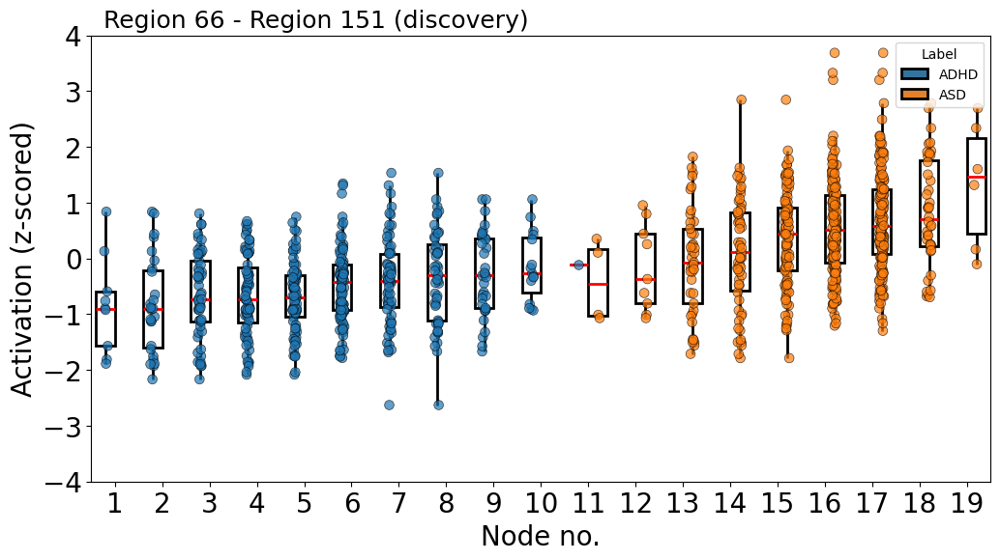

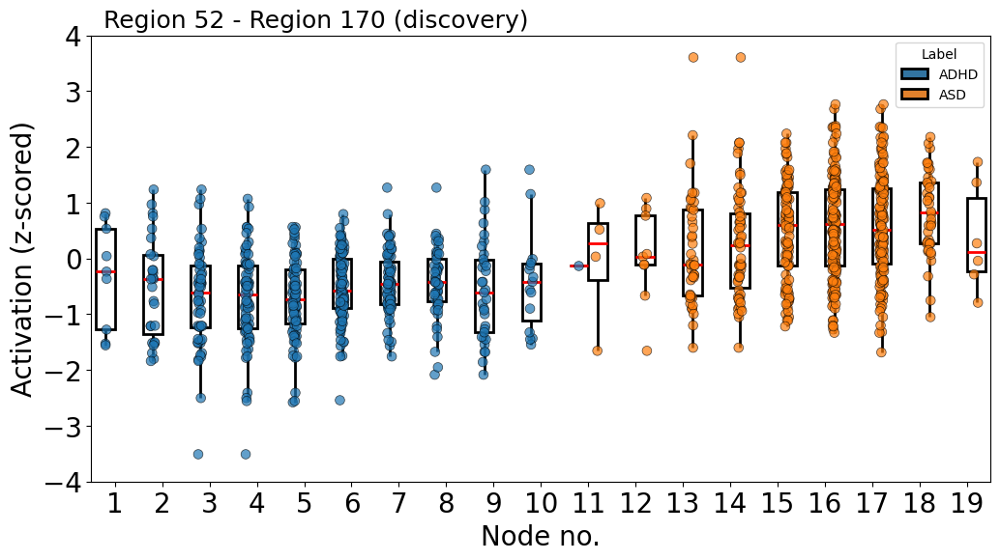

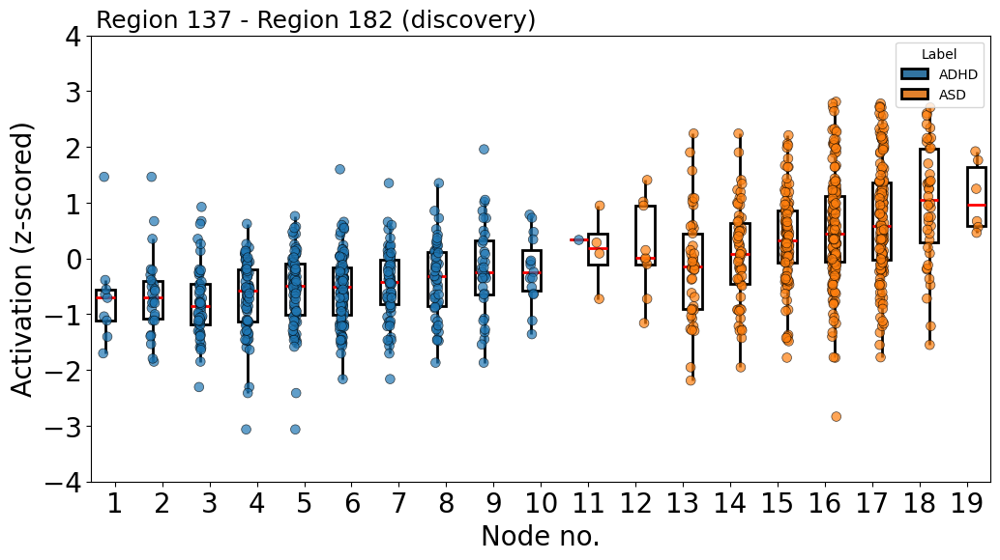

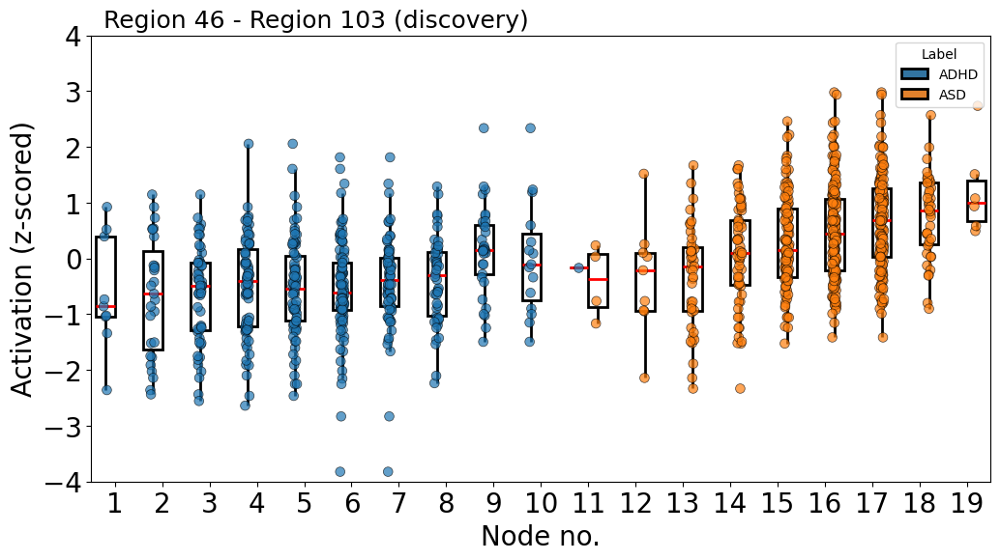

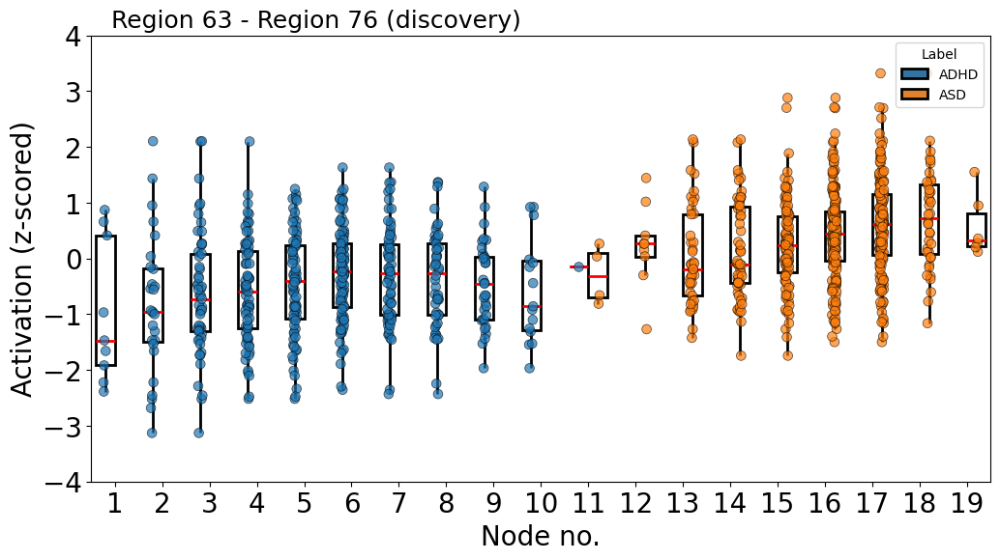

...

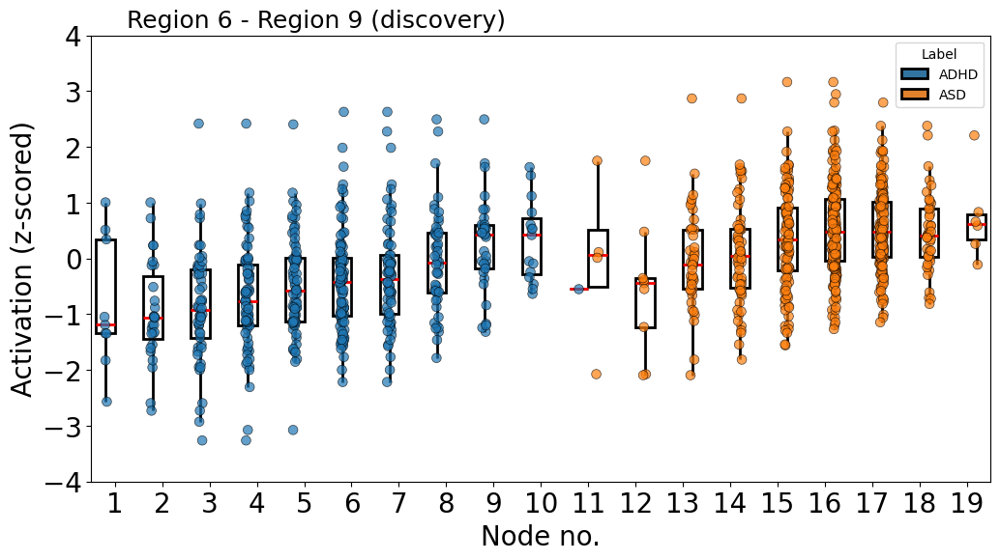

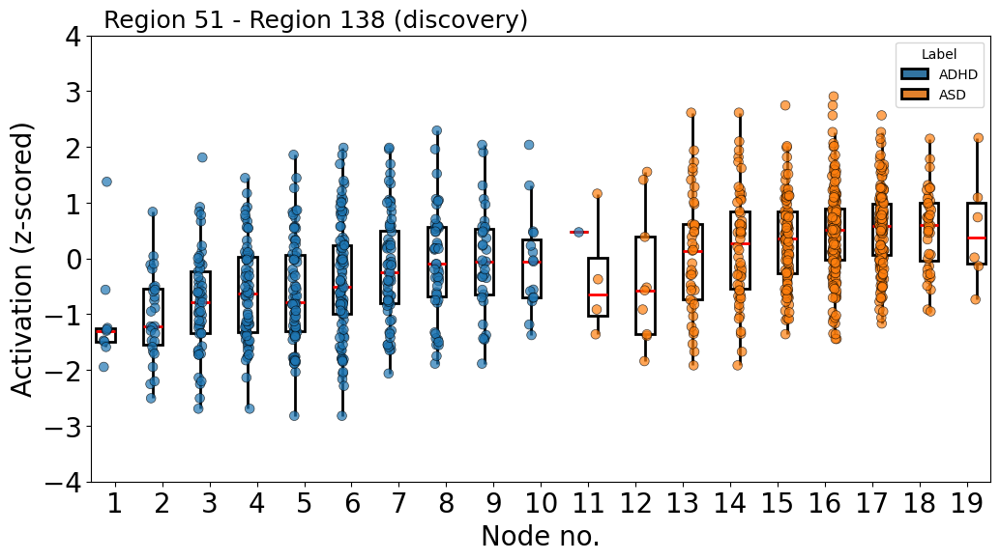

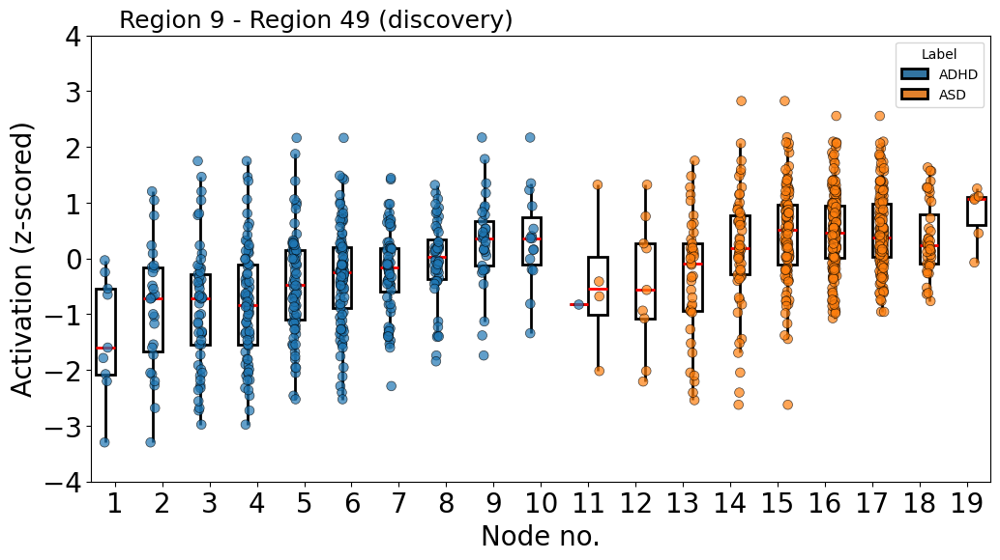

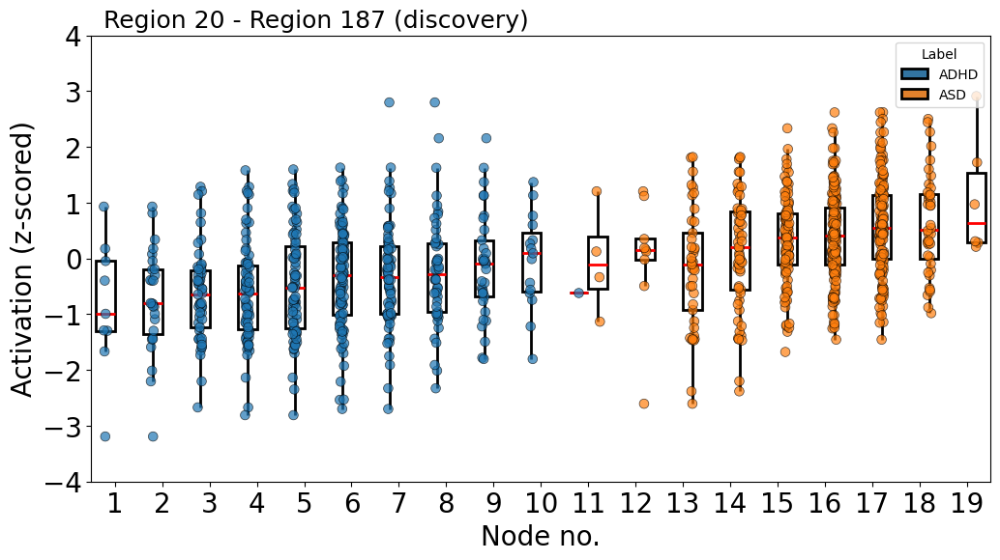

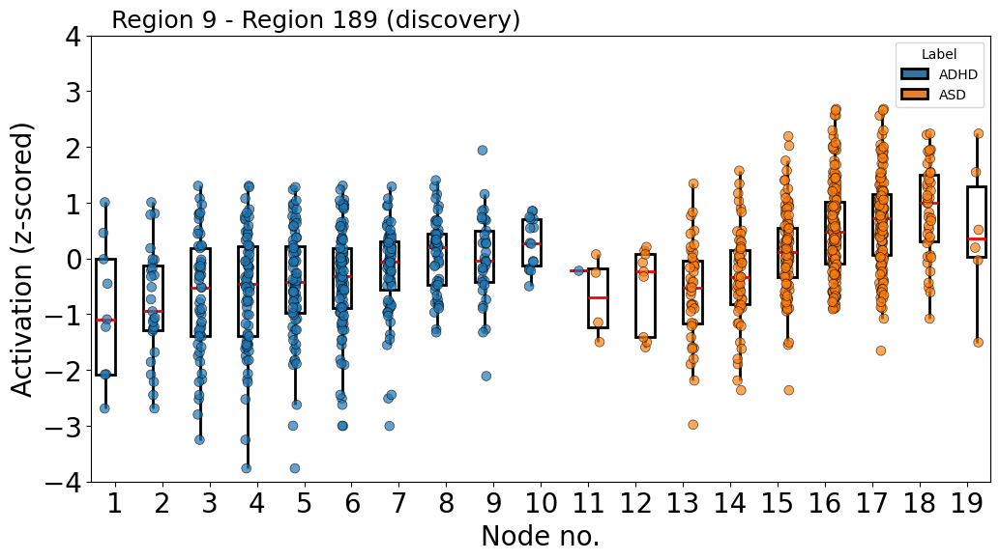

In [ ]:
for n, feature in enumerate(first_pattern.keys()):
  if(n < 11):
    regions = feature_to_regions(feature, map_df)
    title = f"Region {regions[0]} - Region {regions[1]} (discovery)"
    fig, ax = multinodes_paired_boxplot(discovery_df, feature, [i for i in range(1,20)], title)
    file_name = f"region_{regions[0]}-{regions[1]}_discovery.png"
    fig.savefig(f"{SOURCE_DIR}/plots/{file_name}", dpi=300, bbox_inches='tight')

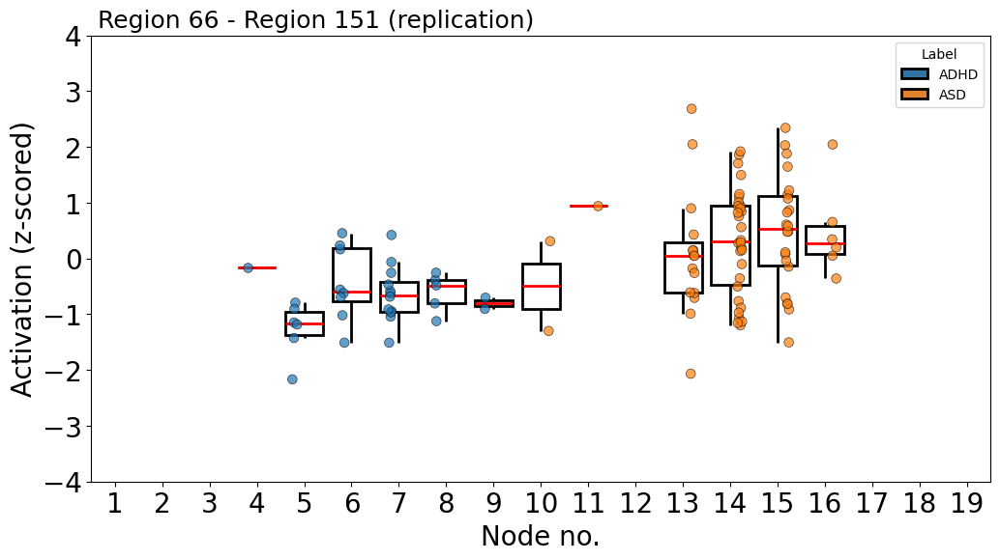

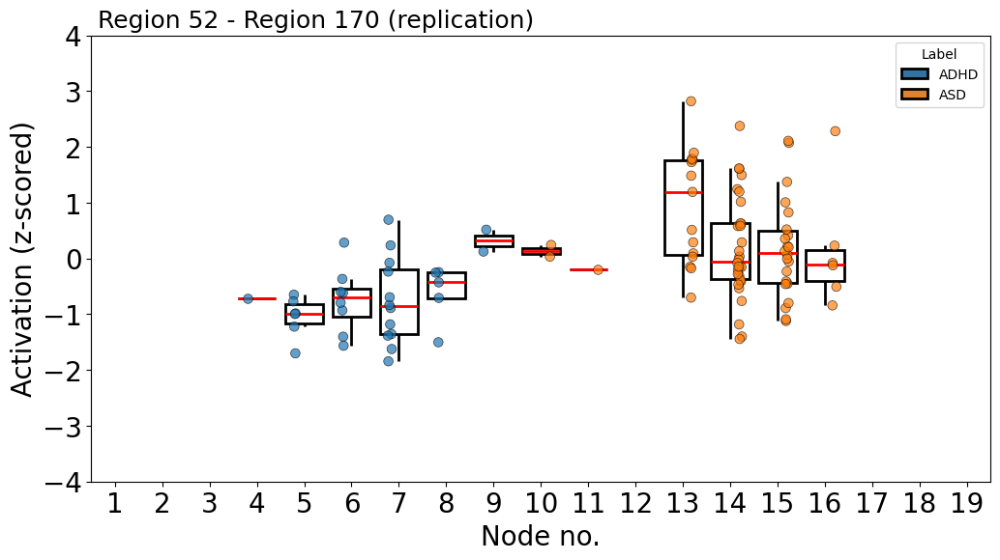

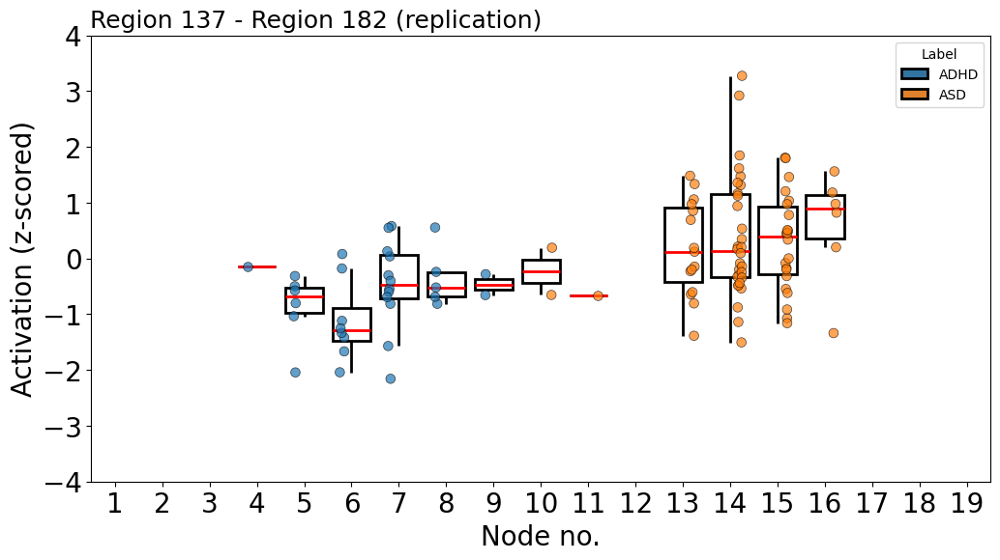

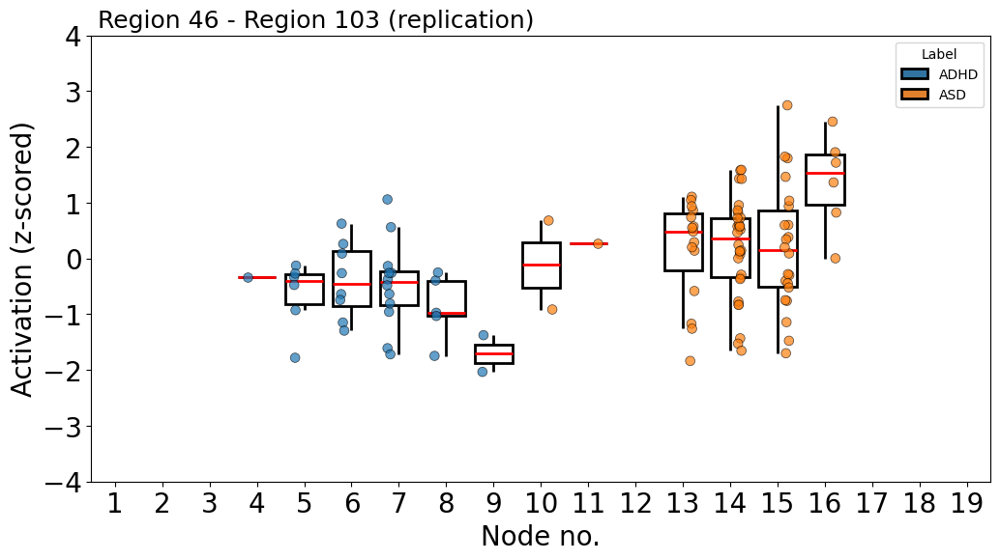

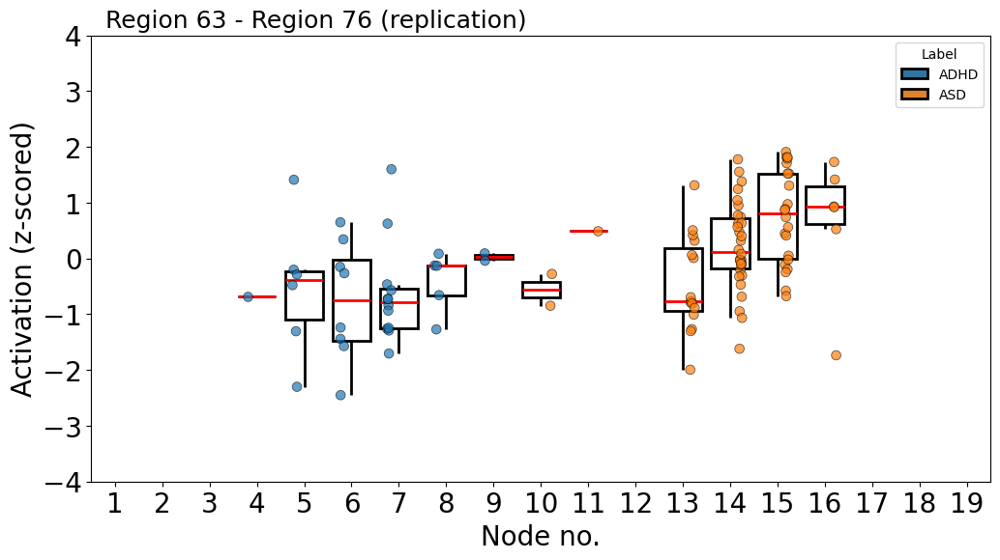

...

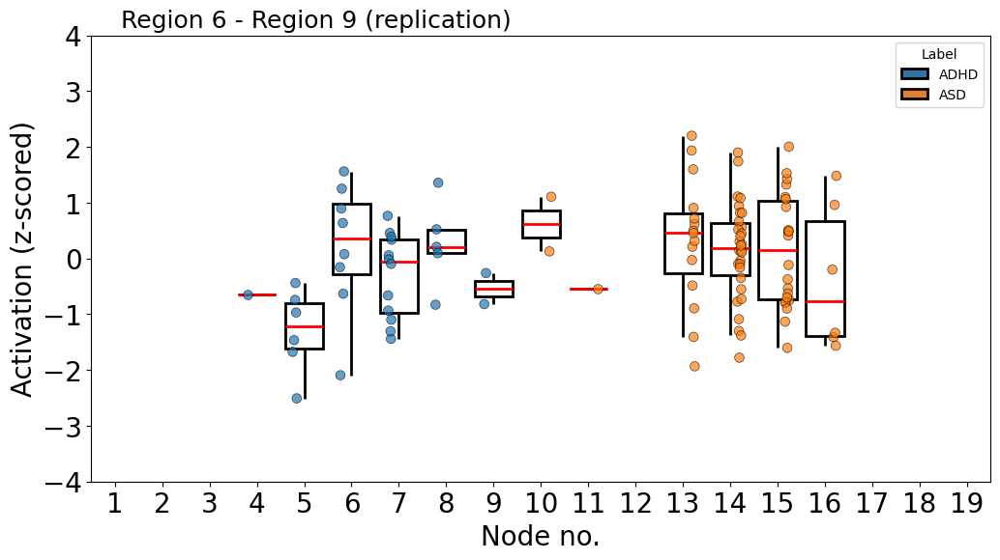

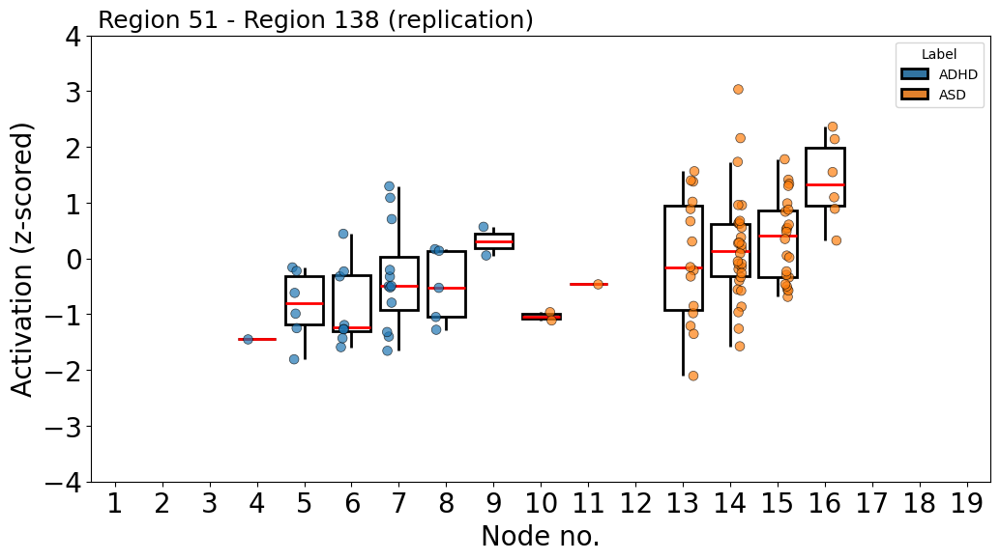

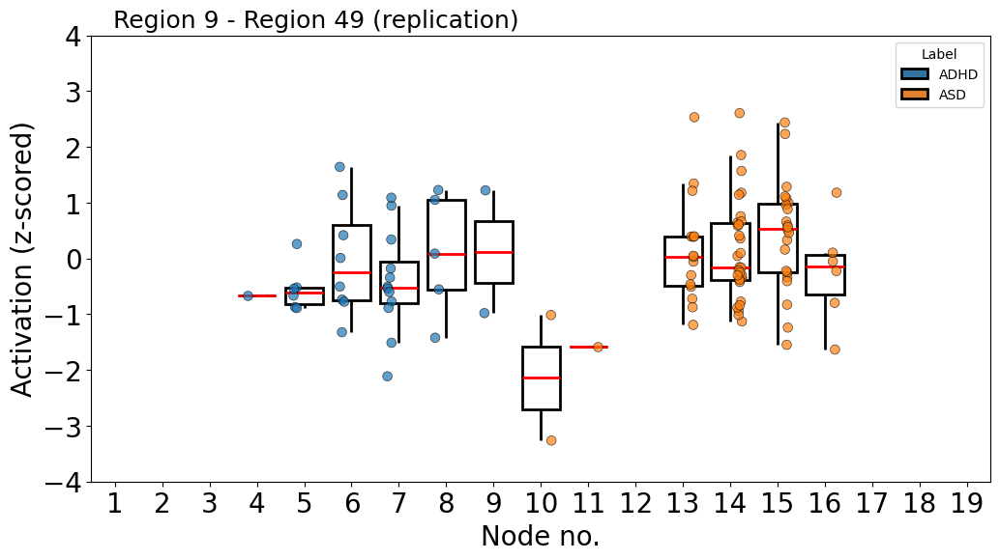

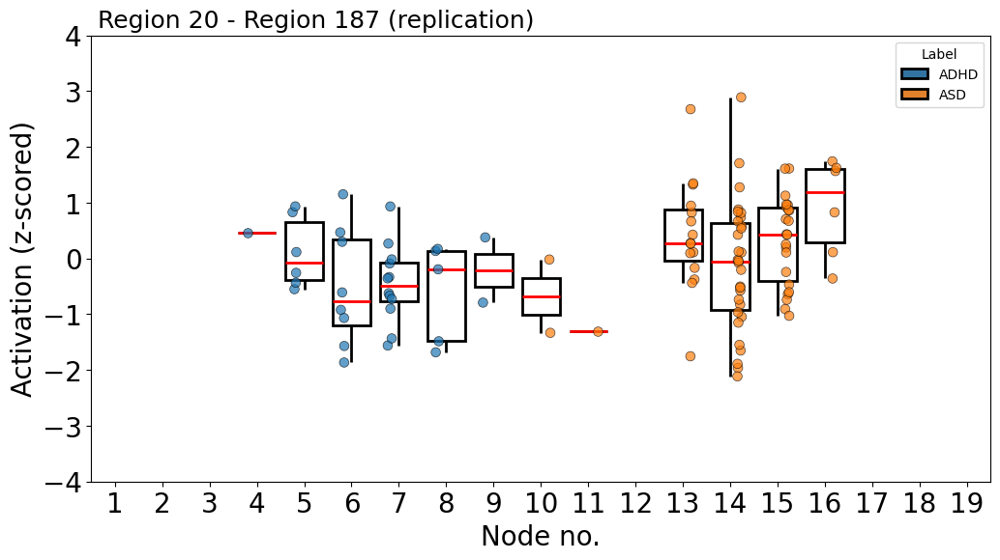

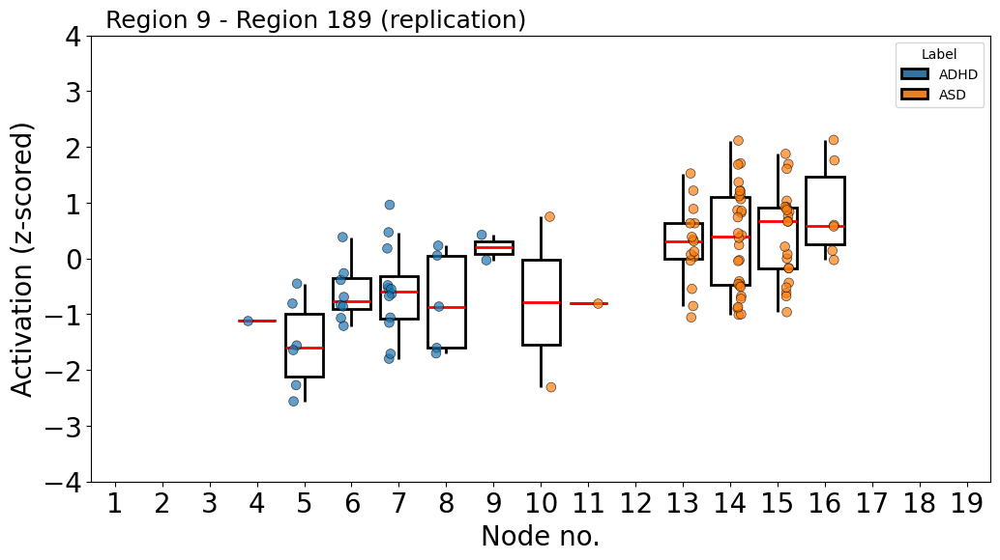

In [ ]:
for n, feature in enumerate(first_pattern.keys()):
  if(n < 11):
    regions = feature_to_regions(feature, map_df)
    title = f"Region {regions[0]} - Region {regions[1]} (replication)"
    fig, ax = multinodes_paired_boxplot_validation(replication_df, feature, [i for i in range(1,20)], title)
    file_name = f"region_{regions[0]}-{regions[1]}_replication.png"
    fig.savefig(f"{SOURCE_DIR}/plots/{file_name}", dpi=300, bbox_inches='tight')

### Second Pattern

In [ ]:
for n, feature in enumerate(second_pattern.keys()):
  if(n<11):
    print(feature_to_regions(feature, map_df))

(44, 102)
(102, 103)
(19, 66)
(103, 187)
(103, 114)
(66, 102)
(54, 159)
(148, 159)
(45, 186)
(122, 162)
(86, 122)


In [ ]:
stability_dict = stability_of_mapper_features(discovery_df, replication_df, list(second_pattern.keys())[:5])
avg_stability = average_stability(discovery_df, replication_df, list(second_pattern.keys()))

print("First 5 features:", stability_dict)
print(avg_stability)

stability_of_mapper_features - Progress: 100/395
stability_of_mapper_features - Progress: 200/395
stability_of_mapper_features - Progress: 300/395
First 5 features: {7281: 0.6666666666666666, 14039: 0.5, 3295: 0.6666666666666666, 14210: 0.5833333333333334, 14137: 0.3333333333333333}
0.7976793248945152


In [ ]:
for n, feature in enumerate(second_pattern.keys()):
  if(n<11):
    print(feature_to_regions(feature, map_df))
    t_stat, p_val = calculate_p_value_feature_between_two_pure_nodes(discovery_df, feature, [1,2,3,4,5,6,7,8,9,10], [11,12,13,14,15,16,17,18,19])
    print(t_stat, p_val)

(44, 102)
-26.410244595594826 3.420921400878236e-104
(102, 103)
-26.72736472237322 6.335191078032647e-106
(19, 66)
-24.00636853456894 4.817873986684006e-91
(103, 187)
-23.480005236429626 3.620102398736904e-88
(103, 114)
-21.398214280732063 7.517055199081244e-77
(66, 102)
-22.46918819819171 1.1702989698951439e-82
(54, 159)
-20.63316892541043 9.952631924159854e-73
(148, 159)
-20.161042589638846 3.3690059747708984e-70
(45, 186)
-18.73341839201523 1.2396000382565657e-62
(122, 162)
-19.037032049808968 3.1341360499598566e-64
(86, 122)
-18.91149569160914 1.4366607831433963e-63


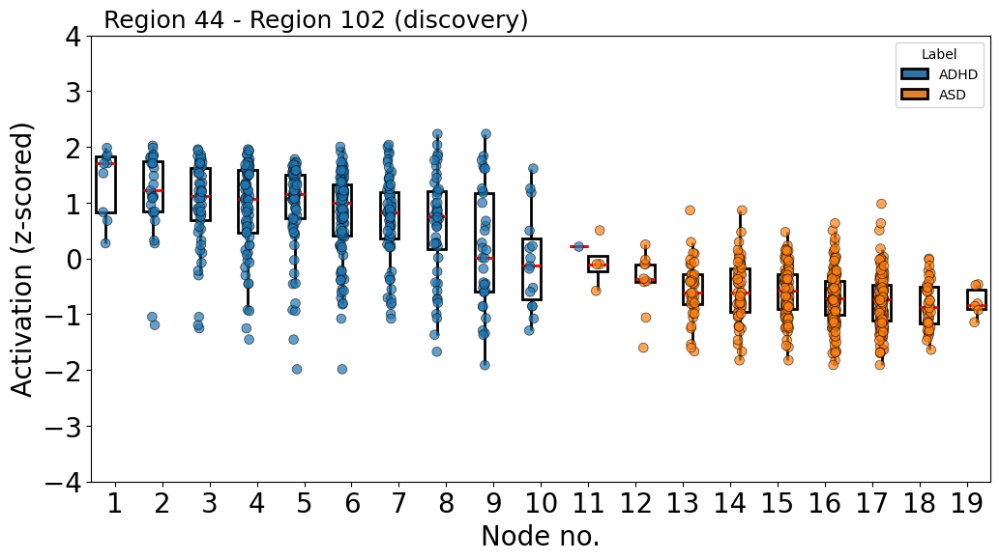

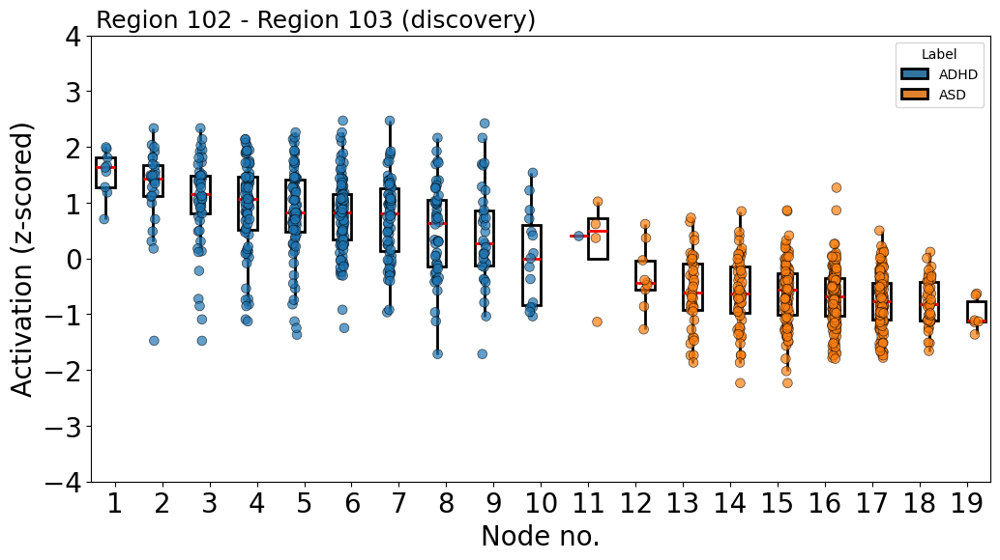

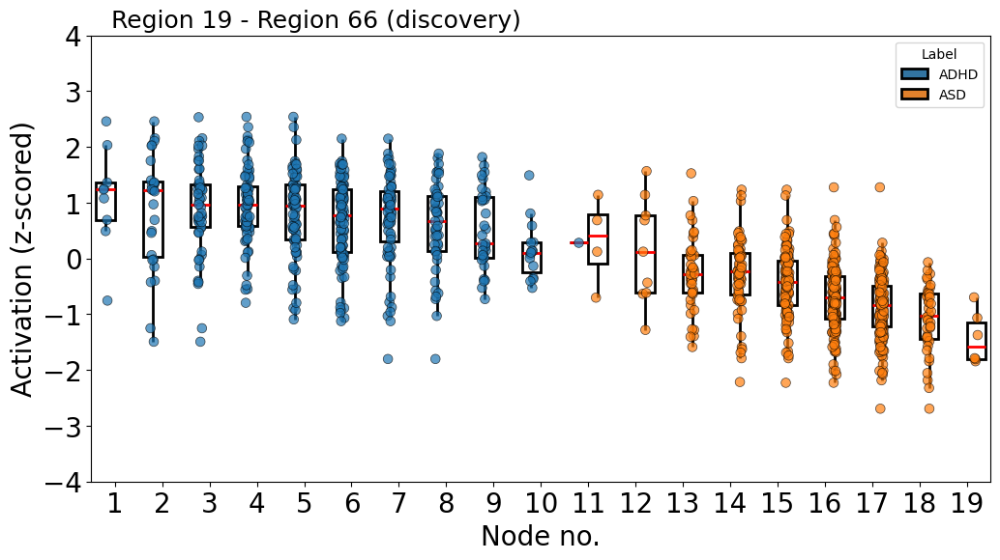

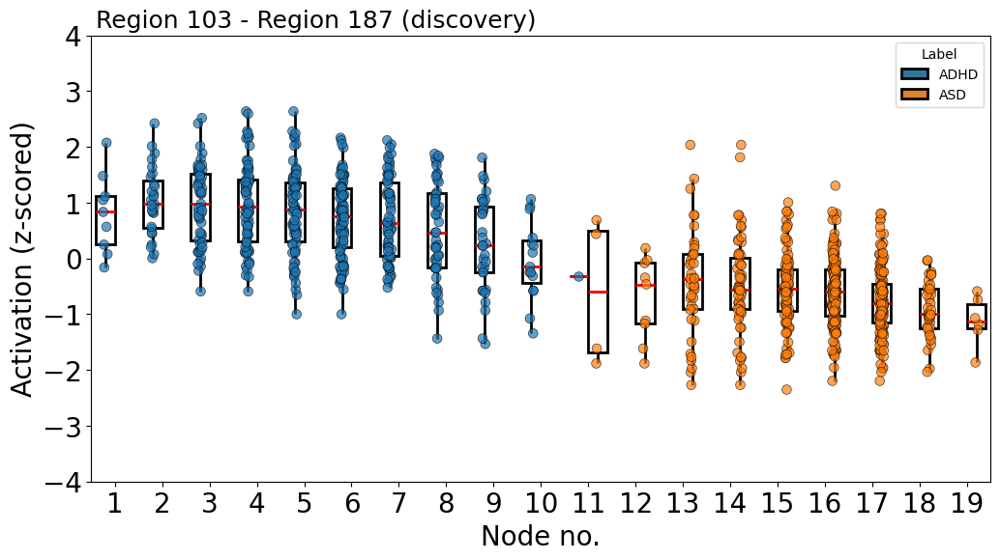

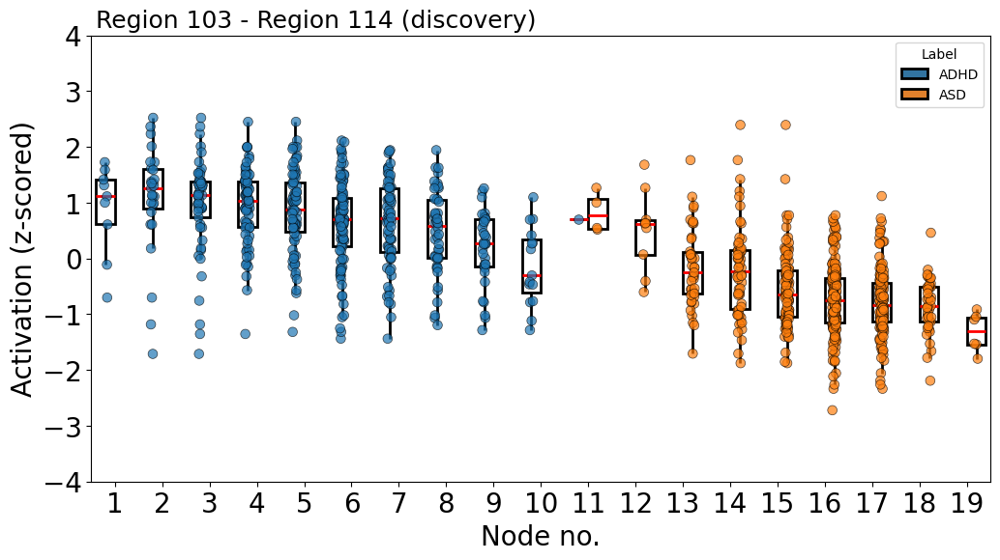

...

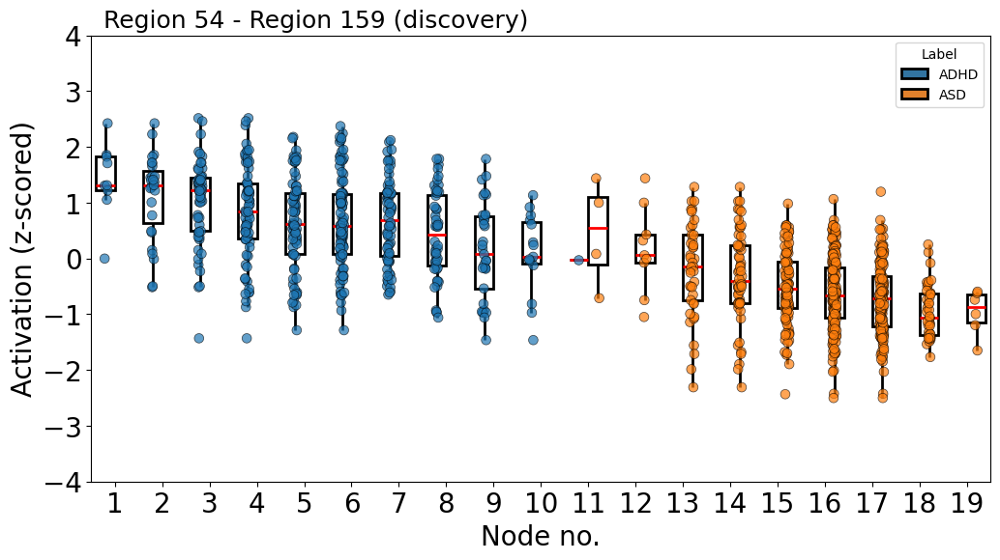

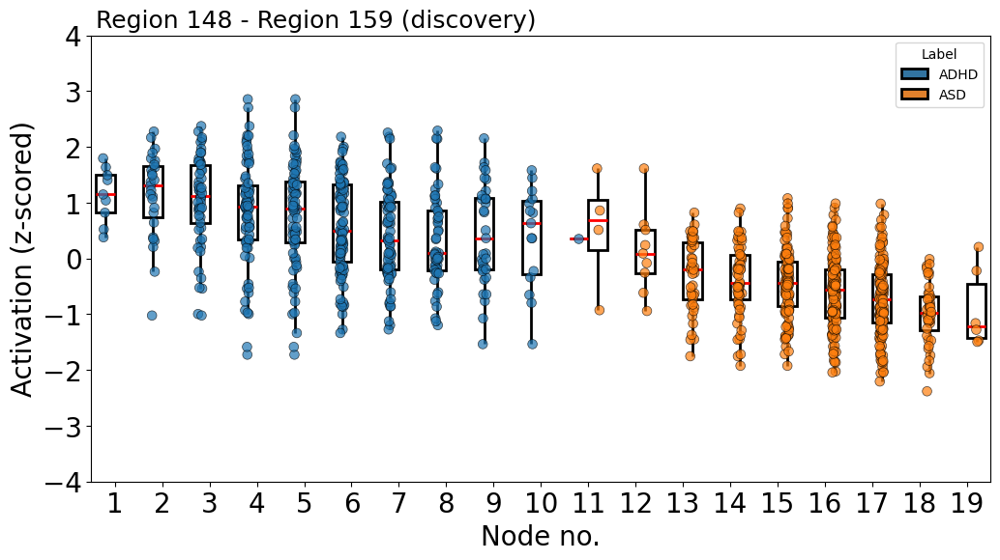

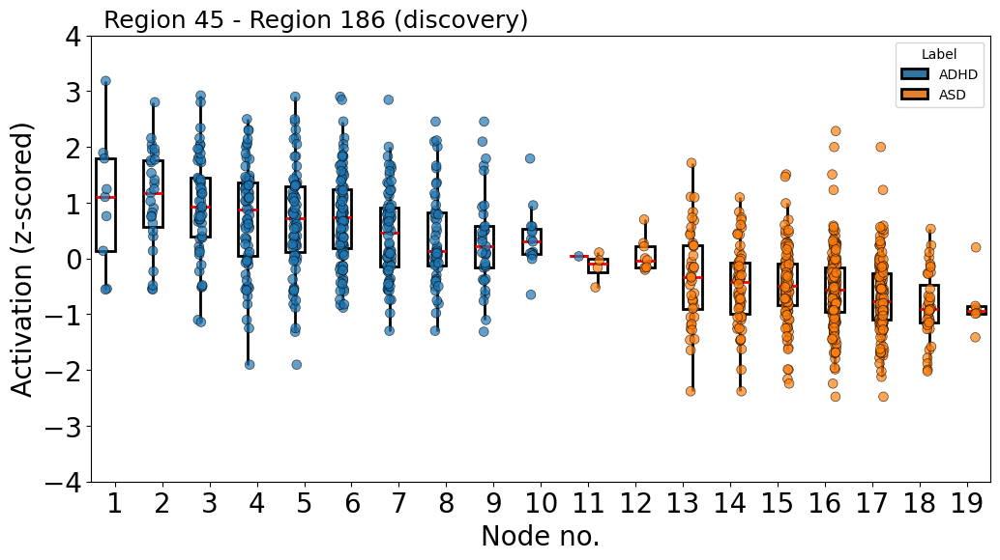

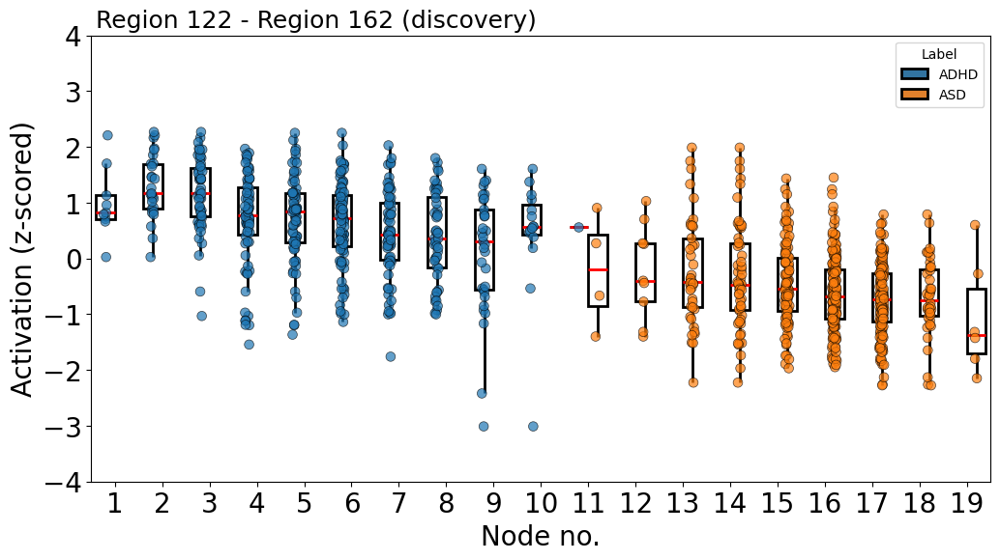

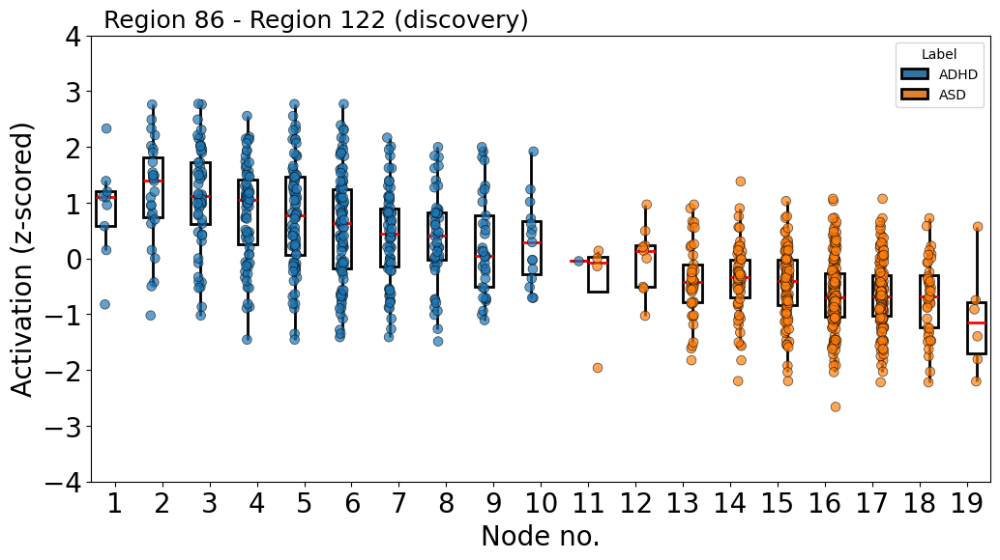

In [ ]:
for n, feature in enumerate(second_pattern.keys()):
  if(n < 11):
    regions = feature_to_regions(feature, map_df)
    title = f"Region {regions[0]} - Region {regions[1]} (discovery)"
    fig, ax = multinodes_paired_boxplot(discovery_df, feature, [i for i in range(1,20)], title)
    file_name = f"region_{regions[0]}-{regions[1]}_discovery.png"
    fig.savefig(f"{SOURCE_DIR}/plots/{file_name}", dpi=300, bbox_inches='tight')

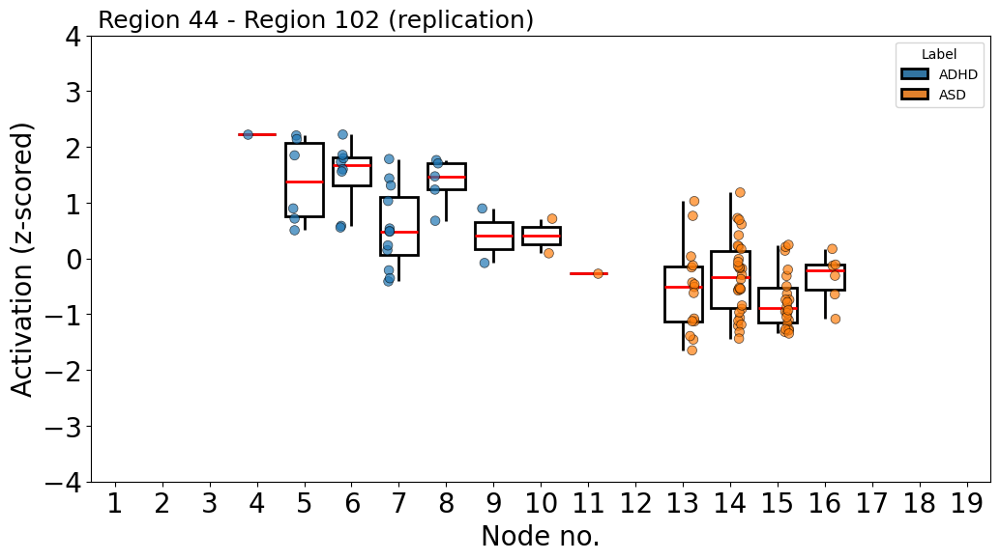

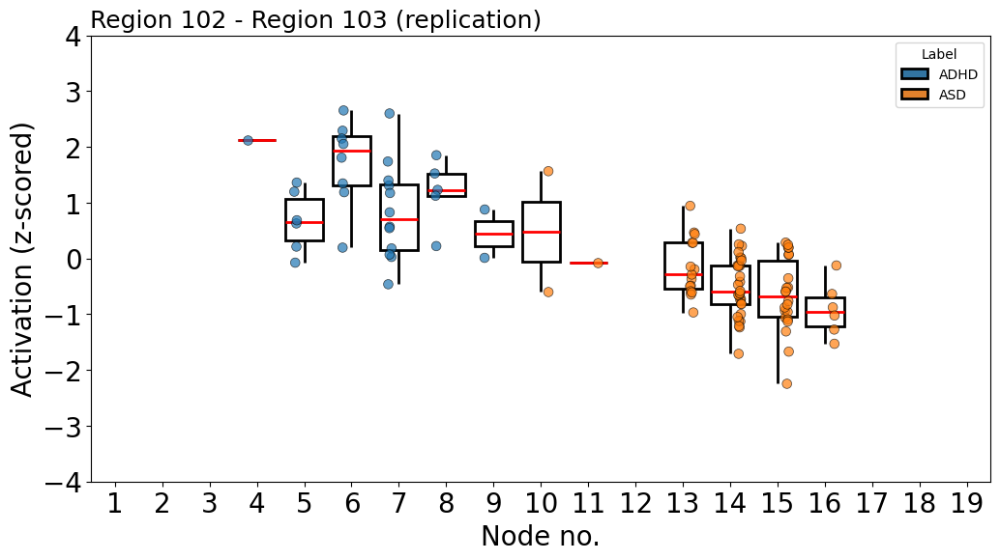

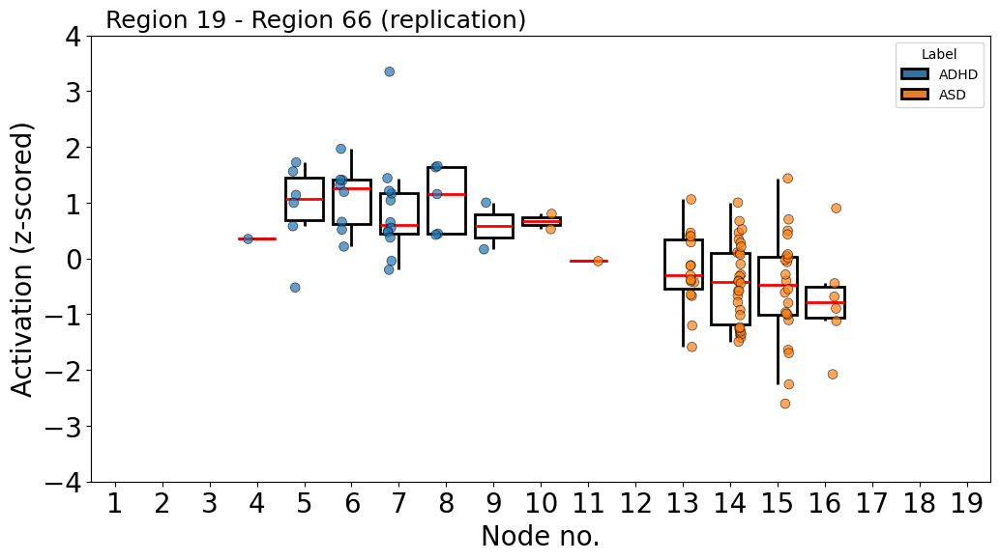

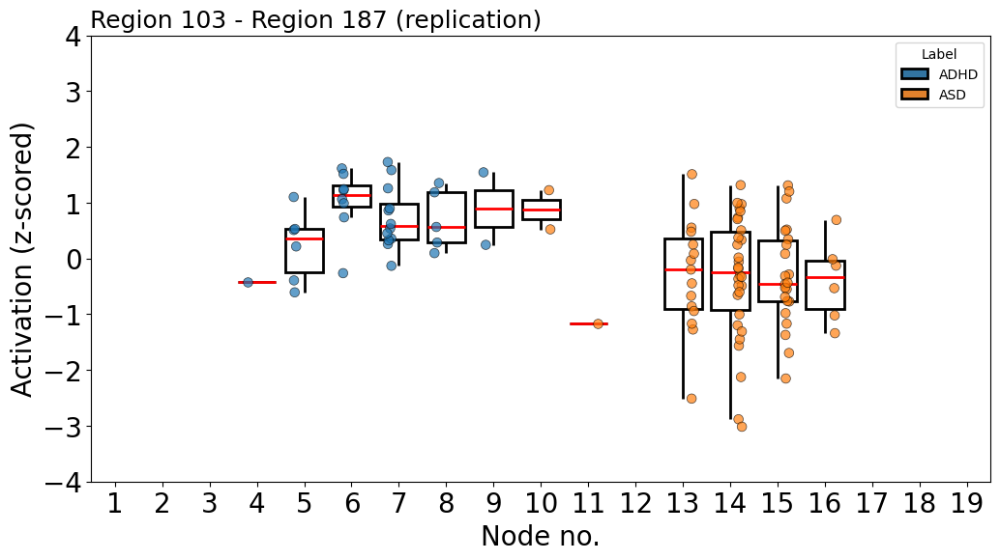

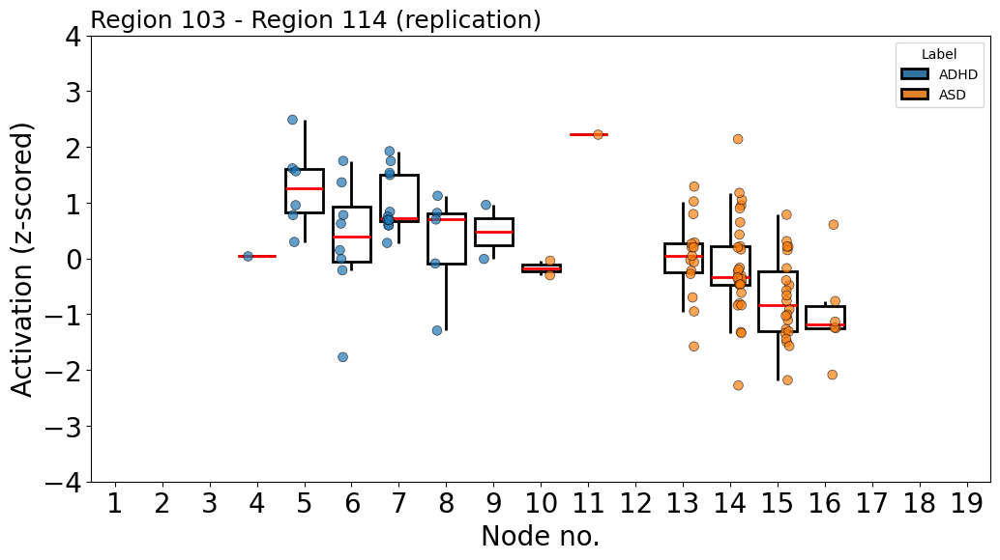

...

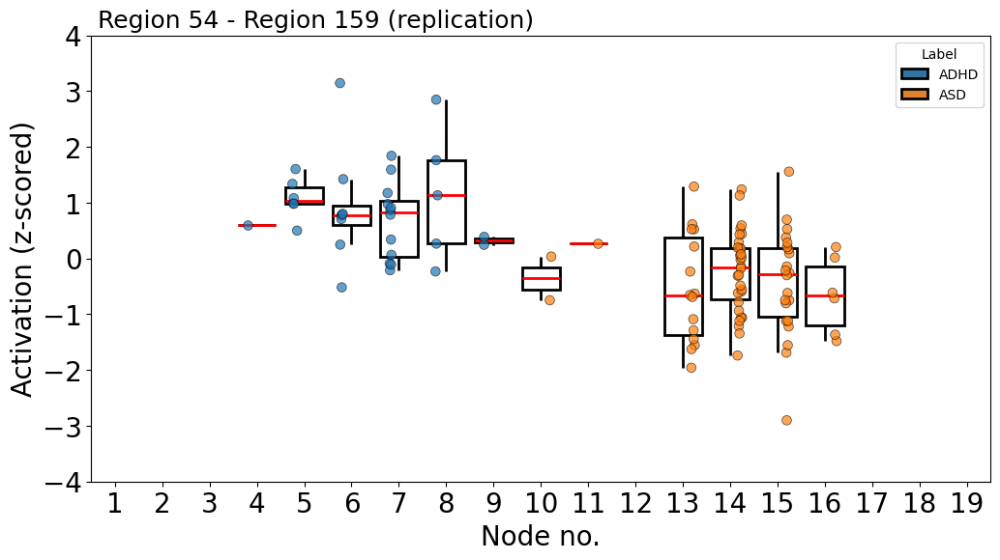

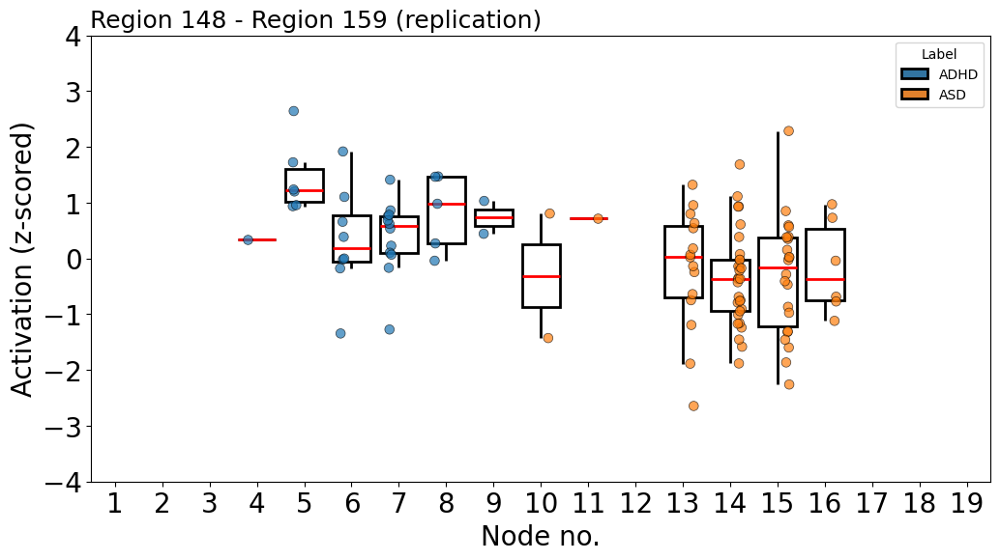

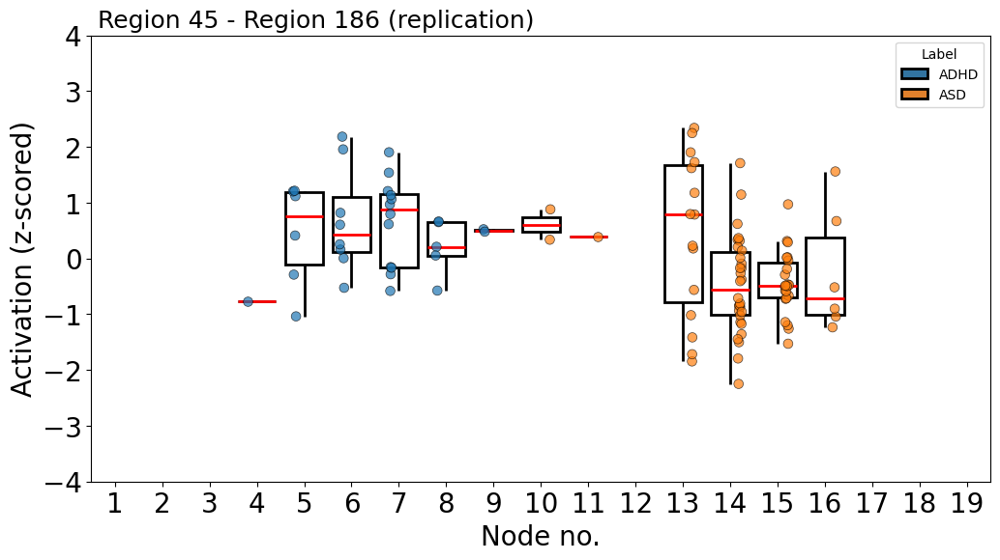

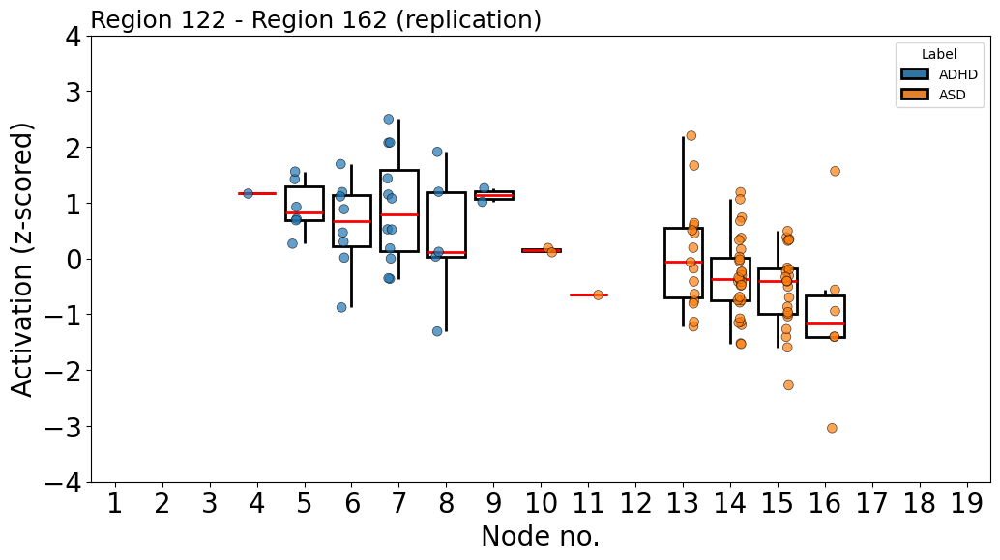

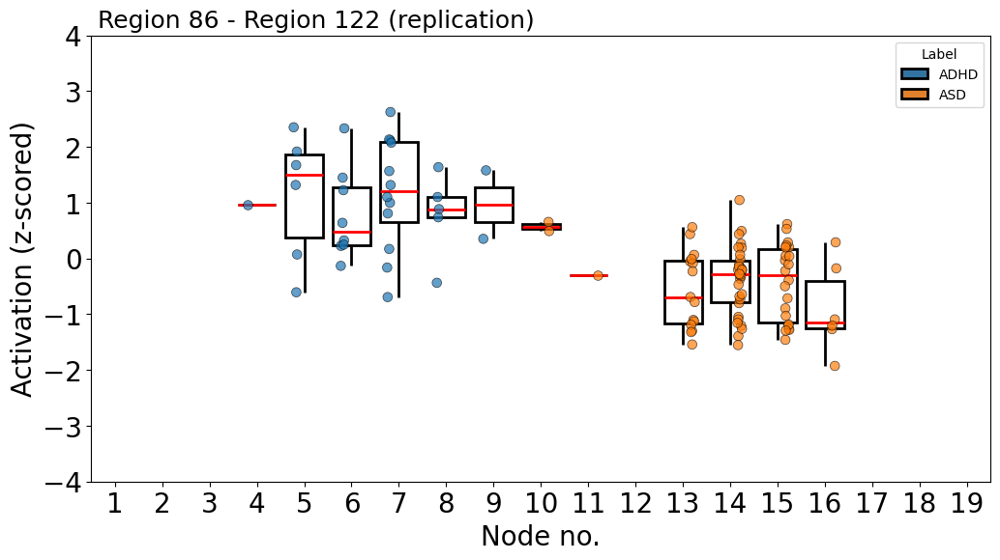

In [ ]:
for n, feature in enumerate(second_pattern.keys()):
  if(n < 11):
    regions = feature_to_regions(feature, map_df)
    title = f"Region {regions[0]} - Region {regions[1]} (replication)"
    fig, ax = multinodes_paired_boxplot_validation(replication_df, feature, [i for i in range(1,20)], title)
    file_name = f"region_{regions[0]}-{regions[1]}_replication.png"
    fig.savefig(f"{SOURCE_DIR}/plots/{file_name}", dpi=300, bbox_inches='tight')

### Third Pattern

In [ ]:
for n, feature in enumerate(third_pattern.keys()):
  if(n<11):
    print(feature_to_regions(feature, map_df))

(15, 153)
(82, 127)
(5, 28)
(88, 181)
(48, 53)
(67, 92)
(5, 61)
(28, 176)
(28, 109)
(28, 129)
(109, 167)


In [ ]:
stability_dict = stability_of_mapper_features(discovery_df, replication_df, list(third_pattern.keys())[:5])
avg_stability = average_stability(discovery_df, replication_df, list(third_pattern.keys()))

print("First 5 features:", stability_dict)
print(avg_stability)

First 5 features: {2692: 0.5833333333333334, 12113: 0.75, 772: 0.6666666666666666, 12794: 0.9166666666666666, 7806: 0.8333333333333334}
0.7755555555555552


In [ ]:
for n, feature in enumerate(third_pattern.keys()):
  if(n<11):
    print(feature_to_regions(feature, map_df))
    t_stat, p_val = calculate_p_value_feature_between_two_pure_nodes(discovery_df, feature, [1,2,3,4,5,6,7,8,9,10], [11,12,13,14,15,16,17,18,19])
    print(t_stat, p_val)

(15, 153)
8.06626799511666 3.641004811397804e-15
(82, 127)
-0.783045319758005 0.4338933543680169
(5, 28)
-8.796198638668441 1.336230298935367e-17
(88, 181)
-4.039156478251807 6.023044446512348e-05
(48, 53)
-2.471911911445753 0.01370114894159533
(67, 92)
-2.623758850963257 0.008906179029497651
(5, 61)
-6.6848459329031105 5.0792831444253684e-11
(28, 176)
-6.801370576235088 2.4028532500617196e-11
(28, 109)
-2.0800097846290155 0.037926398503936386
(28, 129)
-2.2961382199899414 0.021993832156878657
(109, 167)
2.936953571010173 0.003434977195467312


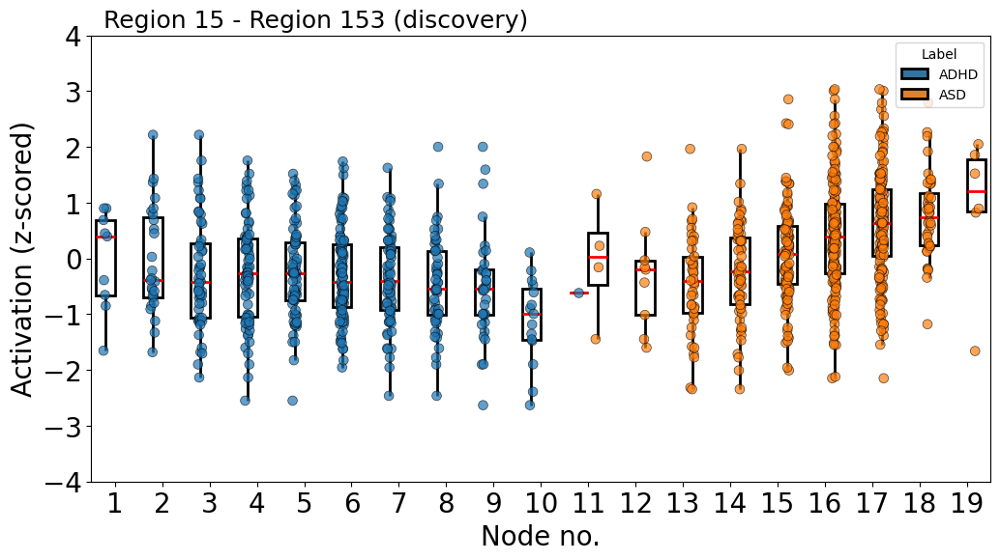

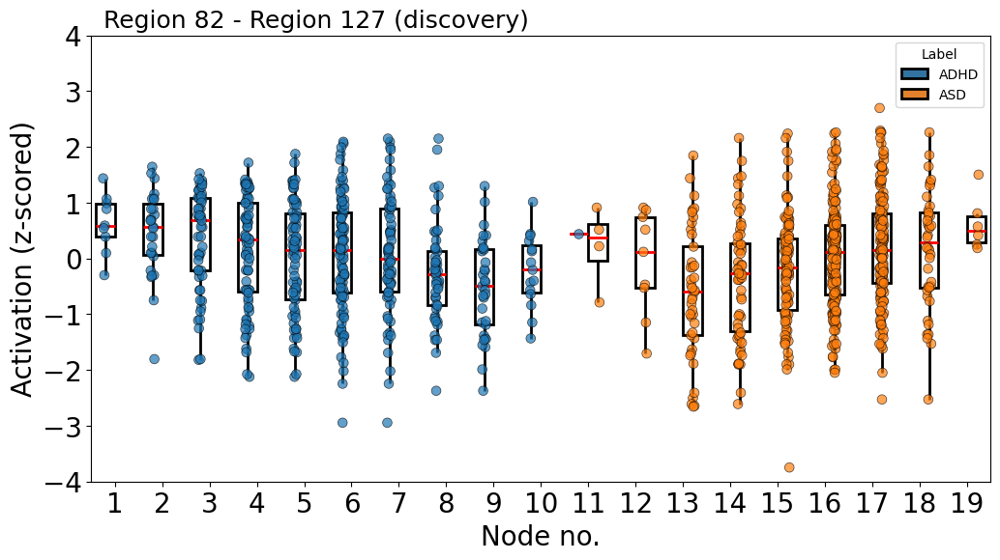

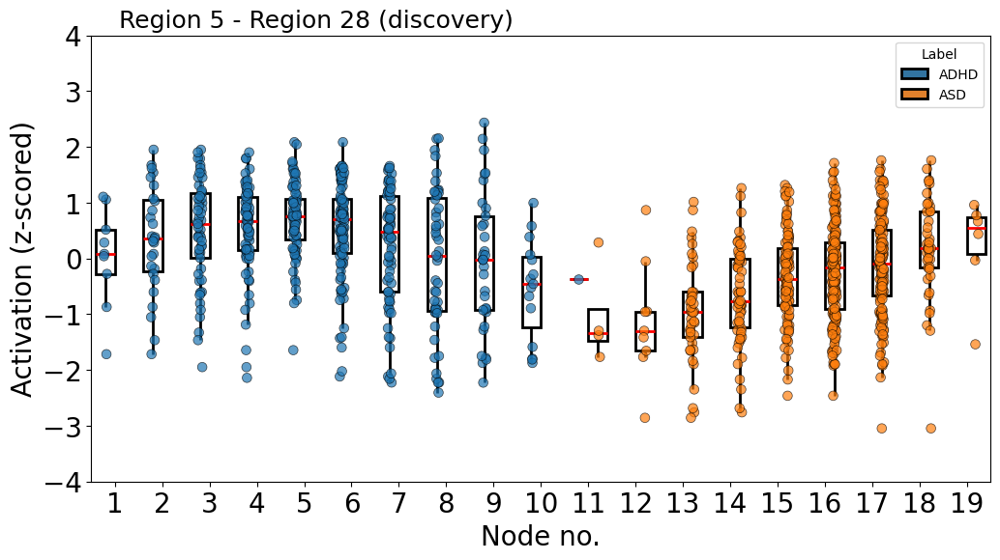

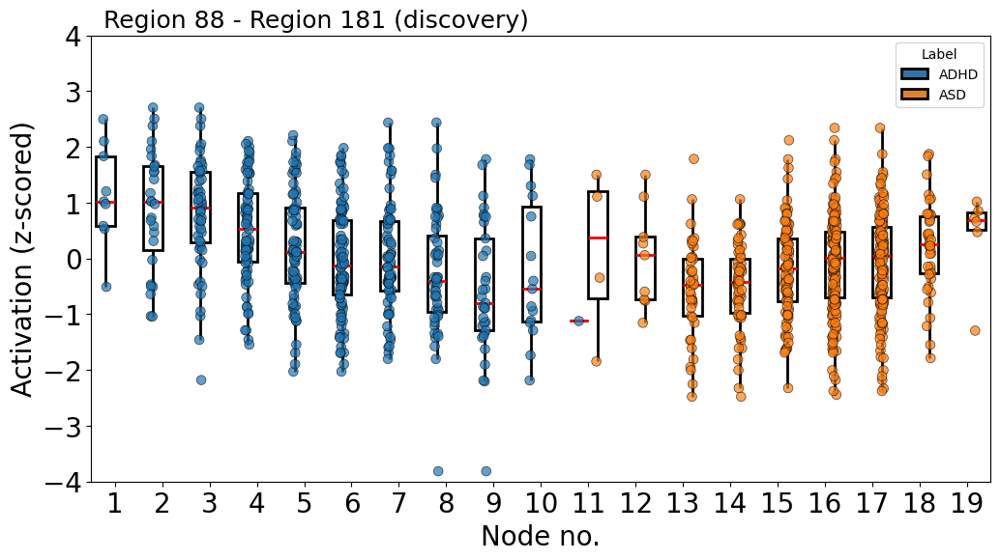

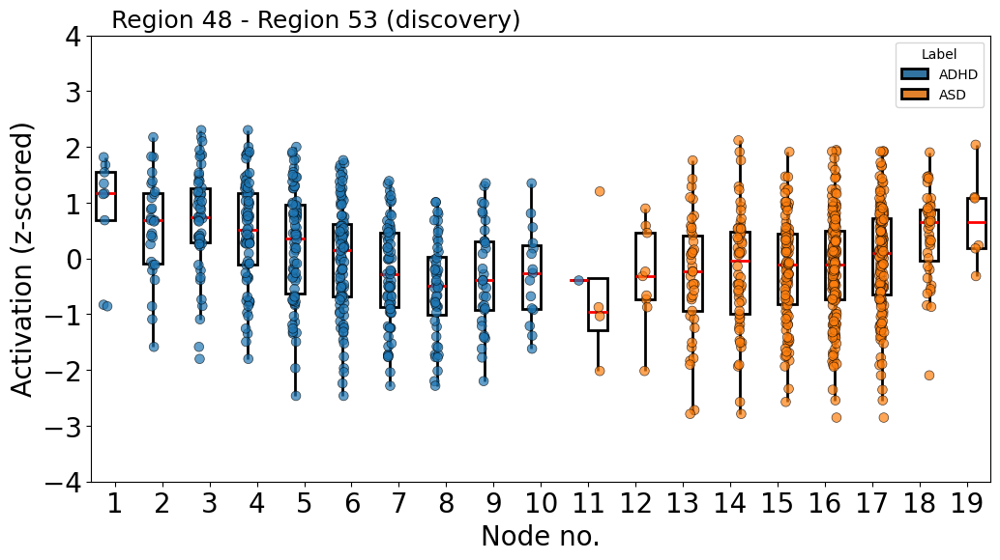

...

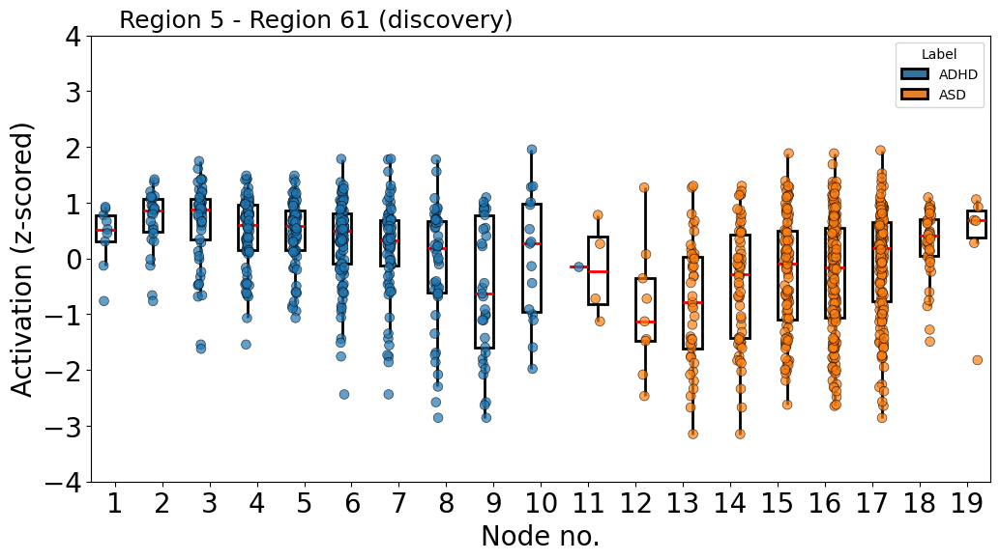

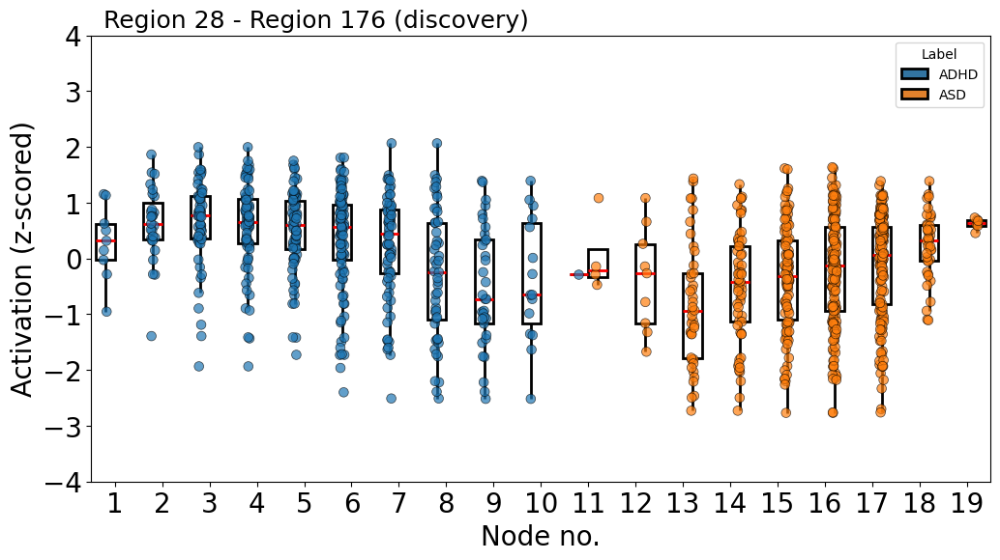

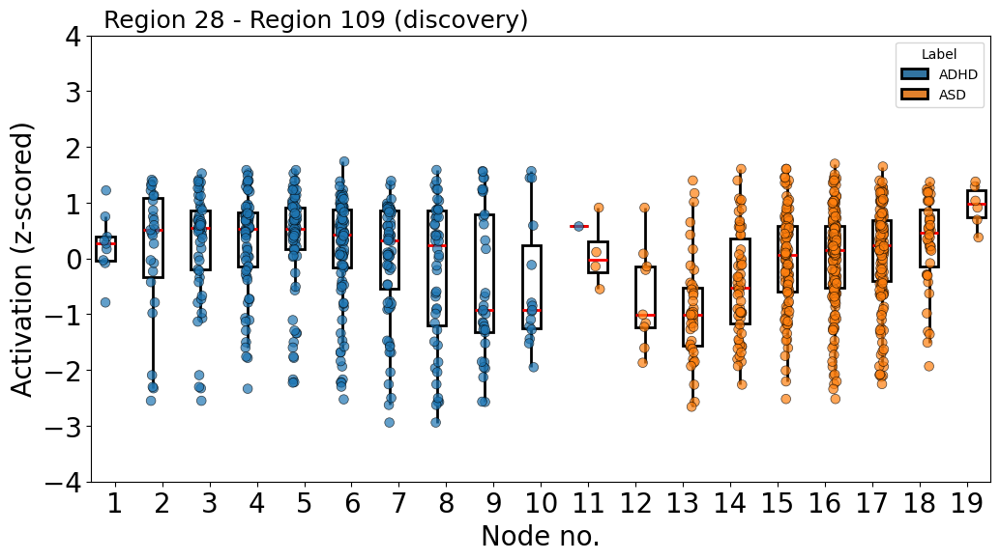

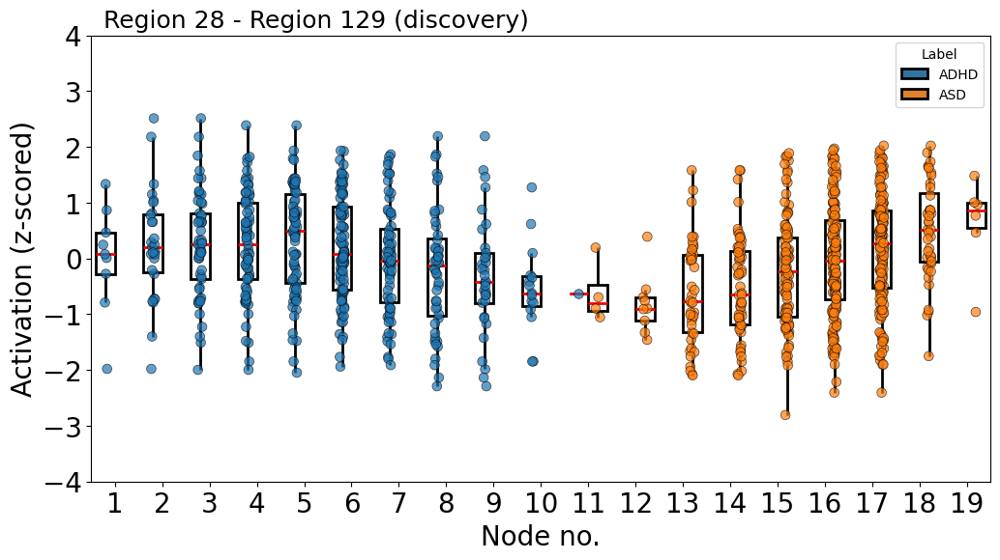

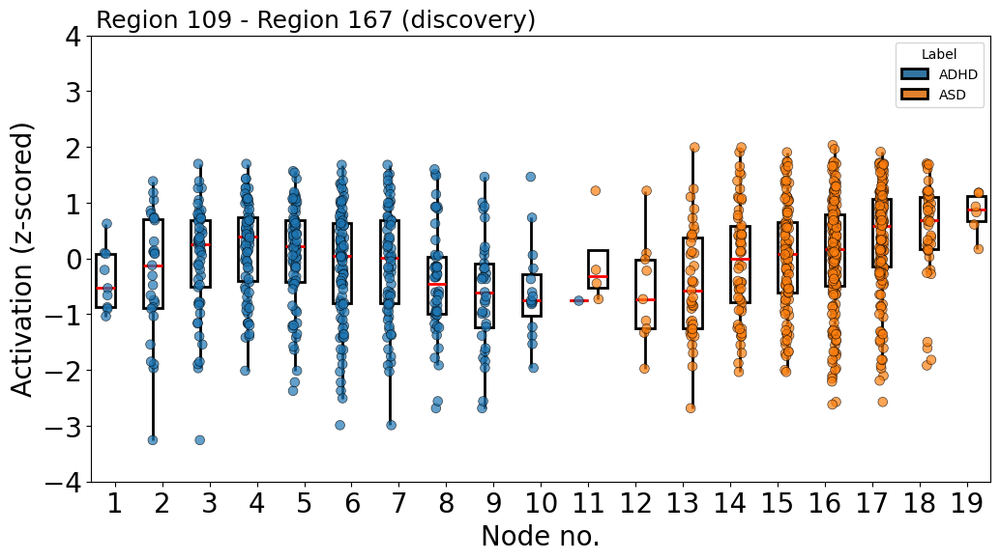

In [ ]:
for n, feature in enumerate(third_pattern.keys()):
  if(n < 11):
    regions = feature_to_regions(feature, map_df)
    title = f"Region {regions[0]} - Region {regions[1]} (discovery)"
    fig, ax = multinodes_paired_boxplot(discovery_df, feature, [i for i in range(1,20)], title)
    file_name = f"region_{regions[0]}-{regions[1]}_discovery.png"
    fig.savefig(f"{SOURCE_DIR}/plots/{file_name}", dpi=300, bbox_inches='tight')

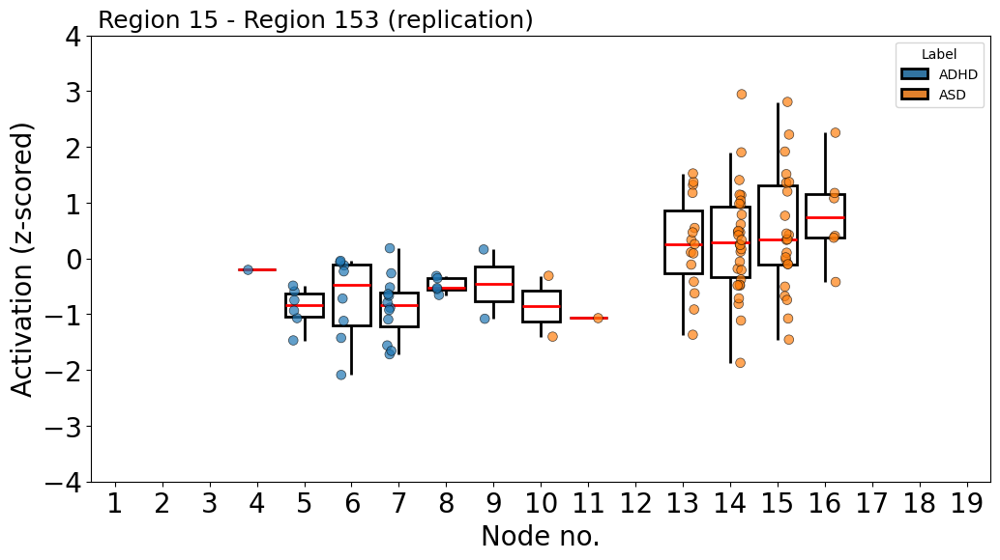

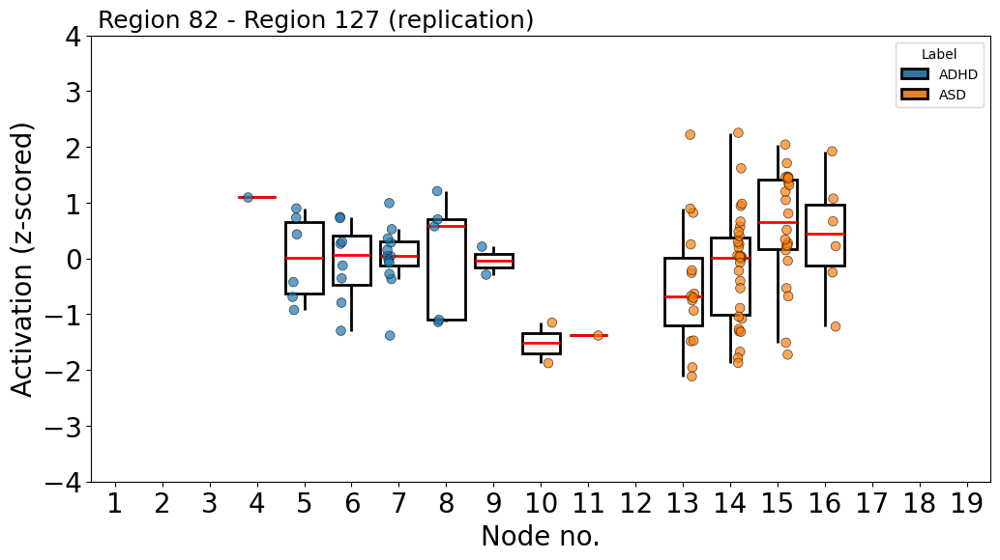

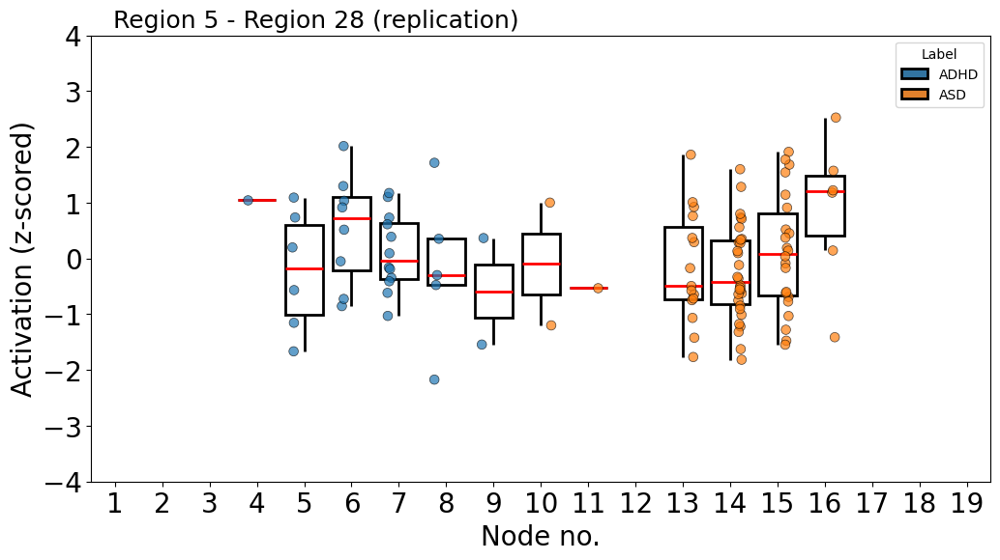

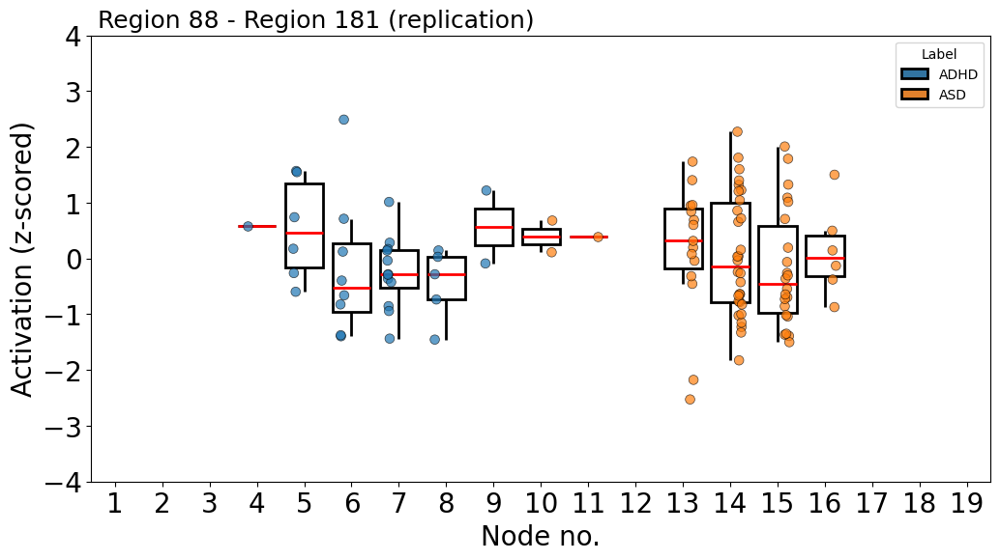

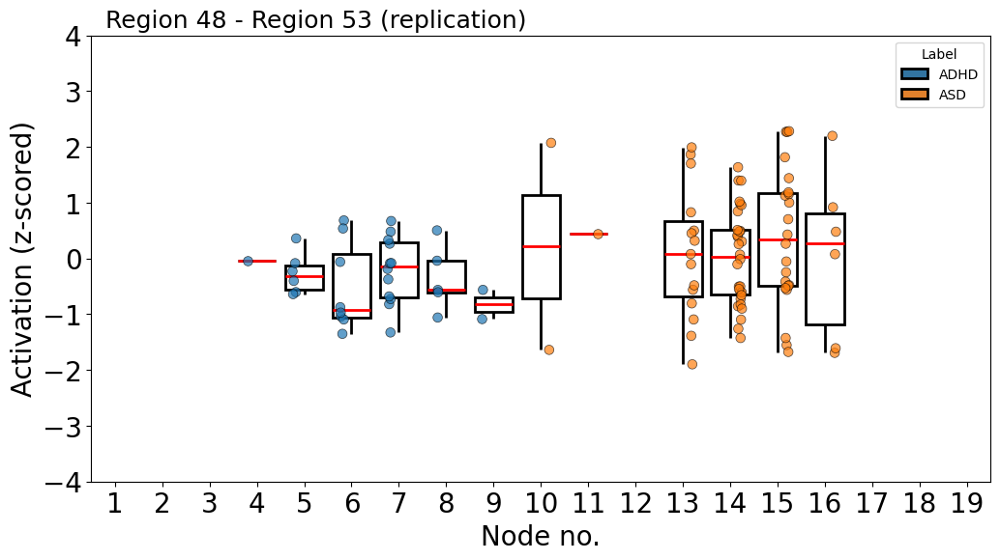

...

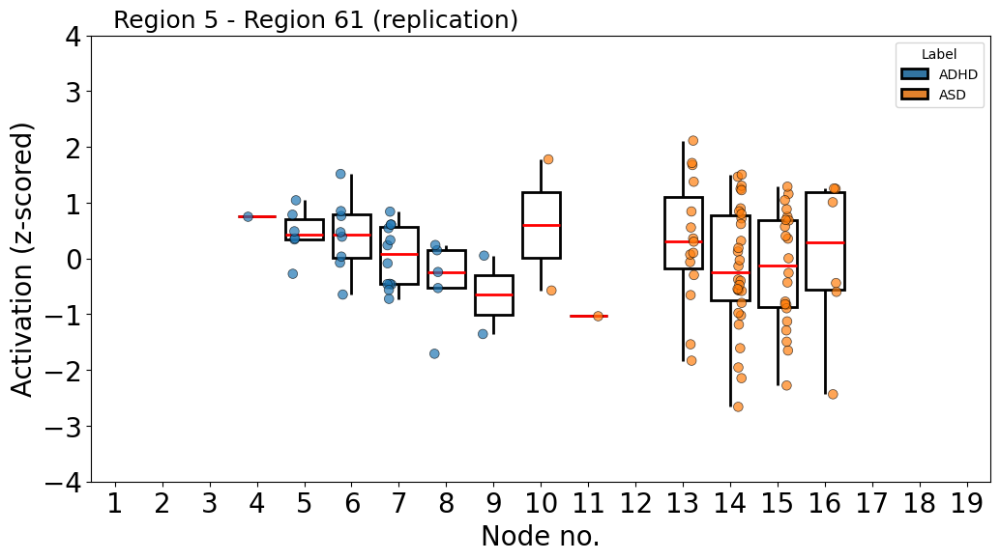

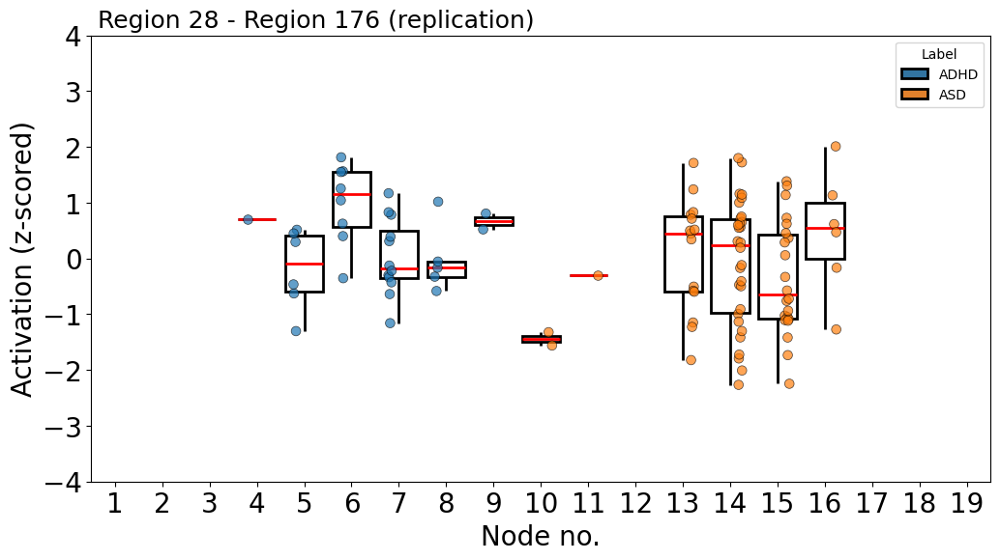

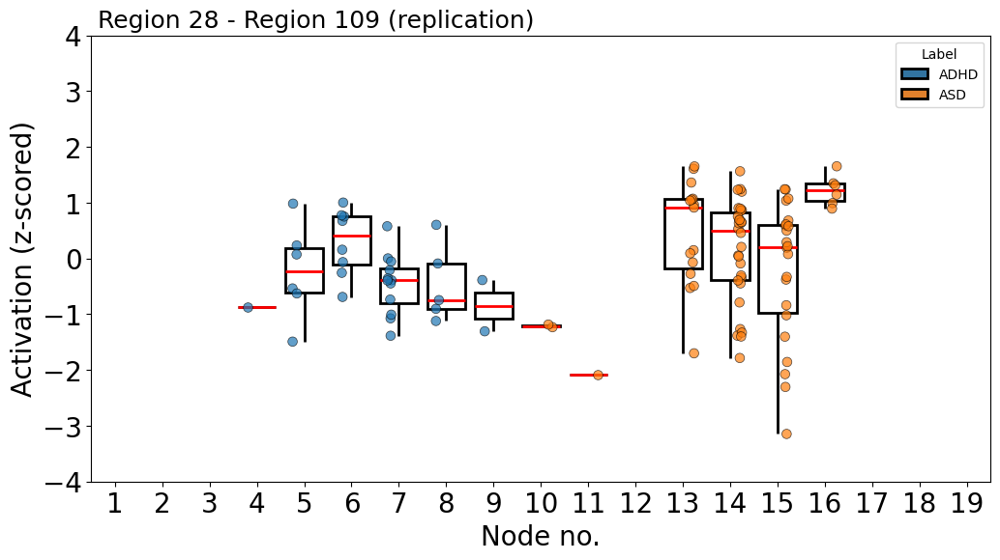

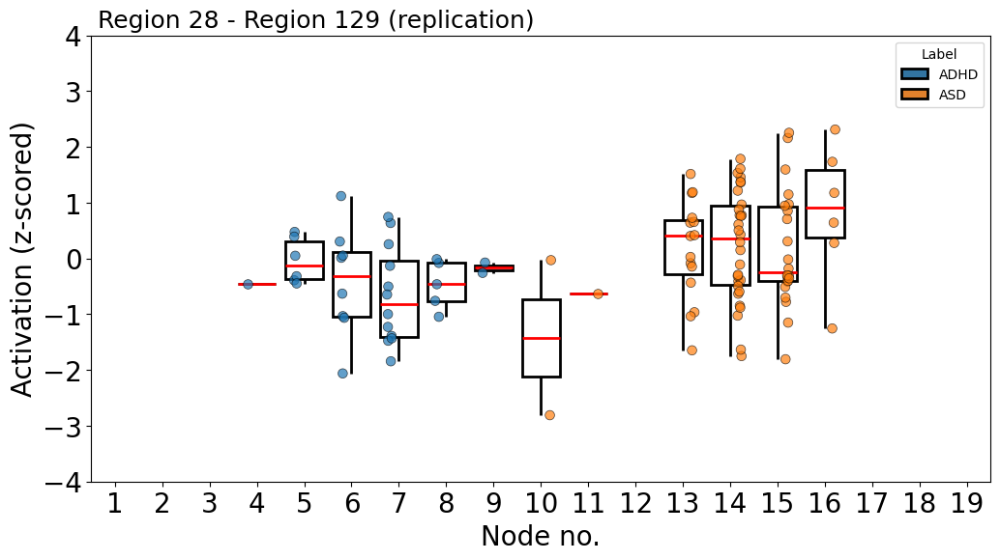

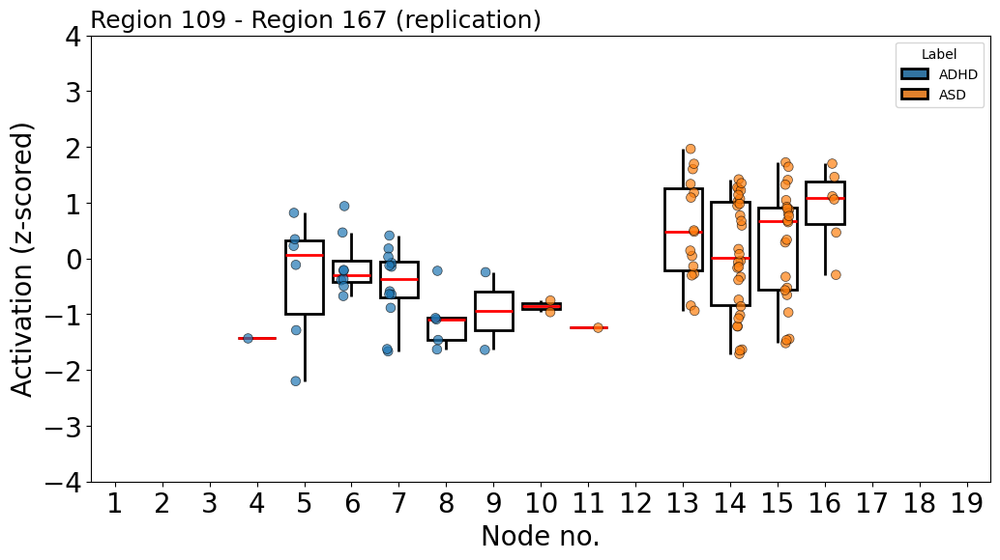

In [ ]:
for n, feature in enumerate(third_pattern.keys()):
  if(n < 11):
    regions = feature_to_regions(feature, map_df)
    title = f"Region {regions[0]} - Region {regions[1]} (replication)"
    fig, ax = multinodes_paired_boxplot_validation(replication_df, feature, [i for i in range(1,20)], title)
    file_name = f"region_{regions[0]}-{regions[1]}_replication.png"
    fig.savefig(f"{SOURCE_DIR}/plots/{file_name}", dpi=300, bbox_inches='tight')

### Fourth Pattern

In [ ]:
for n, feature in enumerate(fourth_pattern.keys()):
  if(n<11):
    print(feature_to_regions(feature, map_df))

(41, 64)
(41, 109)
(41, 101)
(52, 106)
(46, 52)
(28, 41)
(157, 167)
(41, 127)
(5, 97)
(97, 167)
(4, 37)


In [ ]:
len(fourth_pattern)

52

In [ ]:
stability_dict = stability_of_mapper_features(discovery_df, replication_df, list(fourth_pattern.keys())[:5])
avg_stability = average_stability(discovery_df, replication_df, list(fourth_pattern.keys()))

print("First 5 features:", stability_dict)
print(avg_stability)

First 5 features: {6802: 0.5, 6847: 0.5, 6839: 0.5833333333333334, 8417: 1.0, 7520: 0.75}
0.8157051282051283


In [ ]:
for n, feature in enumerate(fourth_pattern.keys()):
  if(n<11):
    print(feature_to_regions(feature, map_df))
    t_stat, p_val = calculate_p_value_feature_between_two_pure_nodes(discovery_df, feature, [1,2,3,4,5,6,7,8,9,10], [11,12,13,14,15,16,17,18,19])
    print(t_stat, p_val)

(41, 64)
10.607602039261032 2.6217690549848458e-24
(41, 109)
8.561595830569946 8.439162280623962e-17
(41, 101)
10.265585750150569 5.663267007054384e-23
(52, 106)
9.848006073283017 2.1916323289262863e-21
(46, 52)
3.3724993991448584 0.0007902939916074833
(28, 41)
8.42994885833662 2.334426612194397e-16
(157, 167)
3.0193359572488974 0.00263525429826248
(41, 127)
4.375504398873493 1.416803546750187e-05
(5, 97)
8.277481816667054 7.470071473730662e-16
(97, 167)
5.59482104448663 3.2897169415859585e-08
(4, 37)
-2.886591219545515 0.004027188481143069


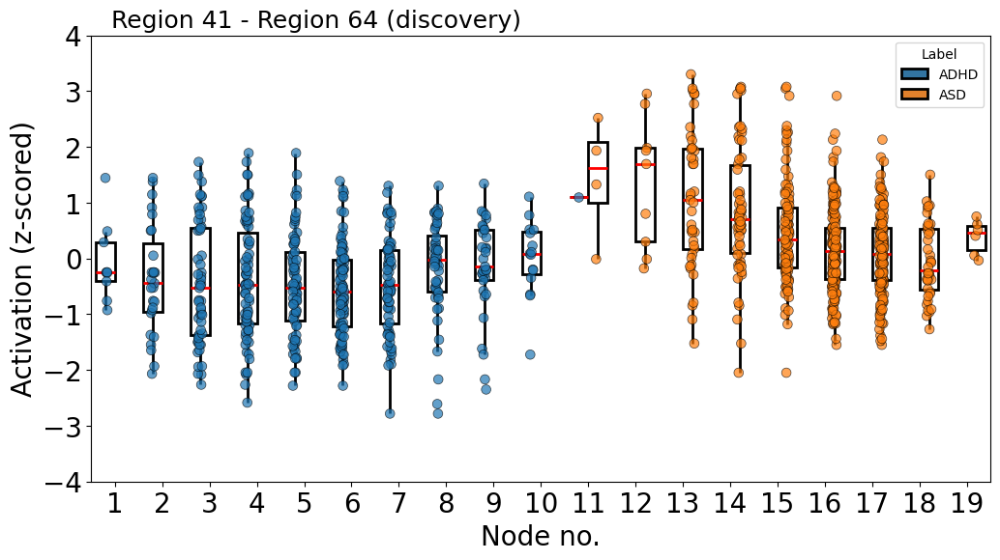

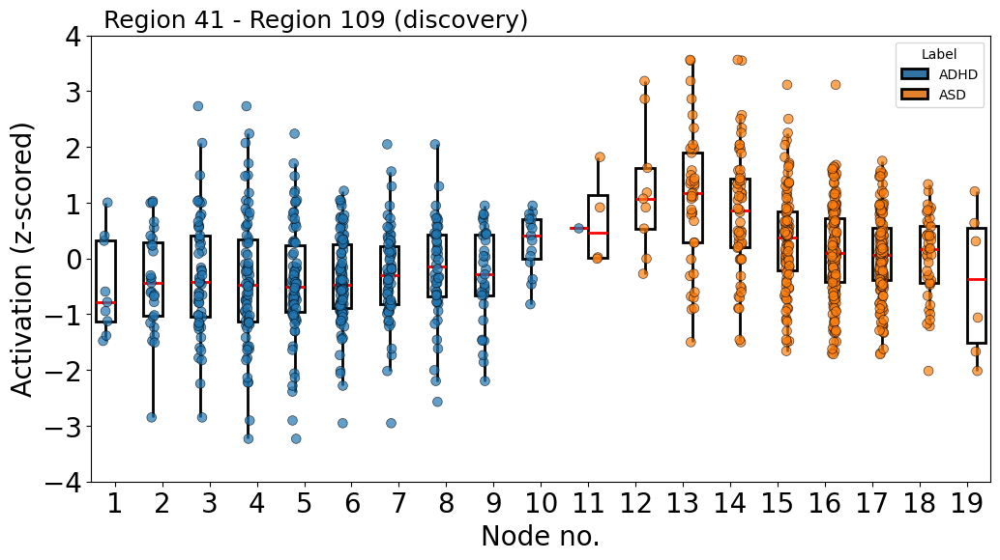

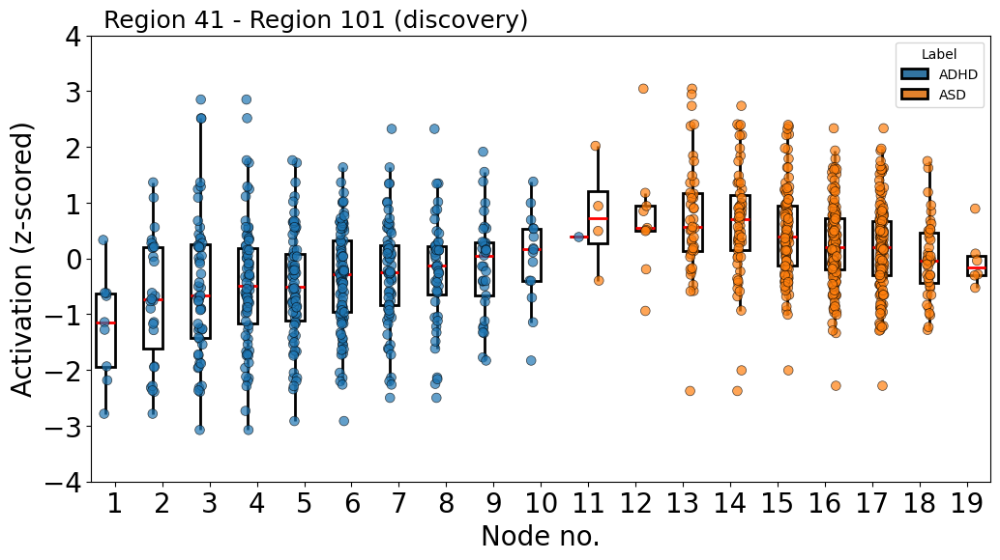

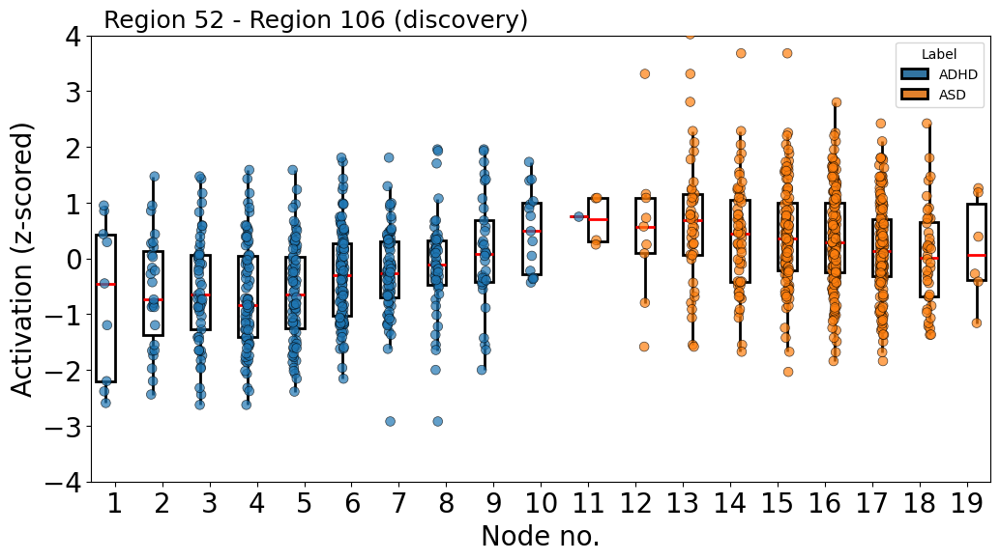

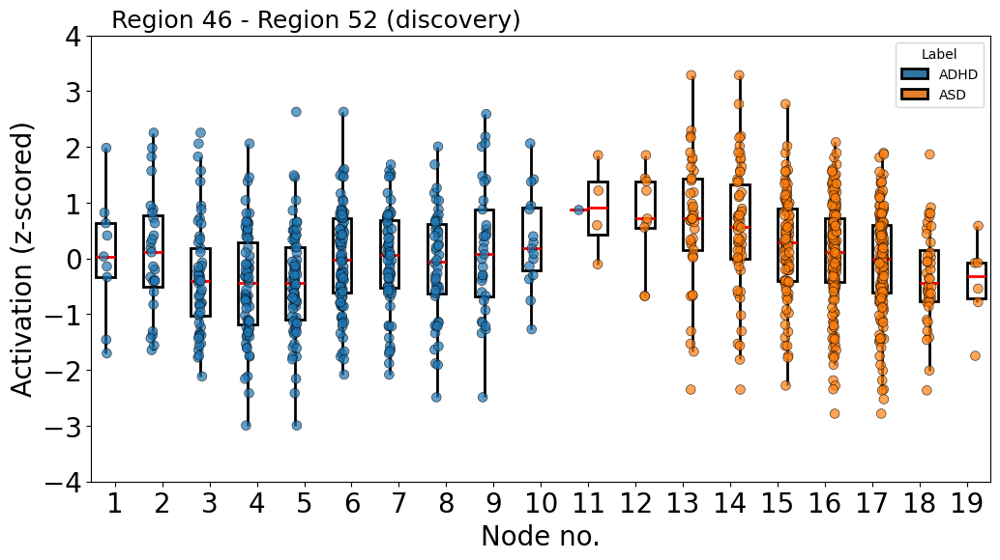

...

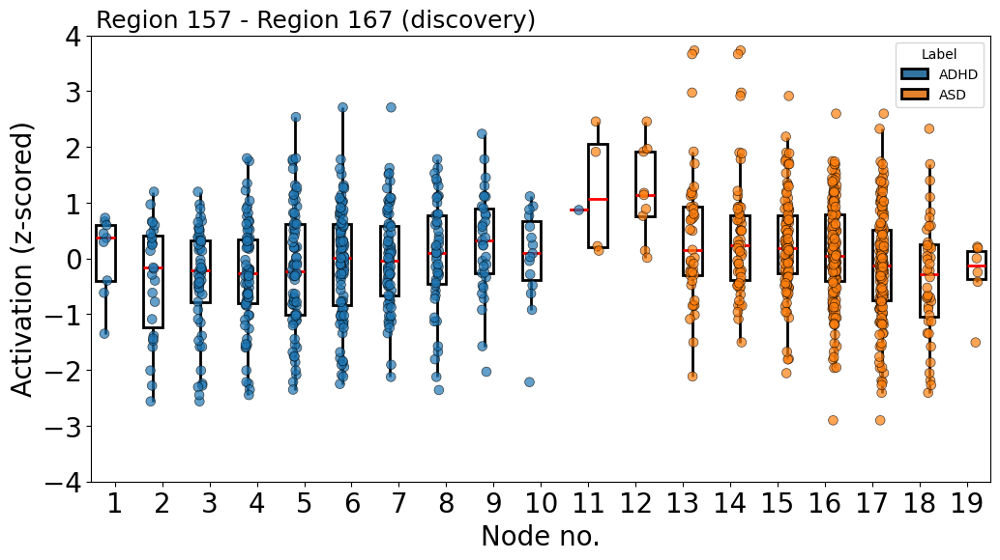

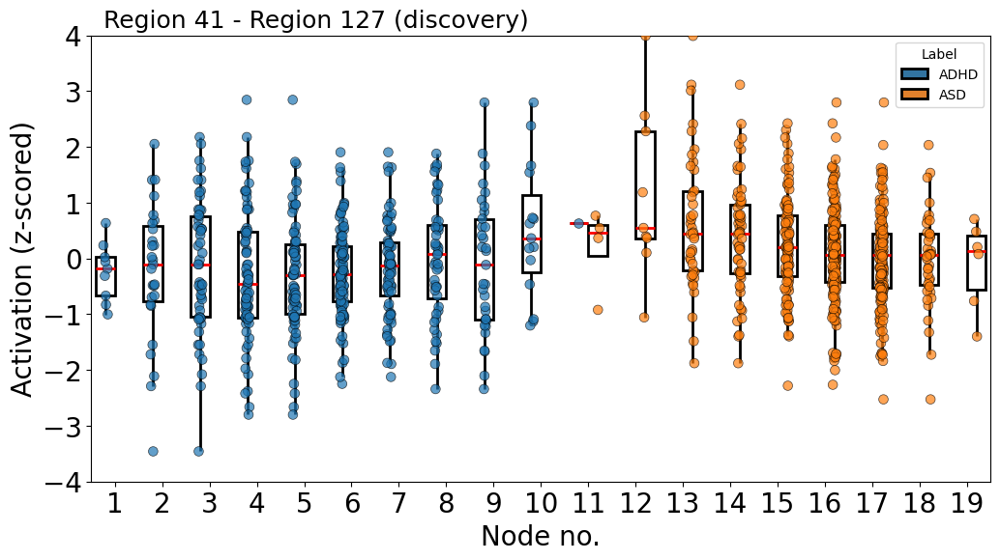

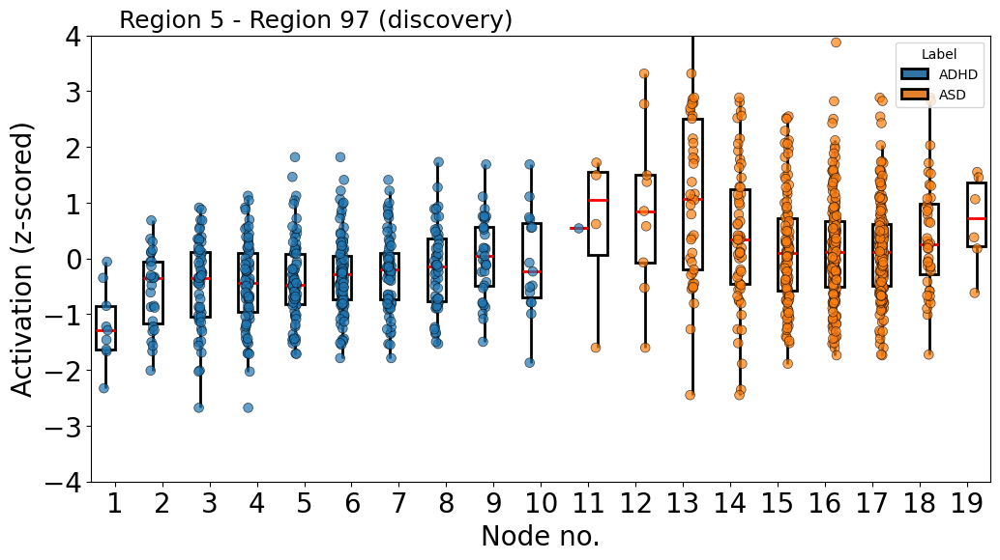

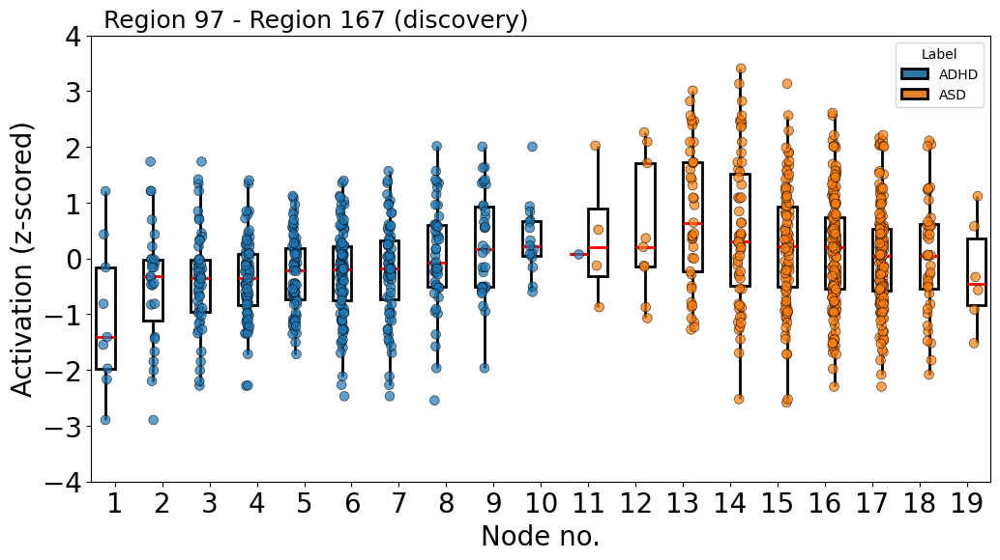

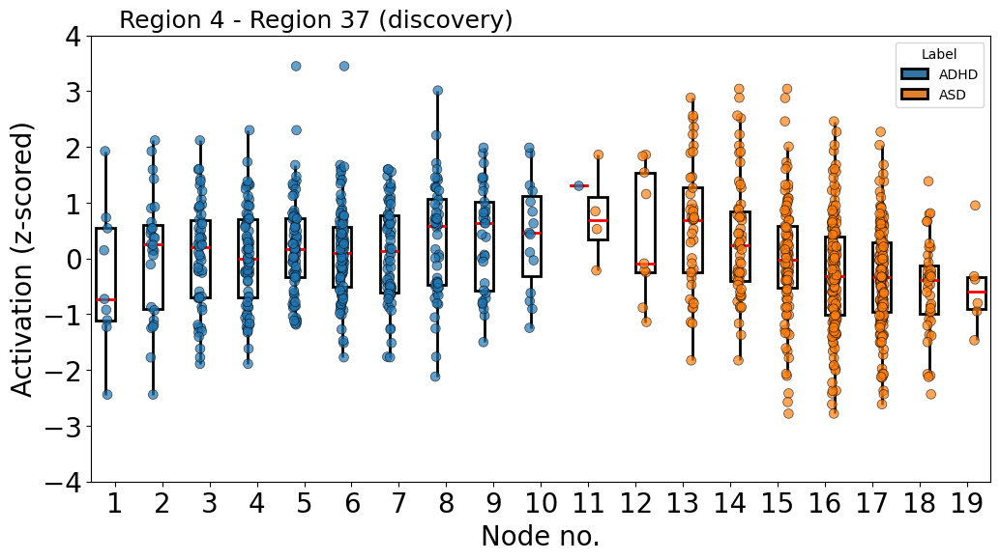

In [ ]:
for n, feature in enumerate(fourth_pattern.keys()):
  if(n < 11):
    regions = feature_to_regions(feature, map_df)
    title = f"Region {regions[0]} - Region {regions[1]} (discovery)"
    fig, ax = multinodes_paired_boxplot(discovery_df, feature, [i for i in range(1,20)], title)
    file_name = f"region_{regions[0]}-{regions[1]}_discovery.png"
    fig.savefig(f"{SOURCE_DIR}/plots/{file_name}", dpi=300, bbox_inches='tight')

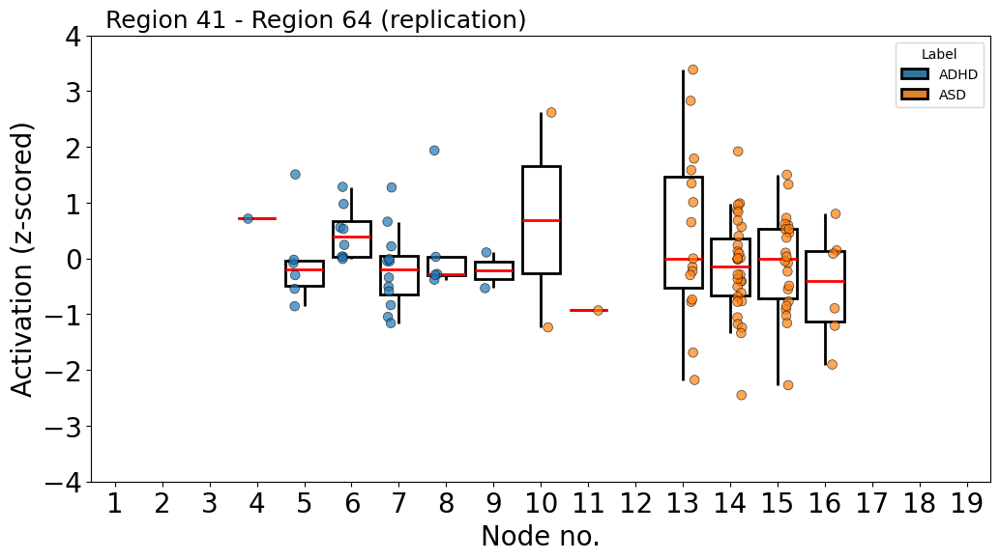

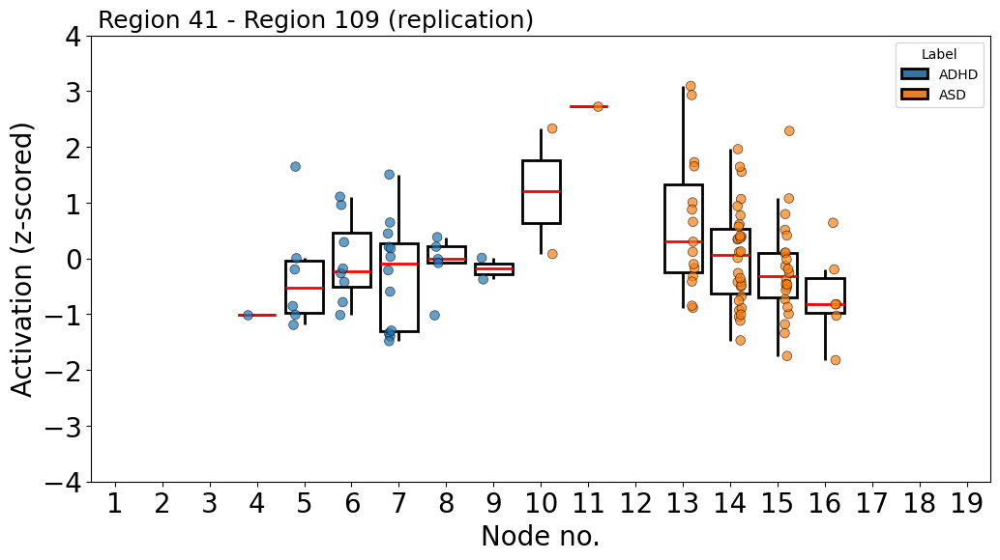

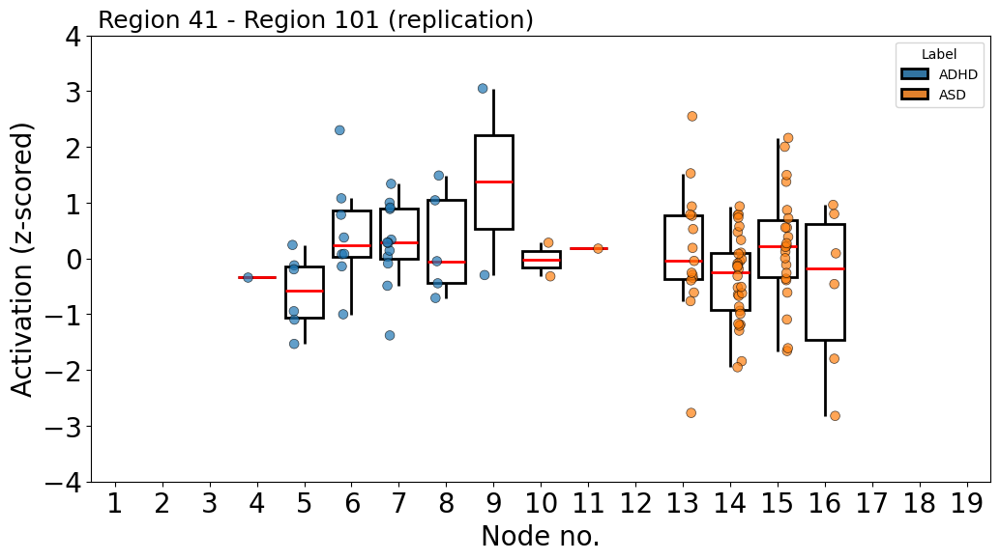

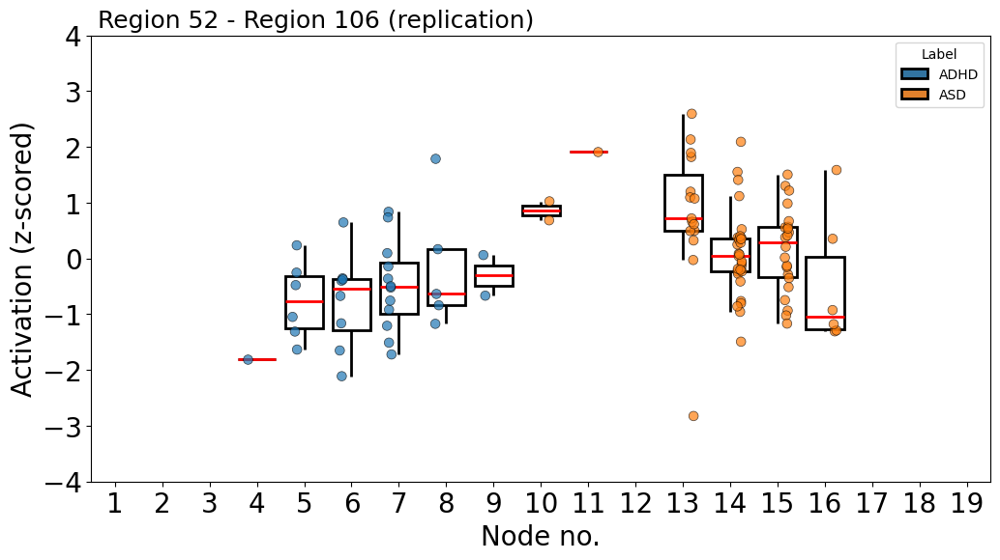

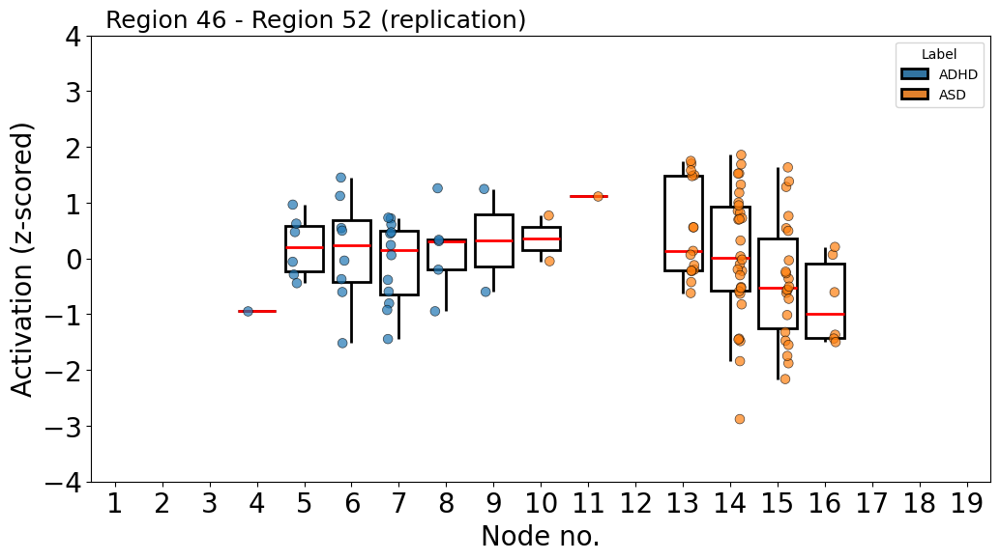

...

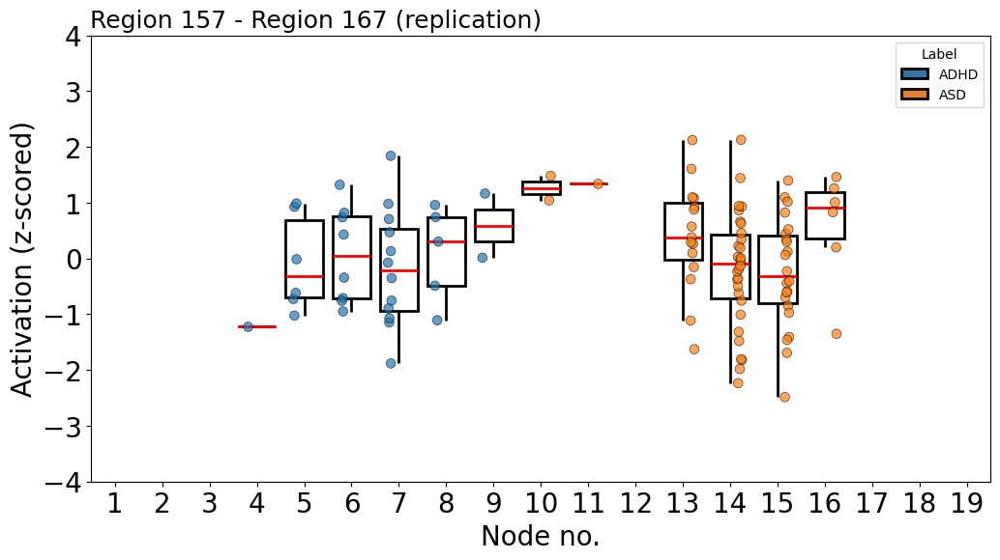

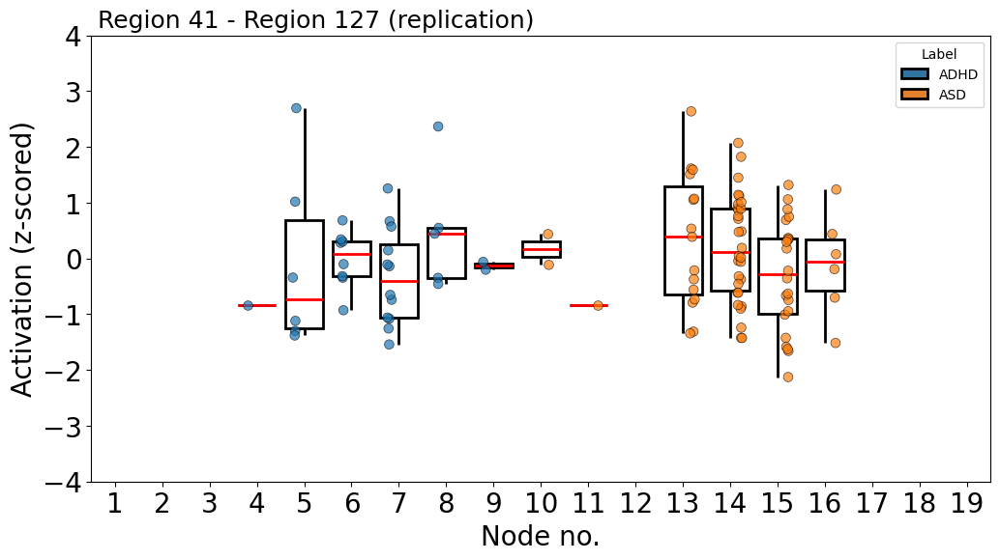

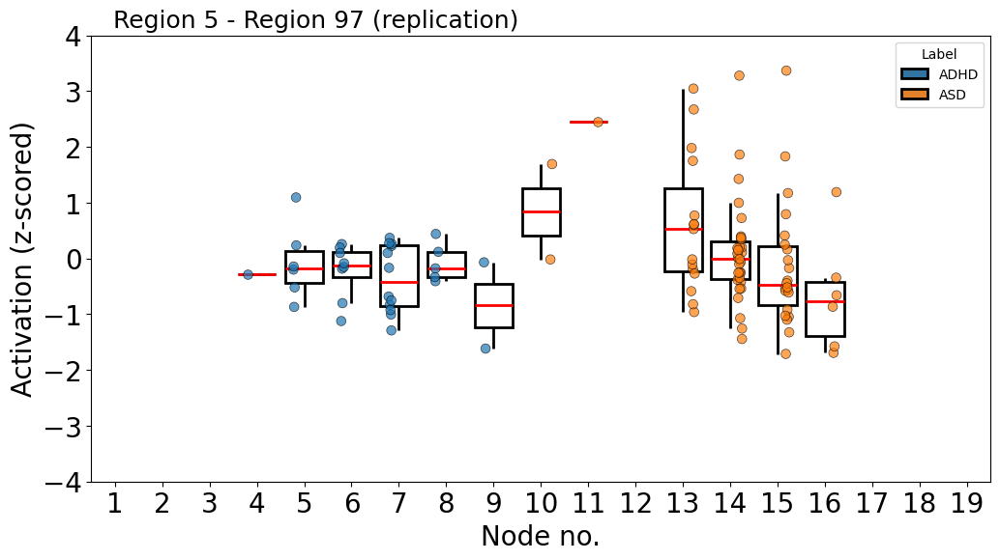

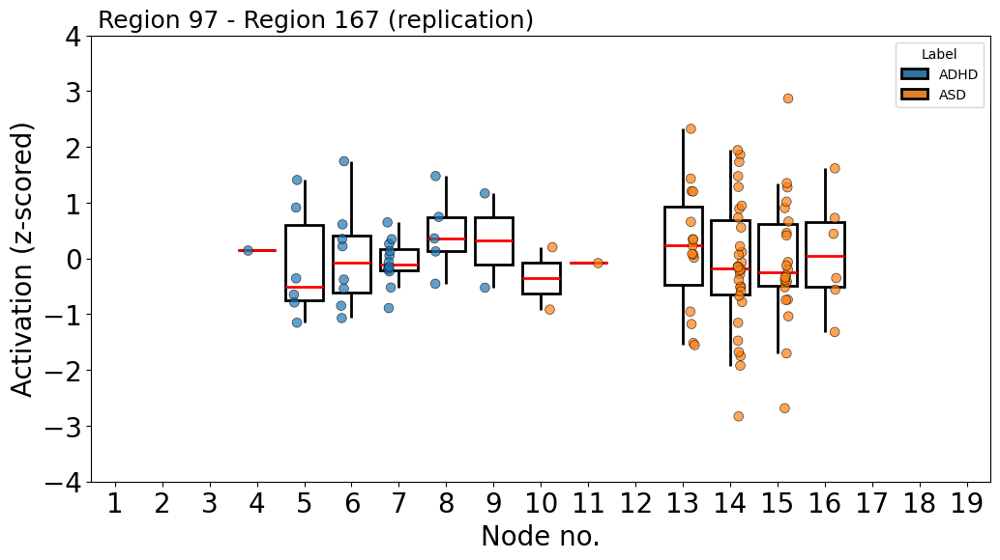

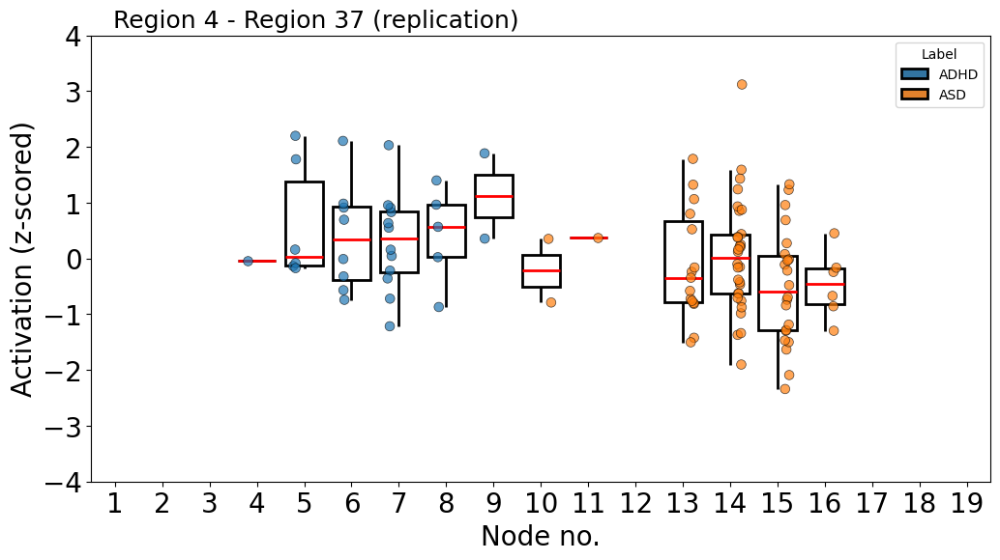

In [ ]:
for n, feature in enumerate(fourth_pattern.keys()):
  if(n < 11):
    regions = feature_to_regions(feature, map_df)
    title = f"Region {regions[0]} - Region {regions[1]} (replication)"
    fig, ax = multinodes_paired_boxplot_validation(replication_df, feature, [i for i in range(1,20)], title)
    file_name = f"region_{regions[0]}-{regions[1]}_replication.png"
    fig.savefig(f"{SOURCE_DIR}/plots/{file_name}", dpi=300, bbox_inches='tight')

In [ ]:
def extract_transition_features(discovery_df, graph_file, node_ids):
  feature_columns = [col for col in discovery_df.columns if col not in ['bin', 'second_bin', 'label', 'cluster', 'second_cluster']]
  num_features = len(feature_columns)
  features_matrix = np.full((num_features, len(node_ids)), np.nan)
  std_matrix = np.full((num_features, len(node_ids)), np.nan)

  for node_id in node_ids:
    discovery_node_df = filter_by_mapper_node(graph_file, discovery_df, node_id)
    discovery_node_df = discovery_node_df[feature_columns]
    discovery_node_mean = discovery_node_df.median().values
    std_matrix[:, node_id-1] = discovery_node_df.std().values
    features_matrix[:, node_id-1] = discovery_node_mean
    print(f"Progress: {node_id}/{len(node_ids)}")

    # for feature in feature_columns:
    #   features_matrix[feature][node_id] = discovery_node_df[feature].mean()

  return features_matrix, std_matrix


In [ ]:
fm, sm = extract_transition_features(discovery_df, graph_file, [i for i in range(1,17)])

Progress: 1/16
Progress: 2/16
Progress: 3/16
Progress: 4/16
Progress: 5/16
Progress: 6/16
Progress: 7/16
Progress: 8/16
Progress: 9/16
Progress: 10/16
Progress: 11/16
Progress: 12/16
Progress: 13/16
Progress: 14/16
Progress: 15/16
Progress: 16/16


In [ ]:
fm.shape

(17955, 16)

In [ ]:
def get_correlation_scores(df, graph_file, bridge_nodes, features_matrix, sm):
  x = np.arange(features_matrix.shape[1])
  corr_p_features = []
  for feature in range(features_matrix.shape[0]):
    red_flag = 0
    for node_id in bridge_nodes:
      node_df = filter_by_mapper_node(graph_file, df, node_id)
      feature, t_stat, p_val_t = t_test_asd_vs_adhd(df, node_df, feature)
      # feature, f_stat, p_val_f = f_test_asd_vs_adhd(df, node_df, feature)
      if (p_val_t <= 0.05):
        red_flag = 1
        break

    if(red_flag == 0):
      correlation, p_value = pearsonr(x, features_matrix[feature])

      if(p_value < 0.05 and np.abs(correlation) > 0.8 and sm[feature][sm[feature] > 0.15].shape[0] == 0):
        corr_p_features.append((feature, correlation, p_value))
  return corr_p_features

def get_correlation_each_side(df, graph_file, bridge_nodes, features_matrix, sm):
  left_nodes = np.array([0,1,2,3,4,5,6,7,8,9])
  right_nodes = np.array([9,10,11,12,13,14])
  left = features_matrix[:, left_nodes]
  right = features_matrix[:, right_nodes]
  # x_left = np.arange(len(left_nodes))
  # x_right = np.arange(len(right_nodes))
  corr_features = []
  # print(x_left, x_right)
  for feature in range(features_matrix.shape[0]):
    red_flag = 0
    for node_id in bridge_nodes:
      node_df = filter_by_mapper_node(graph_file, df, node_id)
      feature, t_stat, p_val_t = t_test_asd_vs_adhd(df, node_df, feature)
      # feature, f_stat, p_val_f = f_test_asd_vs_adhd(df, node_df, feature)
      if (p_val_t <= 0.05):
        red_flag = 1
        break
    if(red_flag == 0):
      correlation_left, p_value_left = pearsonr(left_nodes, left[feature])
      correlation_right, p_value_right = pearsonr(right_nodes, right[feature])
      if(correlation_left < 0):
        if(correlation_right > 0 and p_value_left < 0.05 and p_value_right < 0.05 and np.abs(correlation_left) > 0.8 and np.abs(correlation_right) > 0.8 and sm[feature][sm[feature] > 0.15].shape[0] == 0):
          corr_features.append((feature, correlation_left, correlation_right))
      else:
        if(correlation_right < 0 and p_value_left < 0.05 and p_value_right < 0.05 and np.abs(correlation_left) > 0.8 and np.abs(correlation_right) > 0.8 and sm[feature][sm[feature] > 0.15].shape[0] == 0):
          corr_features.append((feature, correlation_left, correlation_right))

  return corr_features

# def get_correlation_scores_with_labels(features_matrix, labels):
#   x = labels
#   corrs = np.zeros(features_matrix.shape[0])
#   p_vals = np.zeros(features_matrix.shape[0])

In [ ]:
corr_side = get_correlation_each_side(discovery_df, graph_file, [10], fm, sm)

In [ ]:
len(corr_side)

12

In [ ]:
corr_side

[(725, np.float64(0.8789961527799562), np.float64(-0.8817772111979523)),
 (926, np.float64(0.9410058236279641), np.float64(-0.832154504629566)),
 (1188, np.float64(-0.8089680172332496), np.float64(0.9287238470689375)),
 (1886, np.float64(0.9660245280930688), np.float64(-0.8534136580405689)),
 (3783, np.float64(0.9316146038970874), np.float64(-0.9749302409425719)),
 (4905, np.float64(0.9034366297884633), np.float64(-0.9495584807225952)),
 (5405, np.float64(-0.8212474140108551), np.float64(0.9385221049659747)),
 (5511, np.float64(0.8883587947319411), np.float64(-0.9848254782011834)),
 (5924, np.float64(0.9305457629684454), np.float64(-0.9728959608246955)),
 (8151, np.float64(0.9472712556927448), np.float64(-0.8234787953239782)),
 (11310, np.float64(-0.8984258338215803), np.float64(0.9290165254241063)),
 (12173, np.float64(0.9384633122480519), np.float64(-0.9958669176484569)),
 (13155, np.float64(0.928636969301607), np.float64(-0.8668945539339412)),
 (14443, np.float64(0.8819563028808413)

In [ ]:
corr_side = sorted(corr_side, key=lambda x: (abs(x[1]) + abs(x[2])) / 2, reverse=True)

In [ ]:
corr_side_3 = [i for i in corr_side if i[1] < 0]
corr_side_4 = [i for i in corr_side if i[1] > 0]

In [ ]:
corr_p_features = get_correlation_scores(discovery_df, graph_file, [10], fm, sm)

In [ ]:
corr_p_features = sorted(corr_p_features, key=lambda x: x[1], reverse=True)

In [ ]:
len(corr_p_features)

41

In [ ]:
corr_p_features_1 = [i for i in corr_p_features if i[1] > 0]
corr_p_features_2 = [i for i in corr_p_features if i[1] < 0]

In [ ]:
aggregate_key_features = corr_p_features + corr_side

In [ ]:
stability_dict = stability_of_mapper_features(discovery_df, replication_df, [f[0] for f in aggregate_key_features])

In [ ]:
count = 0
stable_features = []
sum = 0
total = 0
for feature in stability_dict:
  if stability_dict[feature] > 0.5:
    sum += stability_dict[feature]
    count += 1
    stable_features.append(feature)
  total += 1
avg = sum / total
print(count)
print(avg)

48
0.7952069716775599


## Pattern 1

In [ ]:
stability_dict = stability_of_mapper_features(discovery_df, replication_df, [f[0] for f in corr_p_features_1[:5]])

In [ ]:
stability_dict

{792: 0.6666666666666666,
 17643: 0.8888888888888888,
 17432: 0.5555555555555556,
 16551: 0.8888888888888888,
 11488: 1.0}

In [ ]:
average_stability(discovery_df, replication_df, [f[0] for f in corr_p_features_1])

0.8240740740740744

In [ ]:
len(corr_p_features_1)

24

<ipython-input-39-f9777cbc7064>:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(12, 6))


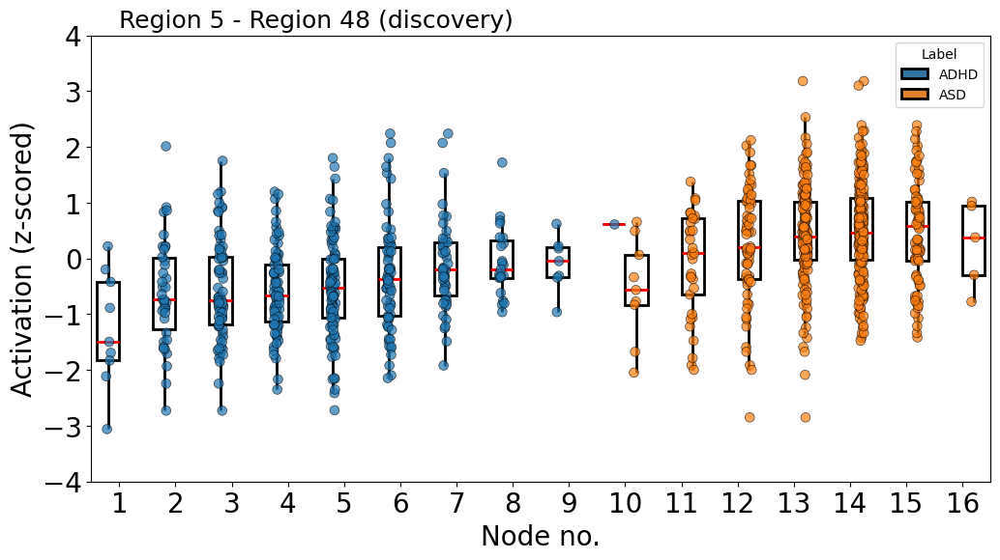

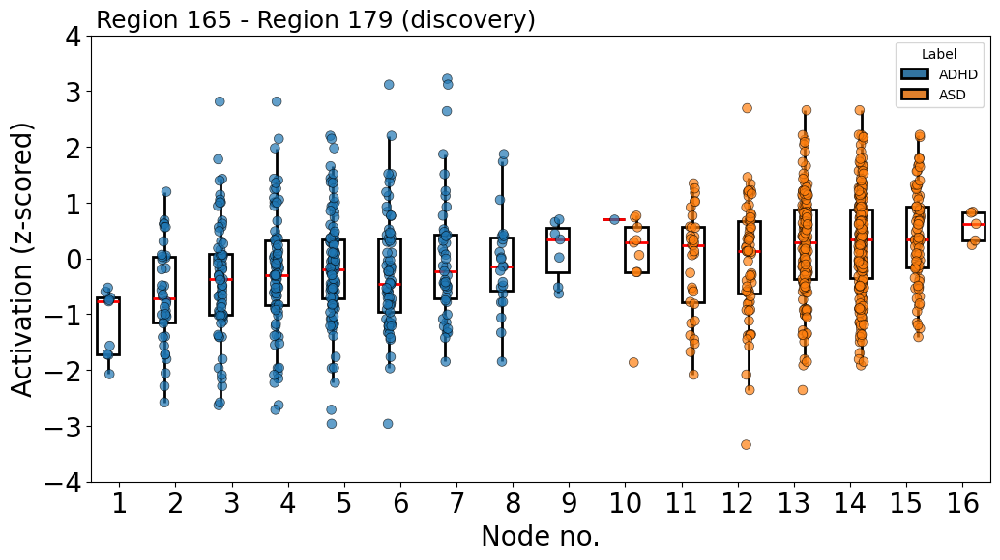

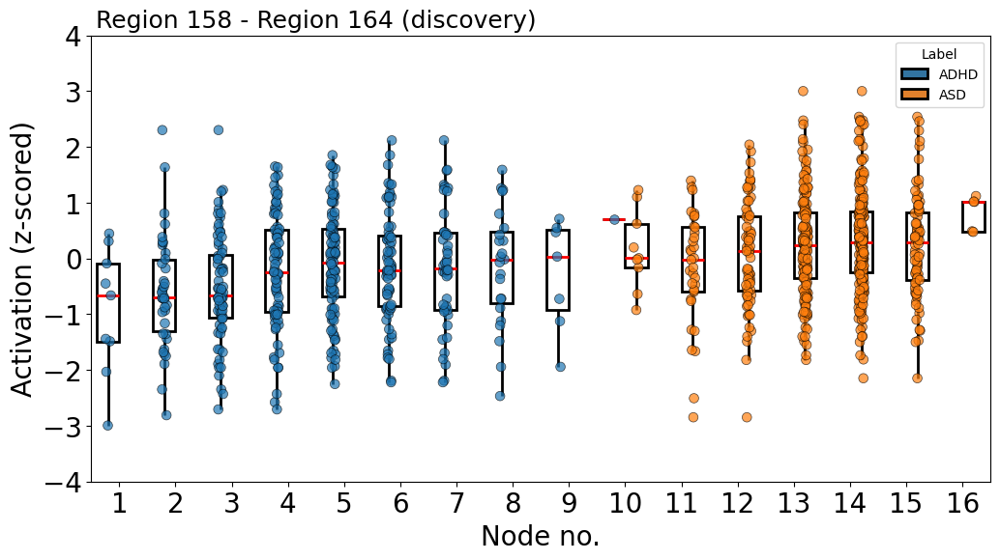

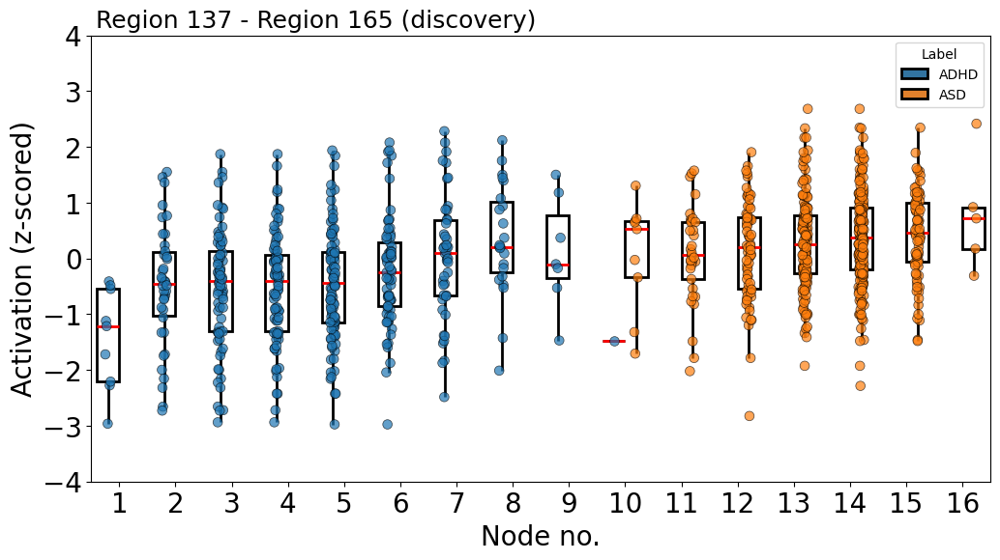

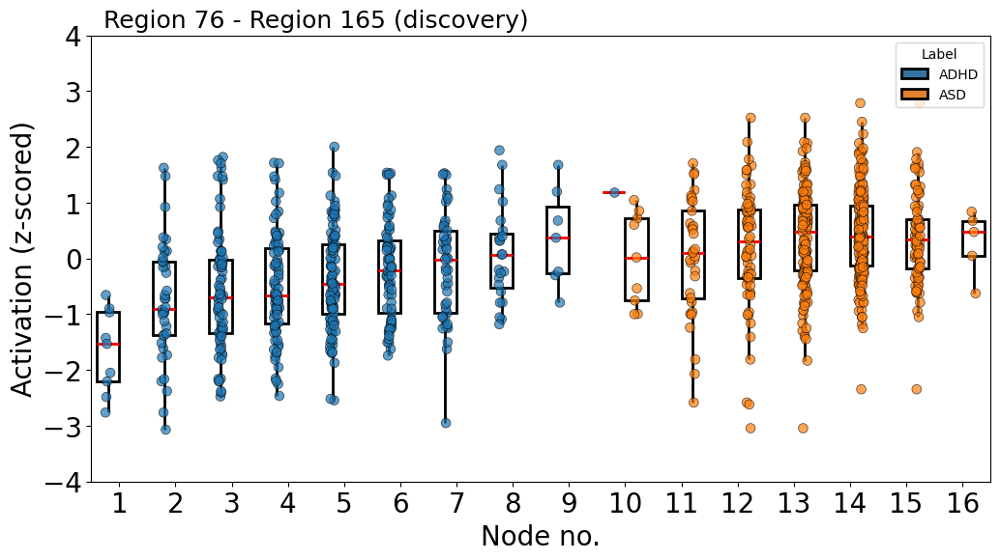

...

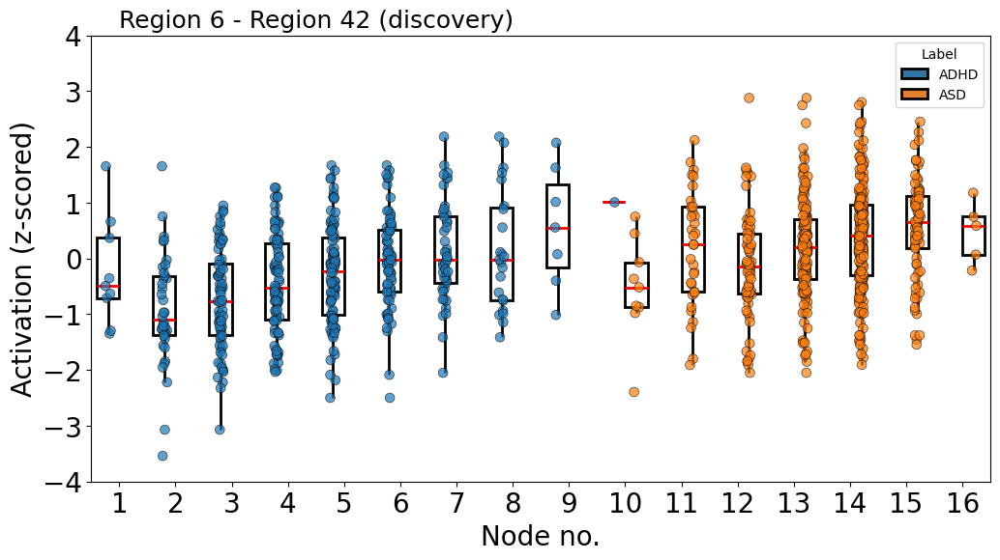

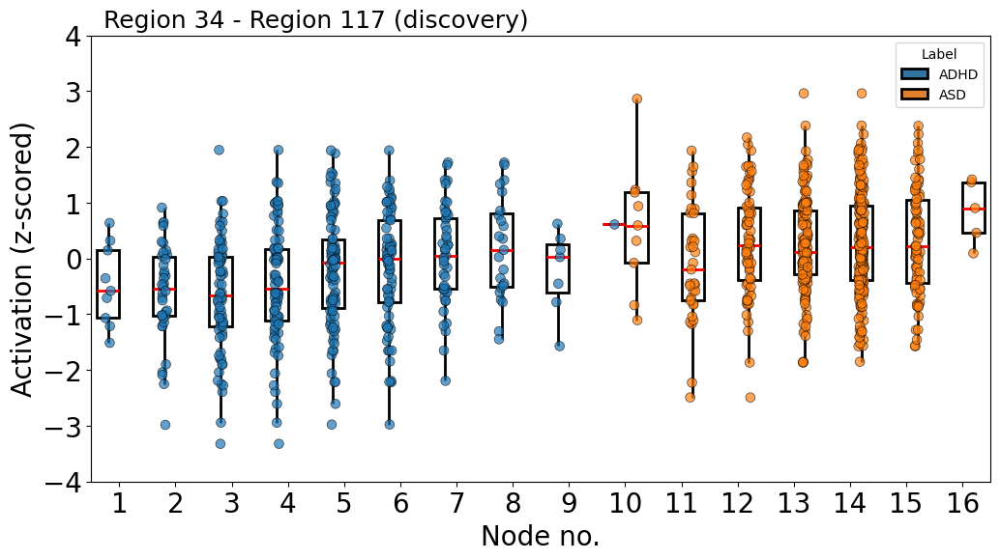

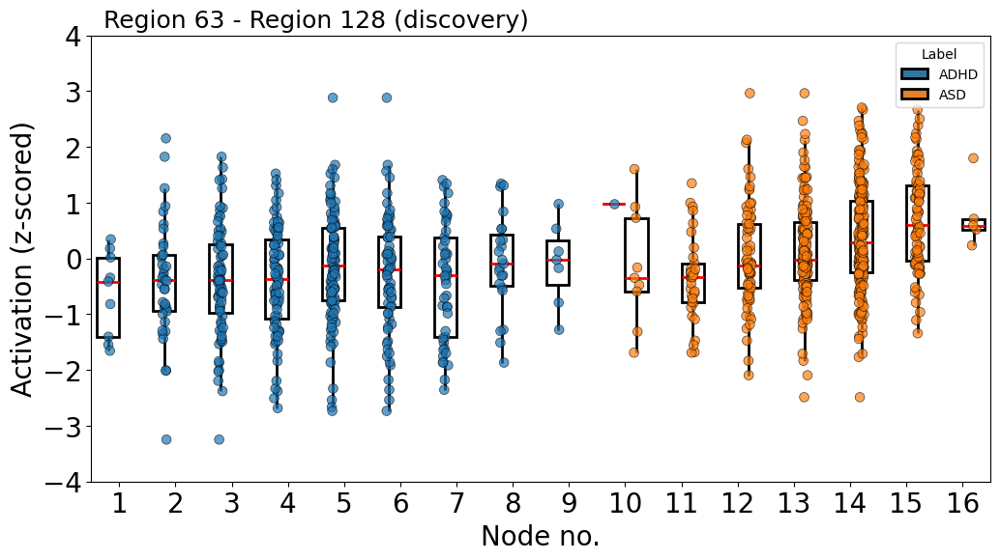

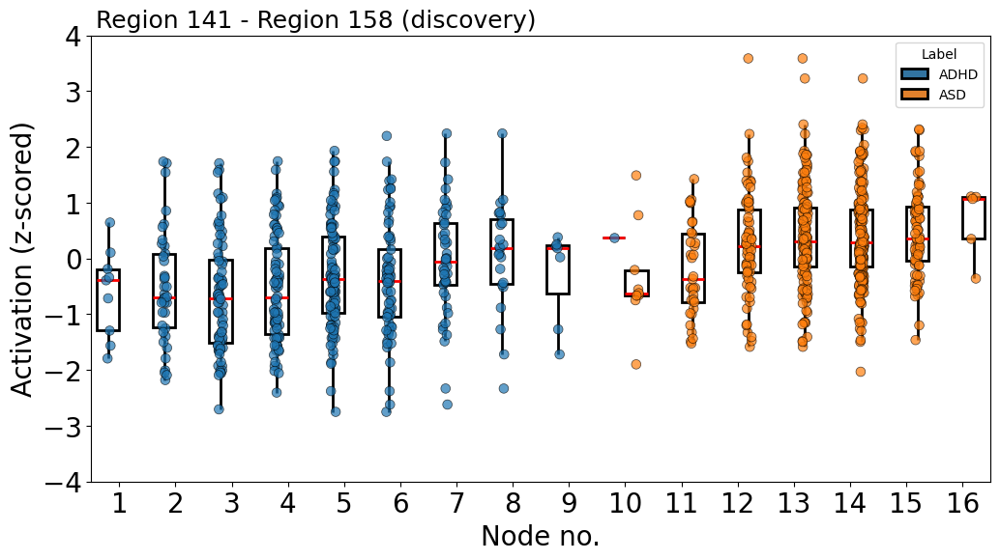

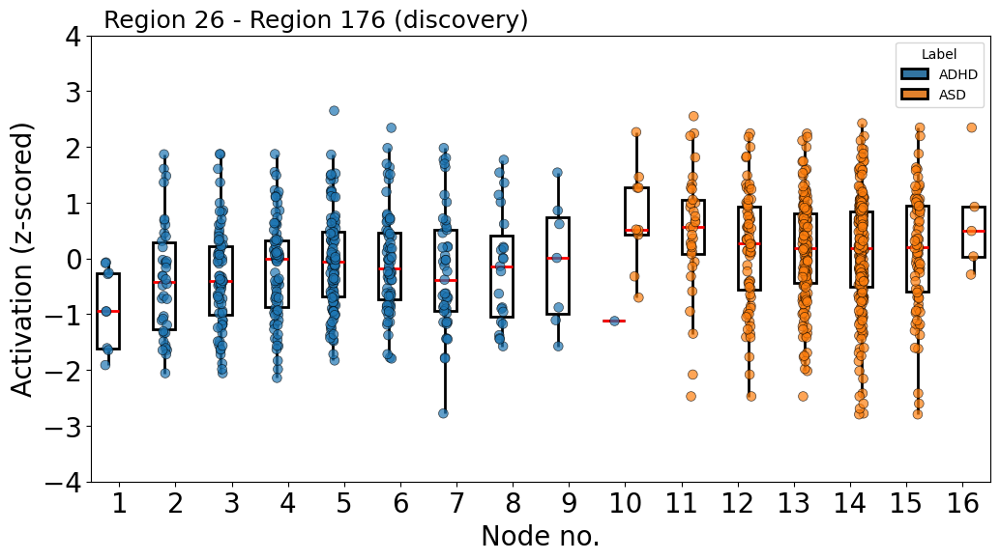

In [ ]:
for n, cpf in enumerate(corr_p_features_1):
  if(n < 100):
    feature = cpf[0]
    regions = feature_to_regions(feature, map_df)
    title = f"Region {regions[0]} - Region {regions[1]} (discovery)"
    fig, ax = multinodes_paired_boxplot(discovery_df, feature, [i for i in range(1,17)], title)
    file_name = f"region_{regions[0]}-{regions[1]}_discovery.png"
    fig.savefig(f"{SOURCE_DIR}/plots/{file_name}", dpi=300, bbox_inches='tight')

<ipython-input-44-4ca51193689f>:29: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(12, 6))


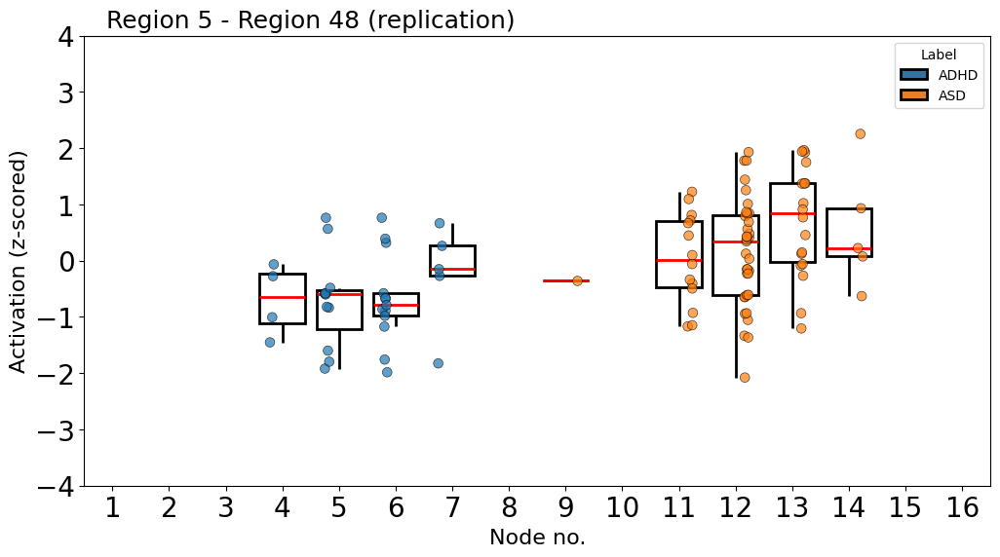

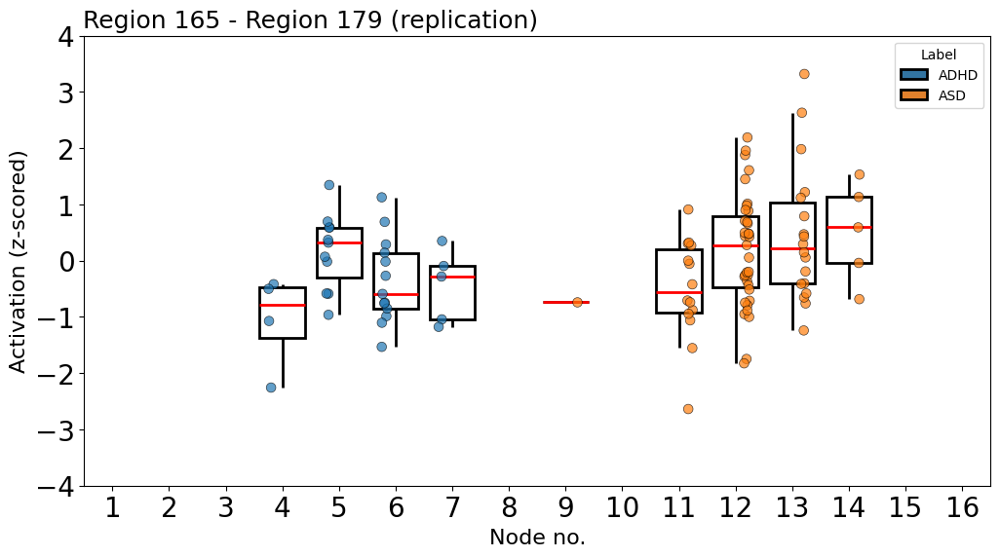

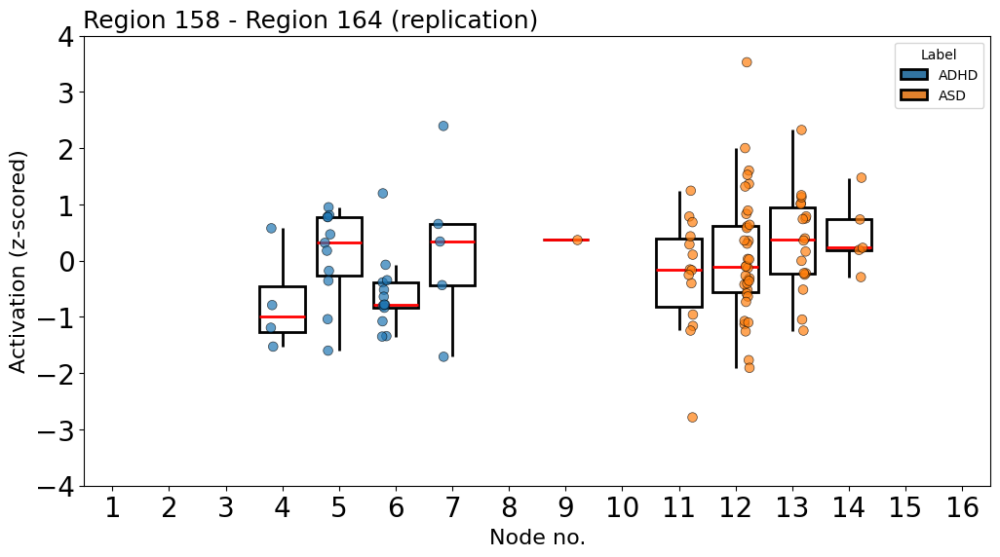

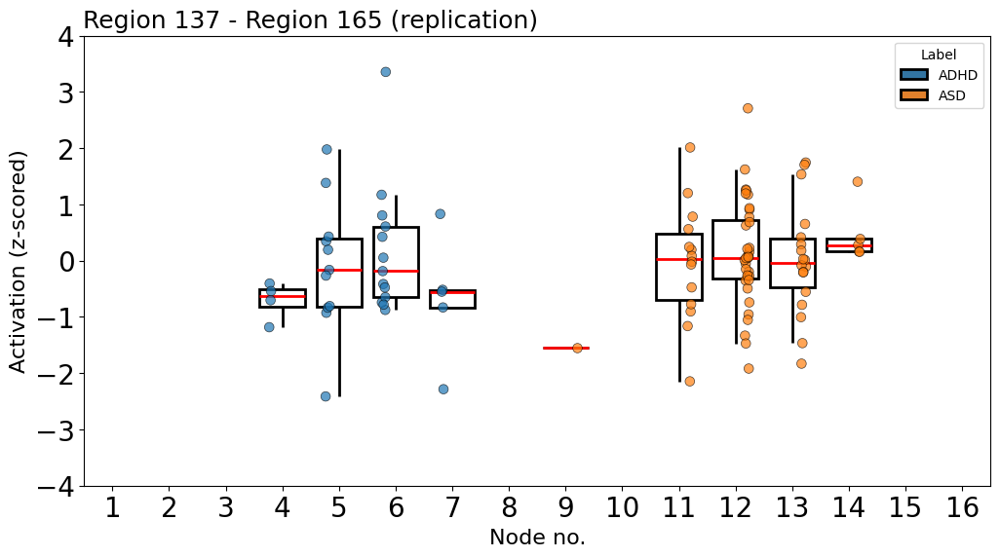

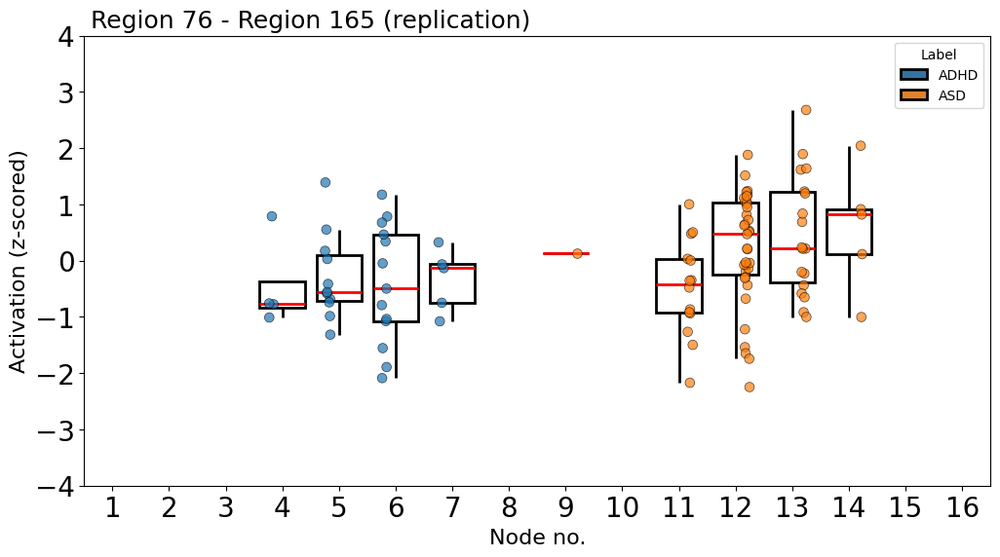

...

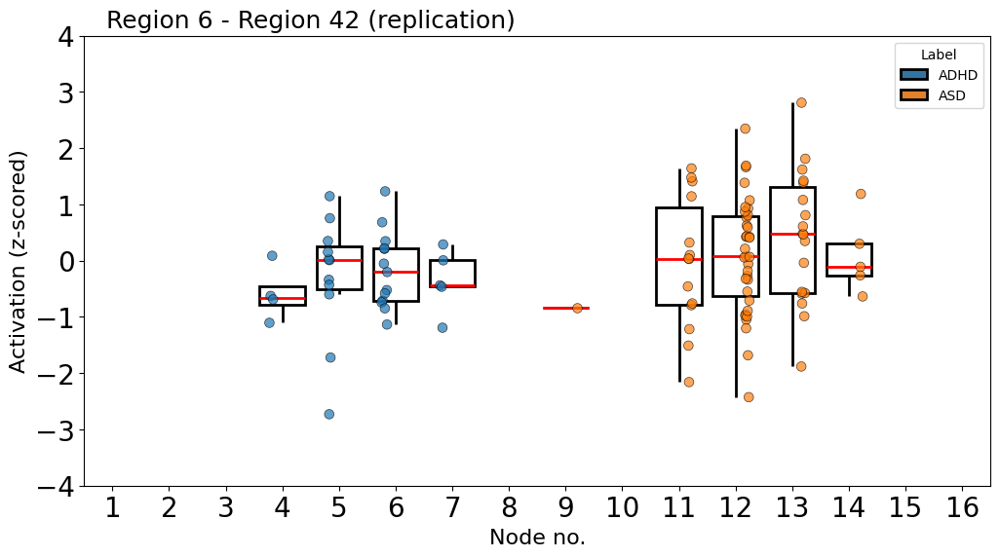

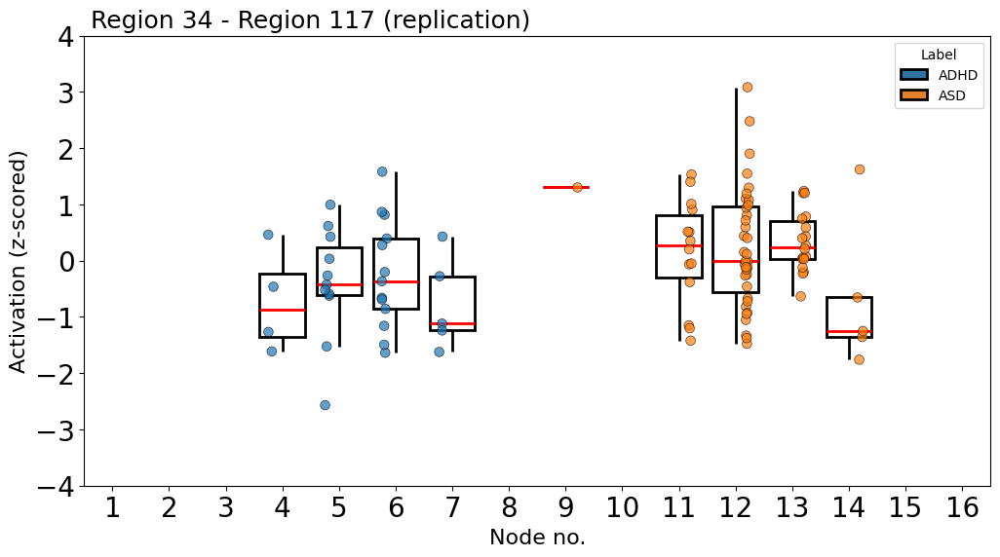

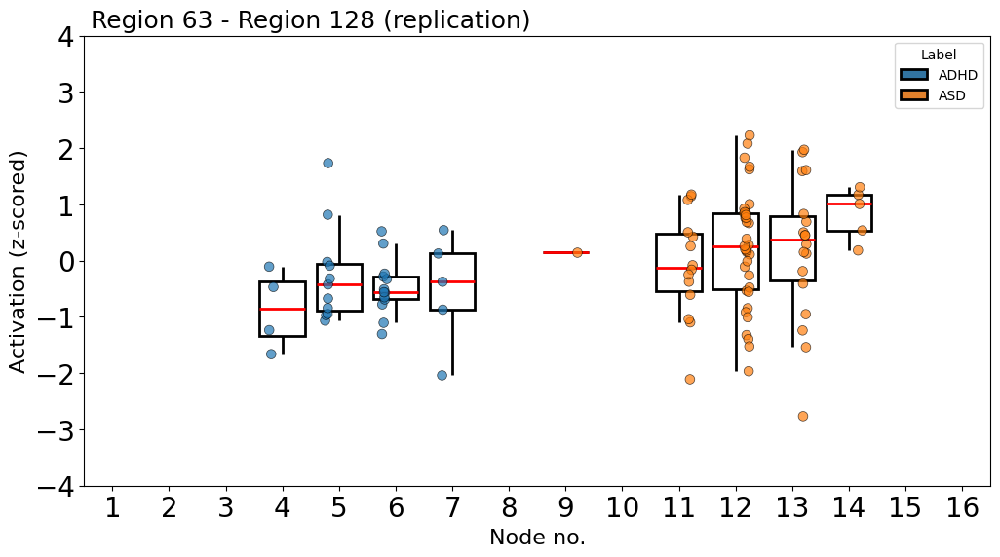

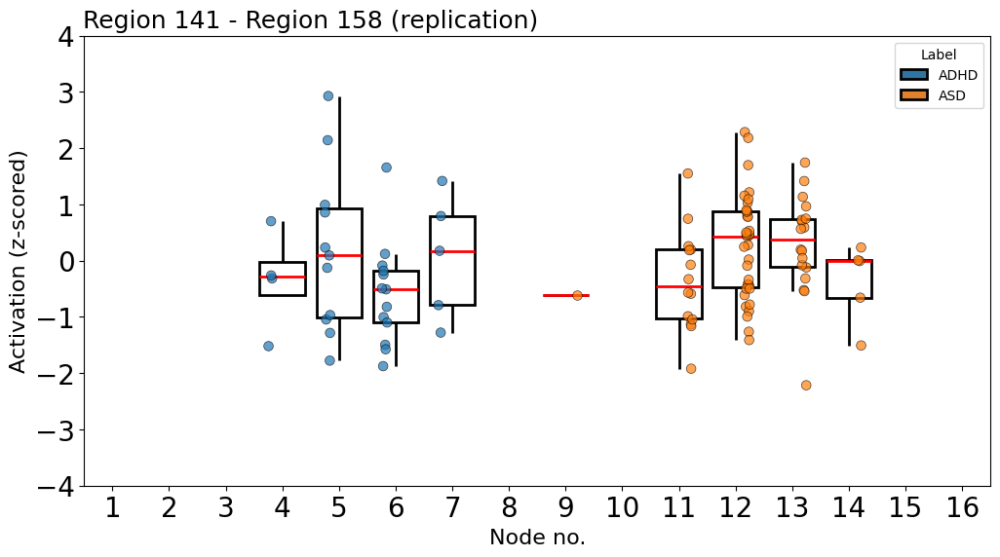

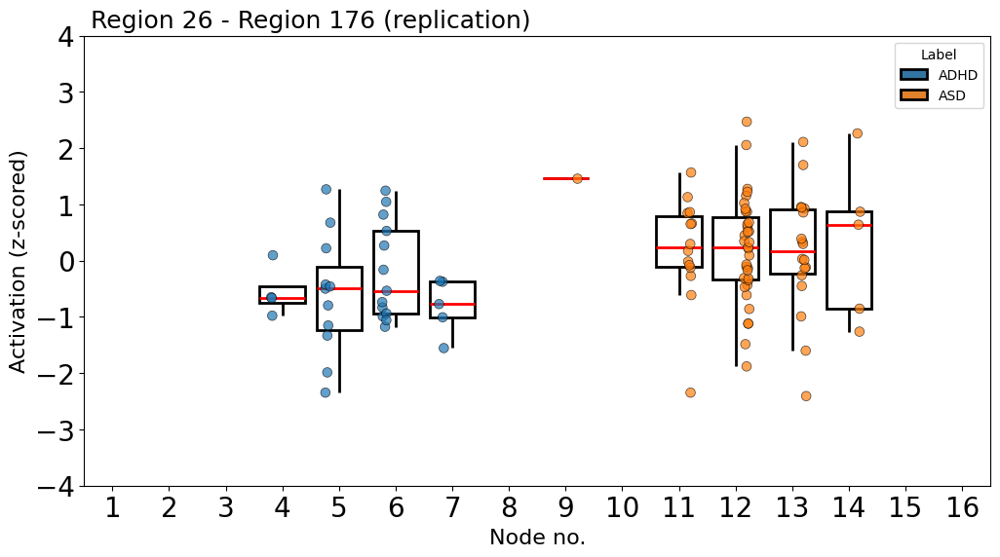

In [ ]:
for n, cpf in enumerate(corr_p_features_1):
  if(n < 100):
    feature = cpf[0]
    regions = feature_to_regions(feature, map_df)
    title = f"Region {regions[0]} - Region {regions[1]} (replication)"
    multinodes_paired_boxplot_validation(replication_df, feature, [i for i in range(1,17)], title)
    file_name = f"region_{regions[0]}-{regions[1]}_replication.png"
    fig.savefig(f"{SOURCE_DIR}/plots/{file_name}", dpi=300, bbox_inches='tight')


## Pattern 2

In [ ]:
stability_dict = stability_of_mapper_features(discovery_df, replication_df, [f[0] for f in corr_p_features_2[:5]])

In [ ]:
stability_dict

{16460: 0.6666666666666666,
 11194: 1.0,
 9022: 0.6666666666666666,
 2772: 0.7777777777777778,
 368: 0.8888888888888888}

In [ ]:
average_stability(discovery_df, replication_df, [f[0] for f in corr_p_features_2])

0.8431372549019609

In [ ]:
len(corr_p_features_2)

17

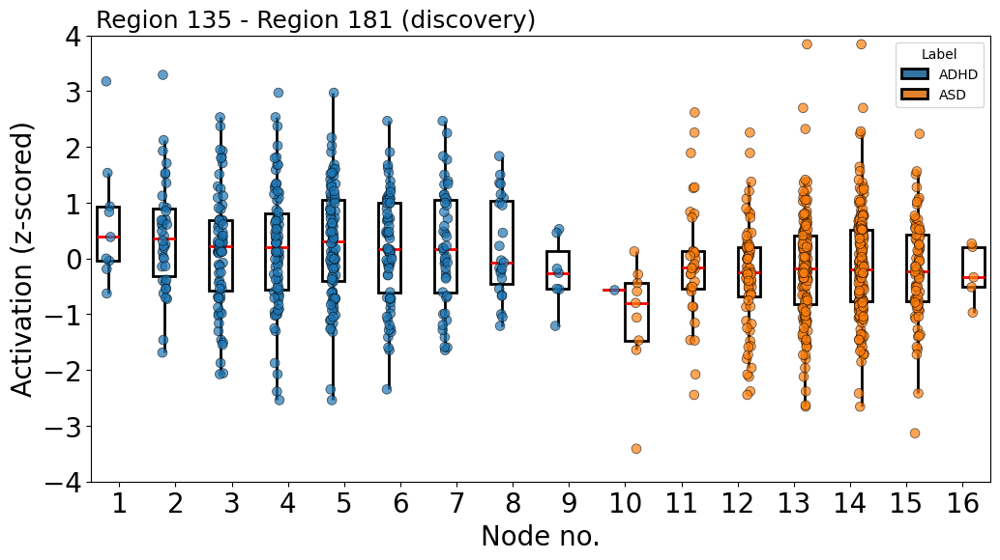

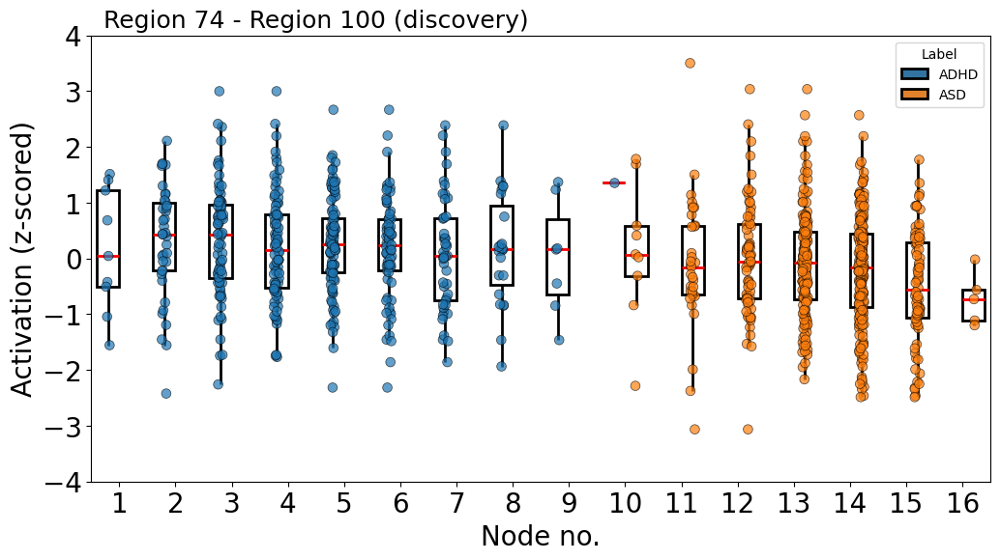

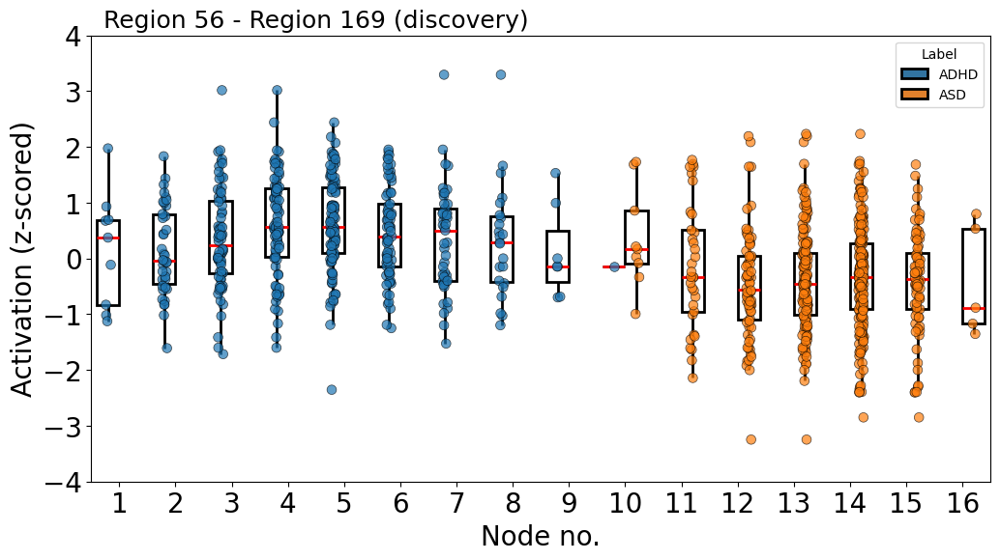

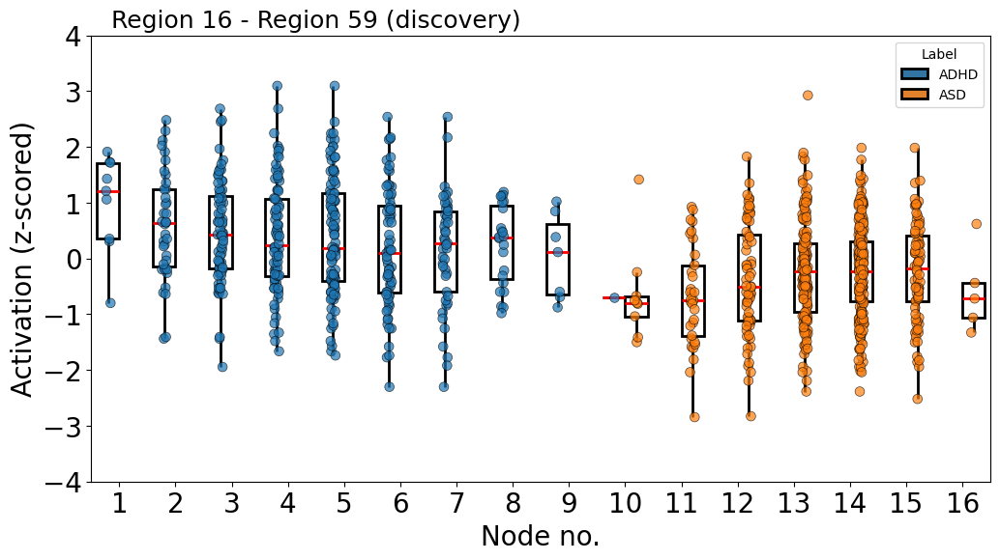

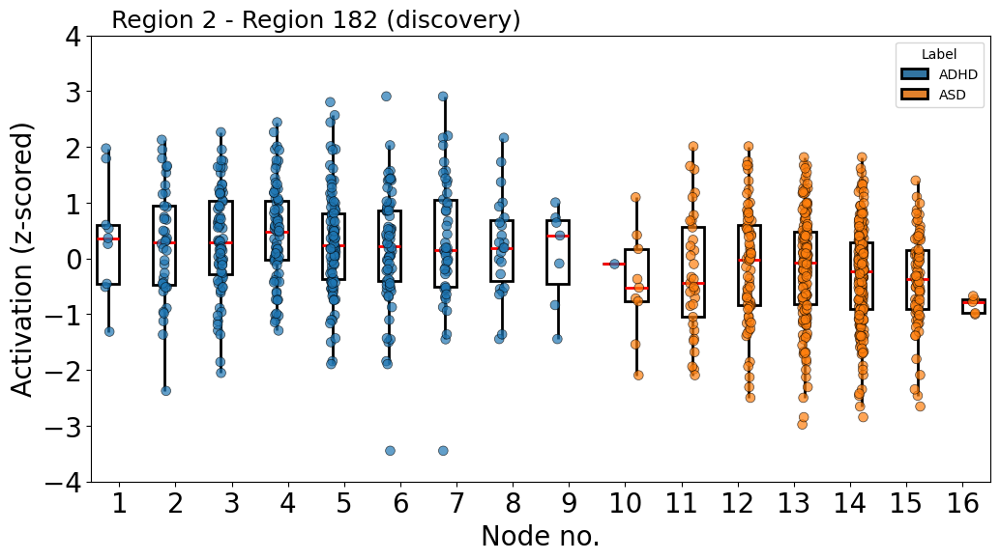

...

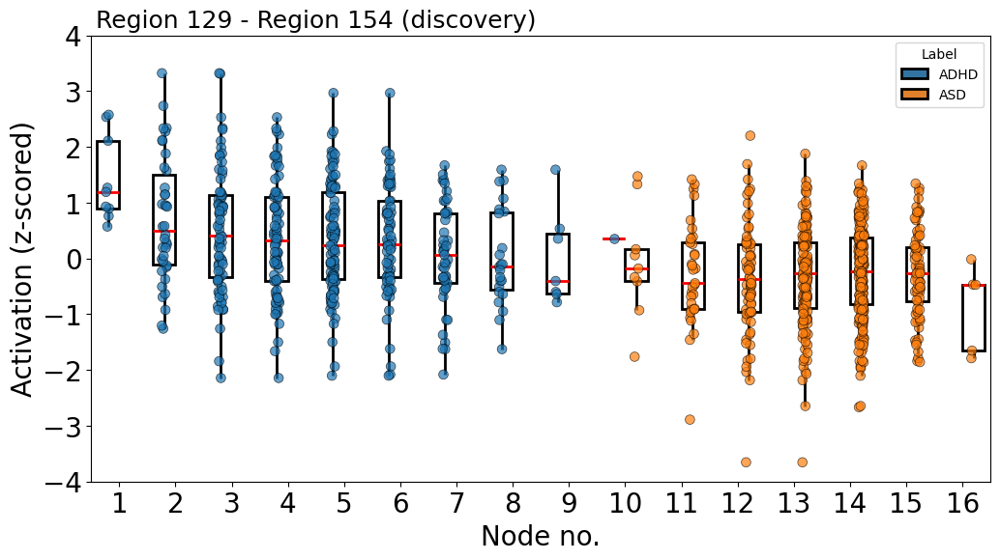

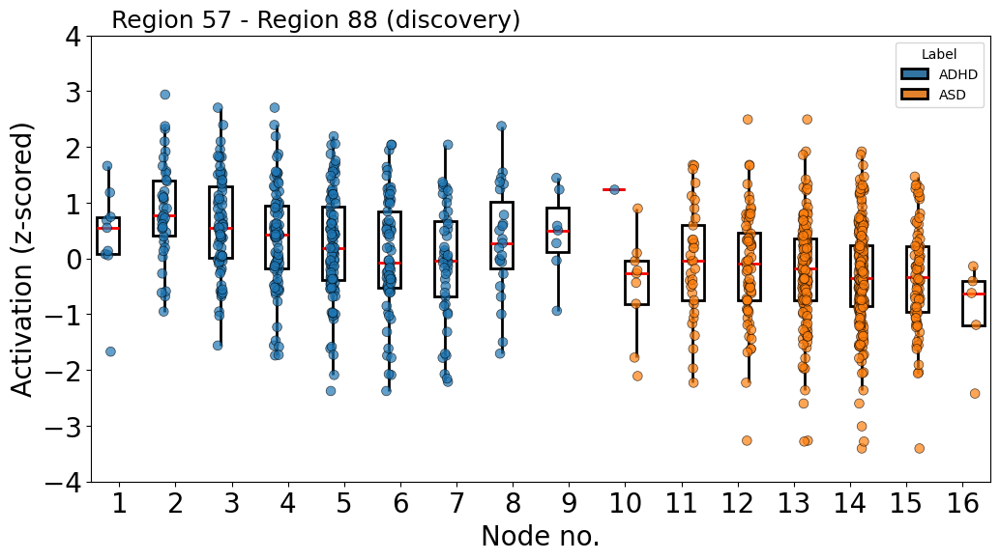

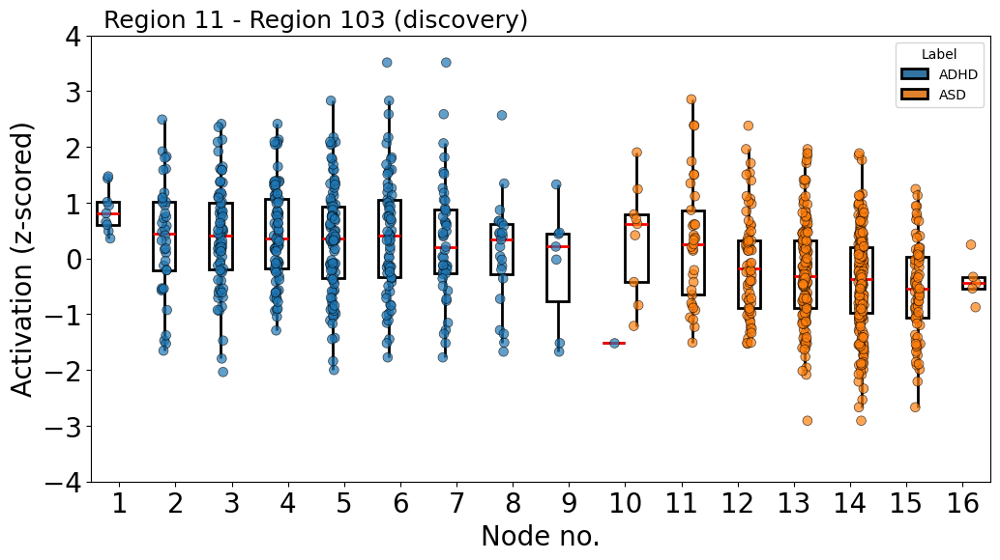

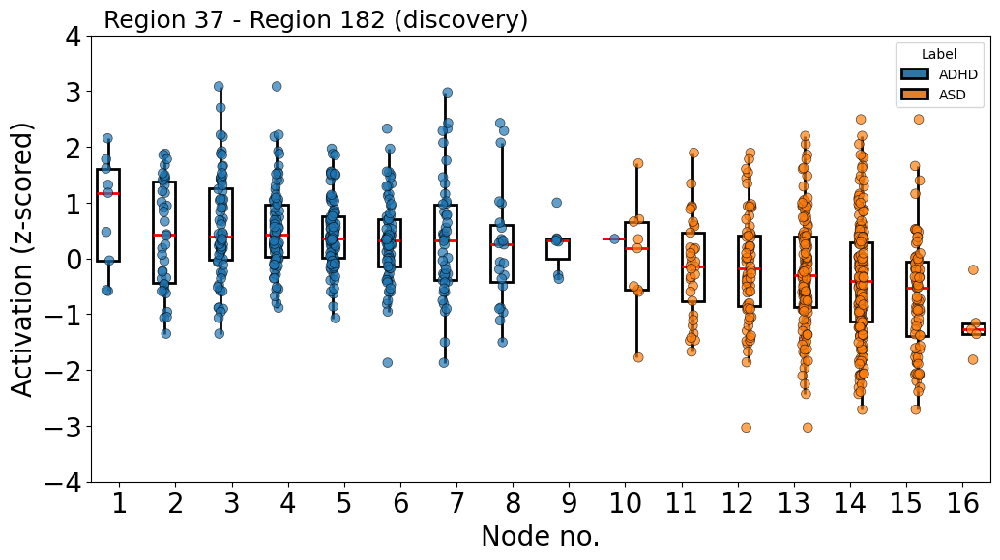

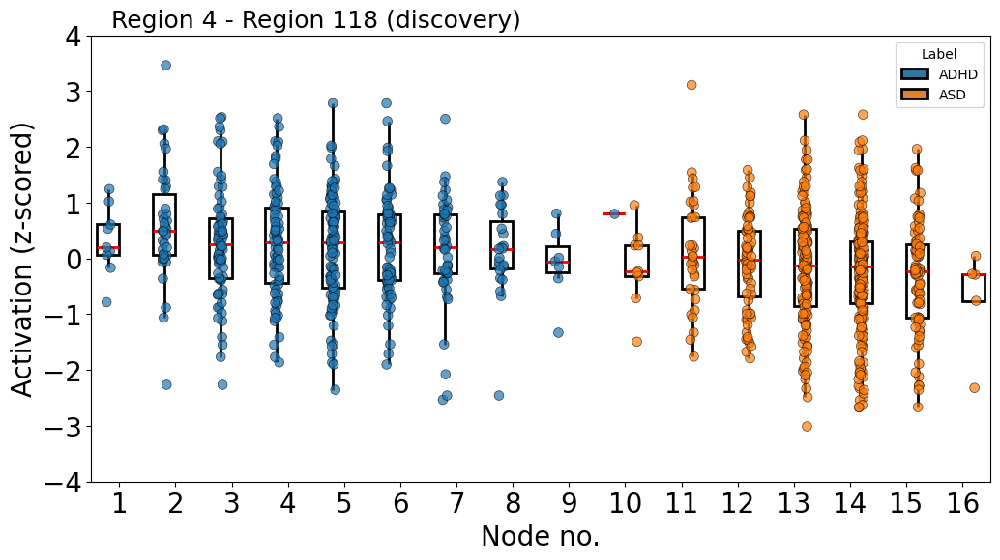

In [ ]:
for n, cpf in enumerate(corr_p_features_2):
  if(n < 100):
    feature = cpf[0]
    regions = feature_to_regions(feature, map_df)
    title = f"Region {regions[0]} - Region {regions[1]} (discovery)"
    fig, ax = multinodes_paired_boxplot(discovery_df, feature, [i for i in range(1,17)], title)
    file_name = f"region_{regions[0]}-{regions[1]}_discovery.png"
    fig.savefig(f"{SOURCE_DIR}/plots/{file_name}", dpi=300, bbox_inches='tight')

<ipython-input-44-4ca51193689f>:29: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(12, 6))


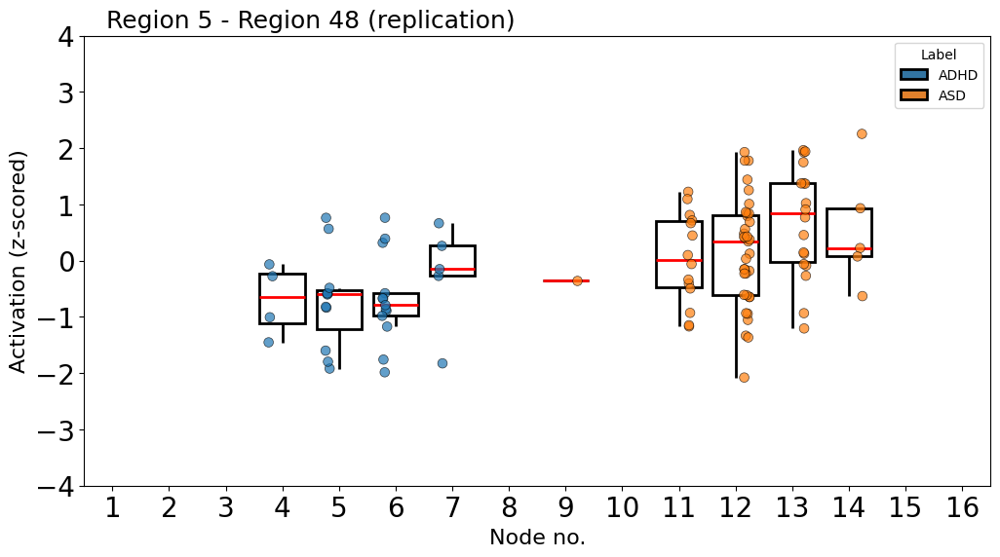

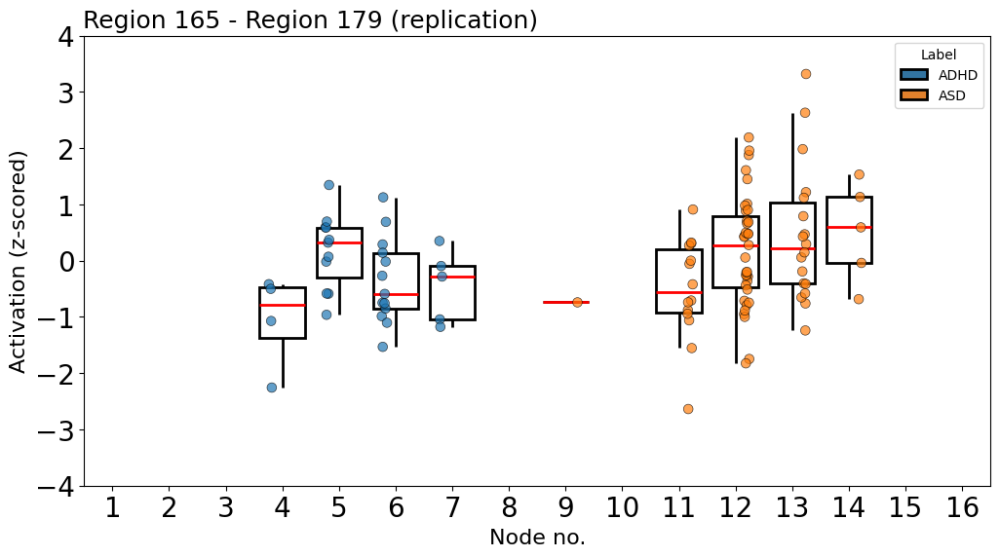

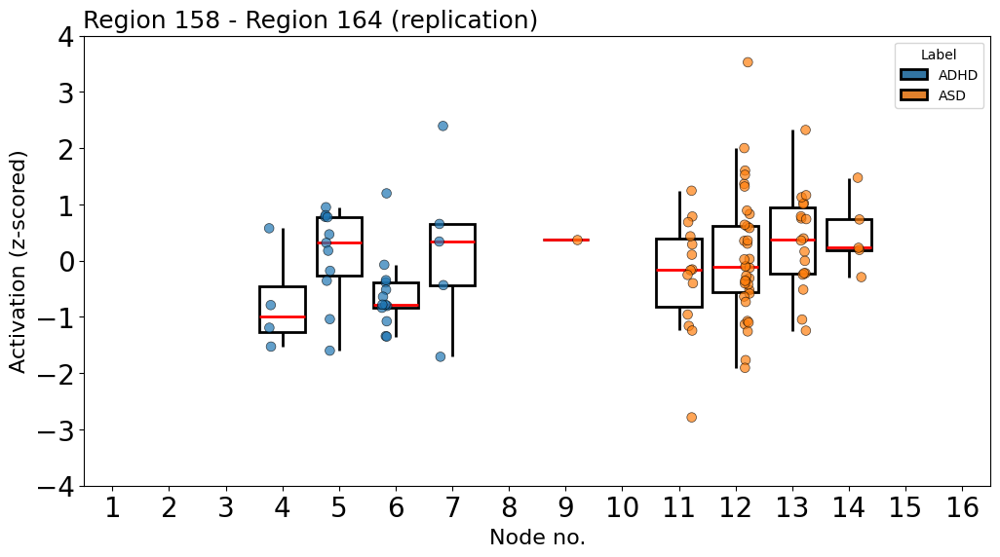

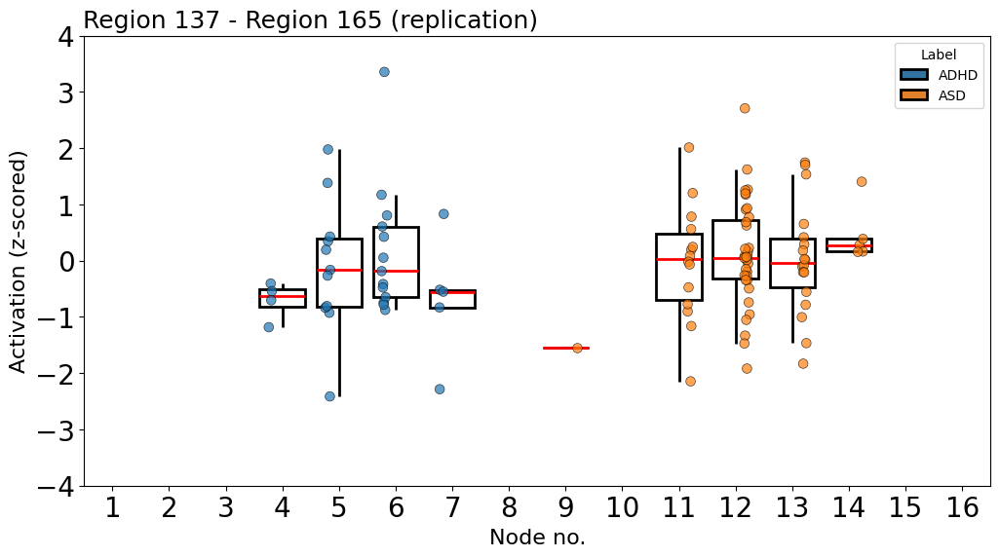

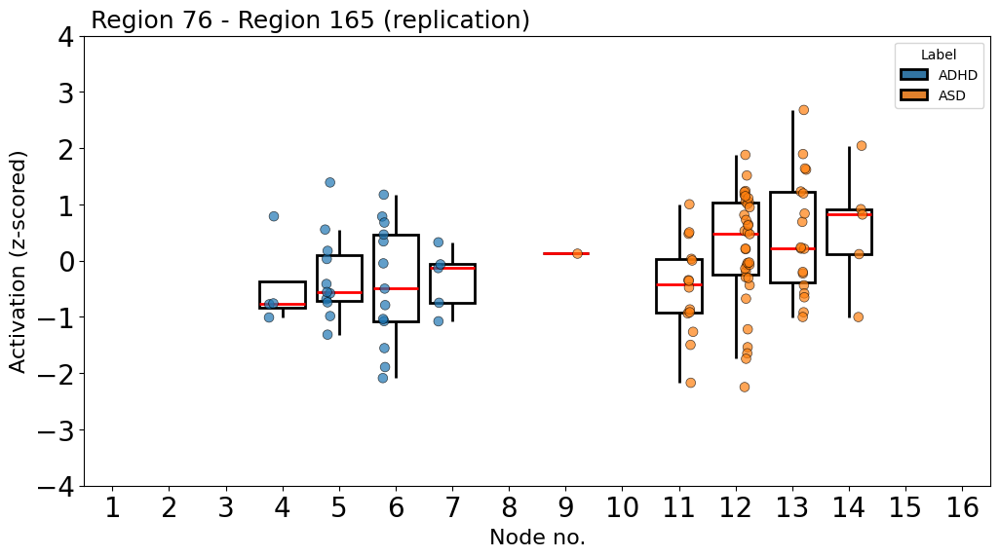

...

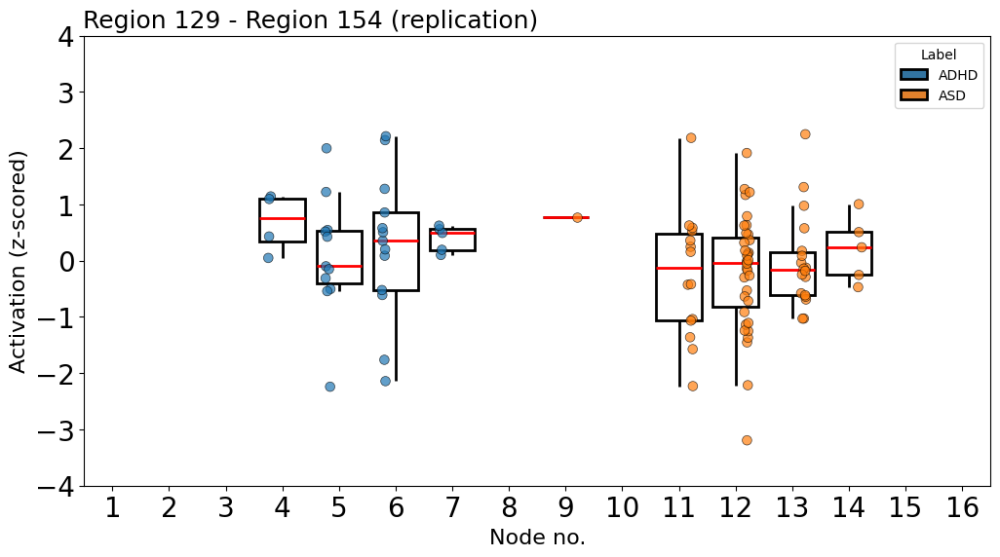

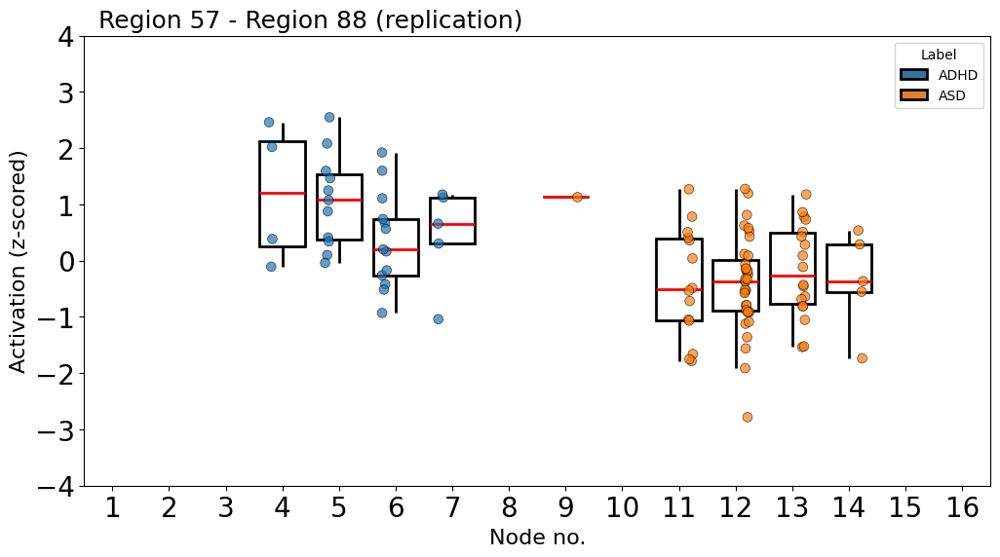

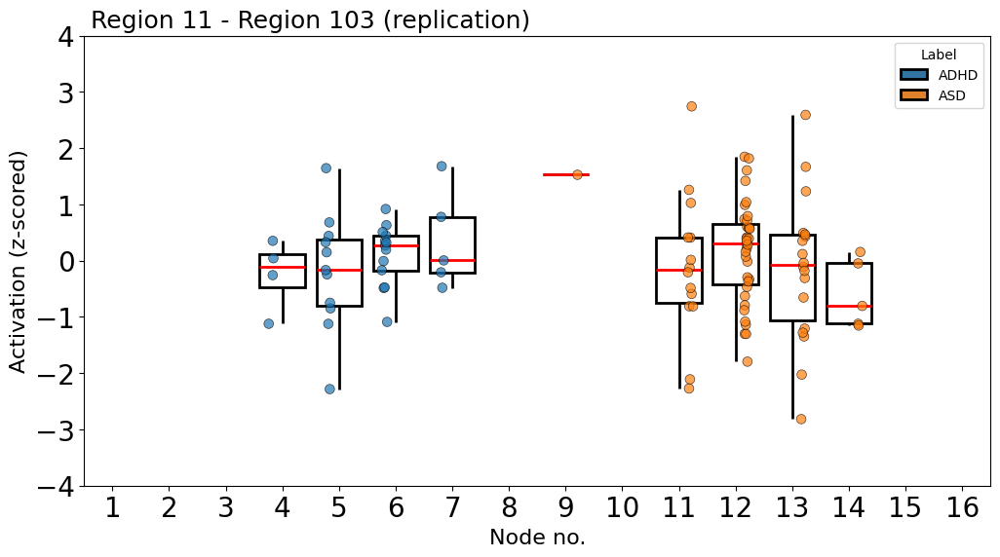

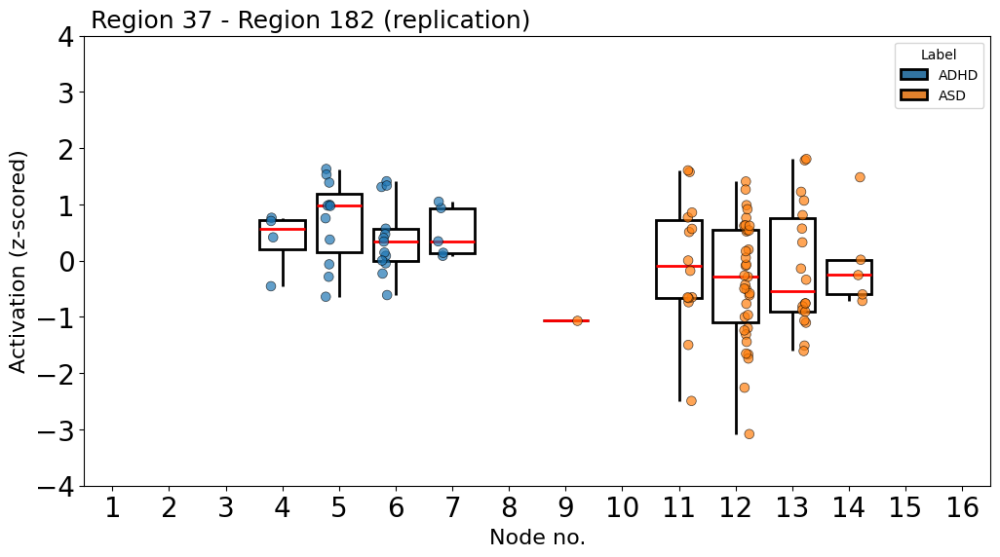

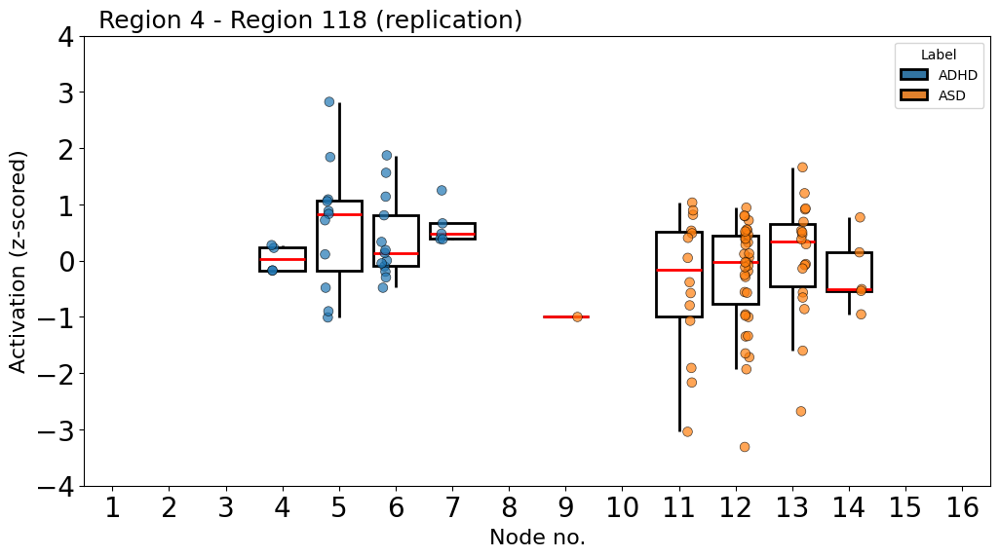

In [ ]:
for n, cpf in enumerate(corr_p_features):
  if(n < 100):
    feature = cpf[0]
    regions = feature_to_regions(feature, map_df)
    title = f"Region {regions[0]} - Region {regions[1]} (replication)"
    multinodes_paired_boxplot_validation(replication_df, feature, [i for i in range(1,17)], title)
    file_name = f"region_{regions[0]}-{regions[1]}_replication.png"
    fig.savefig(f"{SOURCE_DIR}/plots/{file_name}", dpi=300, bbox_inches='tight')

## Pattern 3

In [ ]:
corr_side_3

[(1151, np.float64(-0.9120294849250385), np.float64(0.9898973521657448)),
 (7342, np.float64(-0.8794814597528289), np.float64(0.9561357242912845)),
 (7048, np.float64(-0.8373386075050169), np.float64(0.9863500098152702)),
 (221, np.float64(-0.8920179796212031), np.float64(0.9016173034191749)),
 (3875, np.float64(-0.8234401504087949), np.float64(0.9683131519608213)),
 (2772, np.float64(-0.8030852272081859), np.float64(0.9479592060107026)),
 (6963, np.float64(-0.8706955608032979), np.float64(0.8117765473576591)),
 (4958, np.float64(-0.8503510860855725), np.float64(0.8167822020683778))]

In [ ]:
stability_dict = stability_of_mapper_features(discovery_df, replication_df, [f[0] for f in corr_side_3[:5]])
stability_dict

{1151: 0.5555555555555556,
 7342: 0.8888888888888888,
 7048: 0.4444444444444444,
 221: 0.6666666666666666,
 3875: 0.6666666666666666}

In [ ]:
average_stability(discovery_df, replication_df, [f[0] for f in corr_side_3])

0.736111111111111

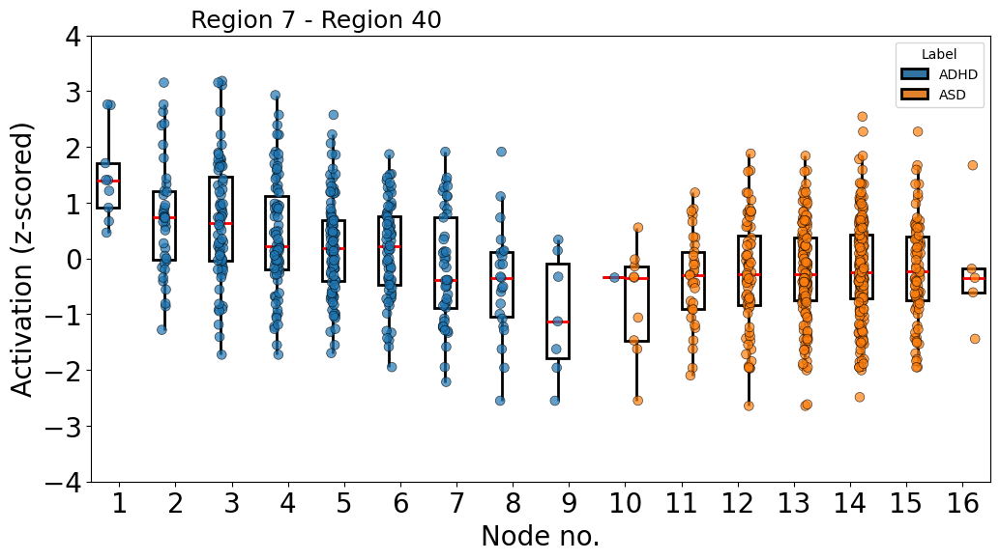

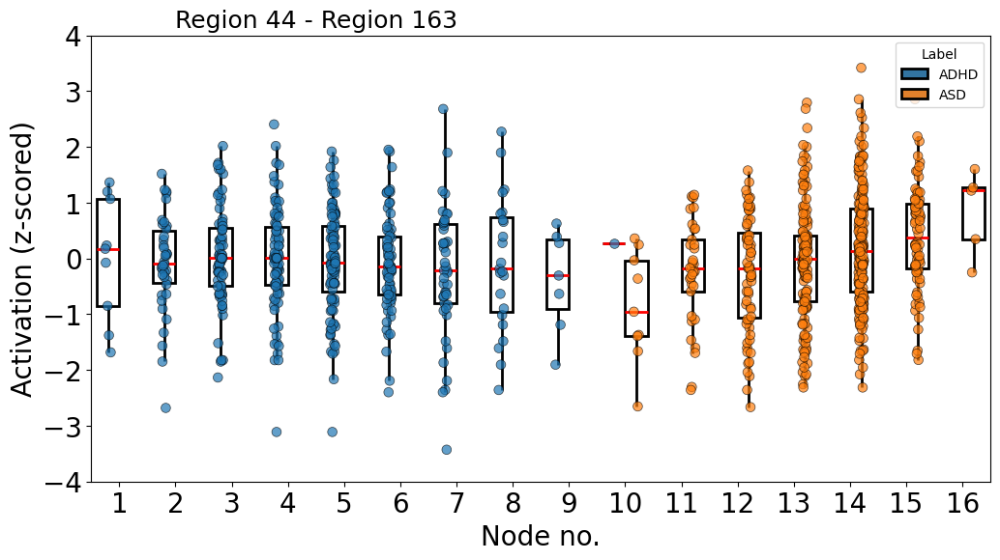

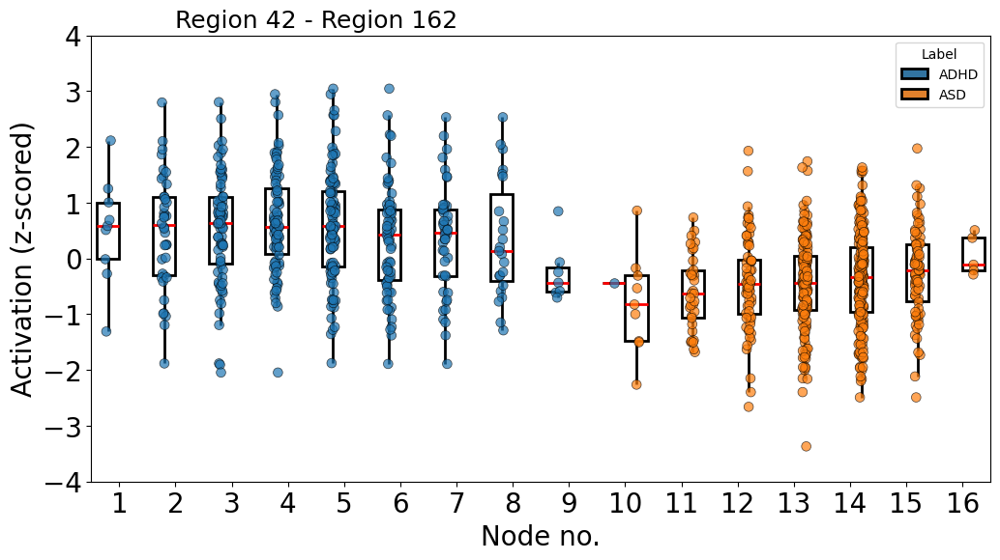

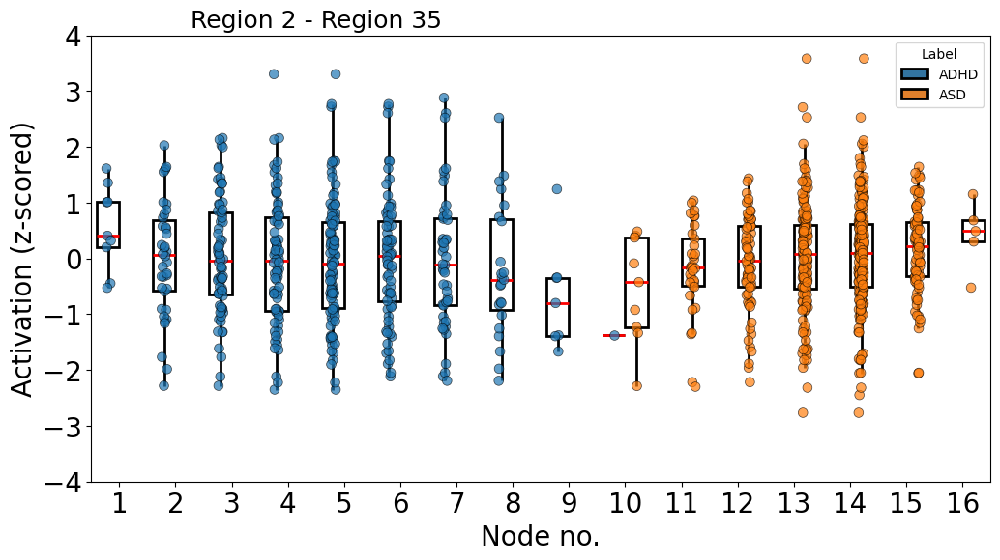

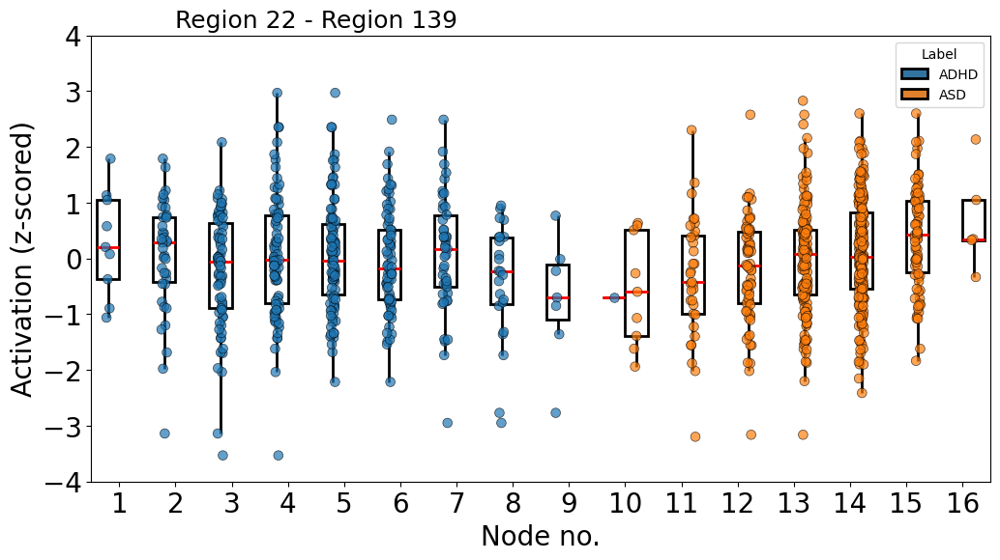

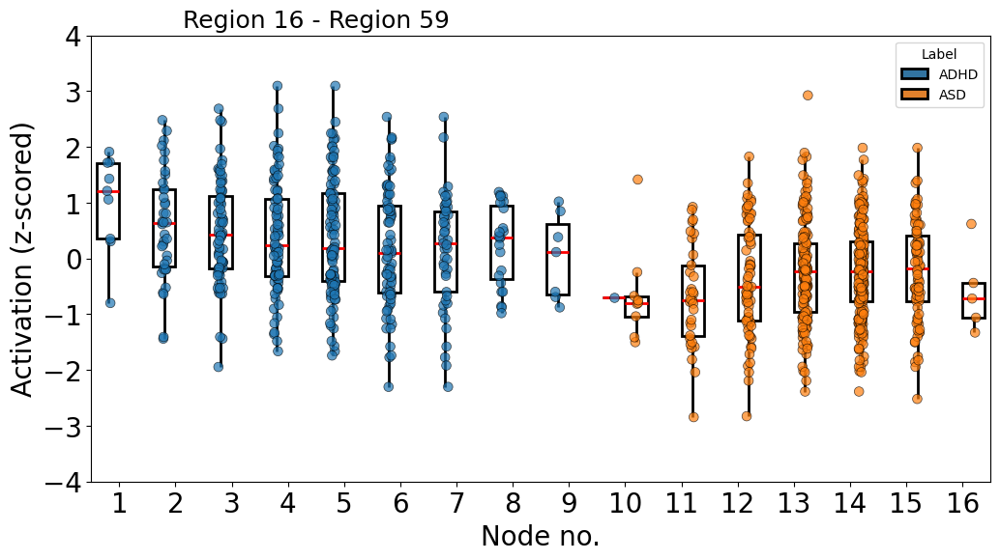

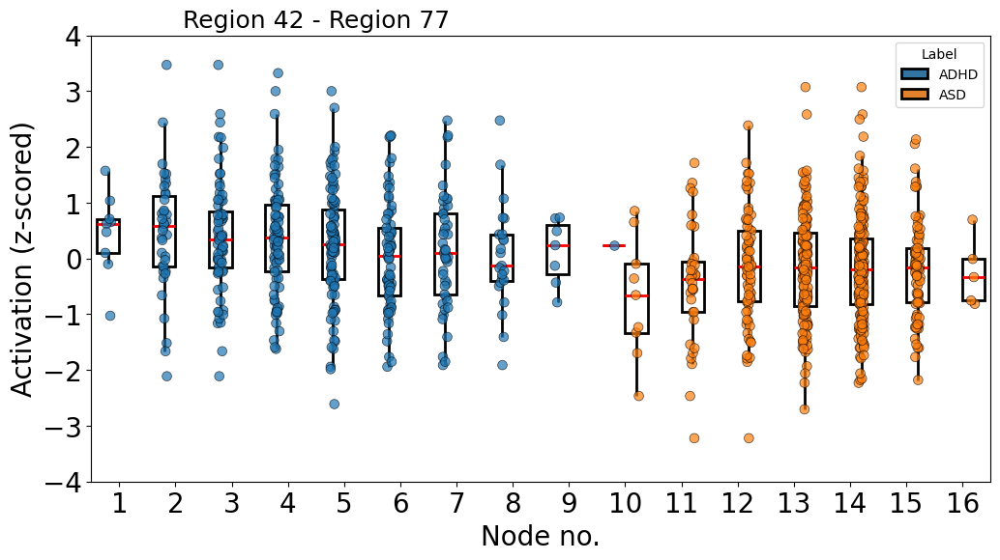

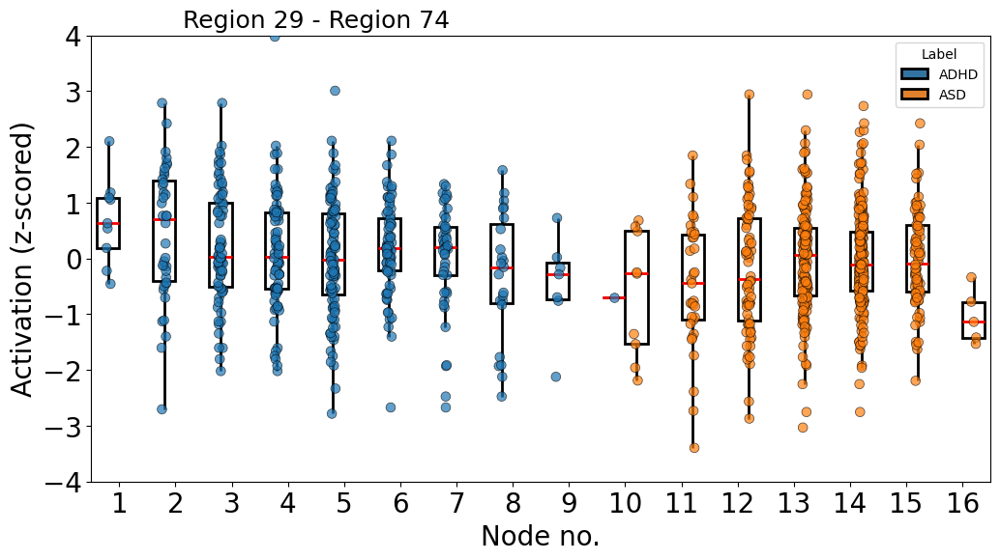

In [ ]:
for n, cpf in enumerate(corr_side_3):
  if(n < 100):
    feature = cpf[0]
    regions = feature_to_regions(feature, map_df)
    multinodes_paired_boxplot(discovery_df, feature, [i for i in range(1,17)], f"Region {regions[0]} - Region {regions[1]}")


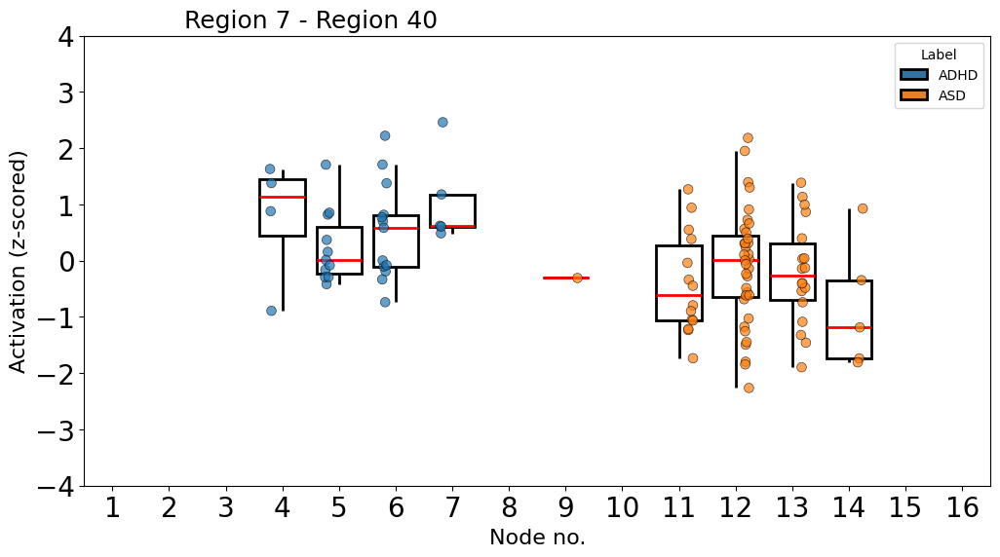

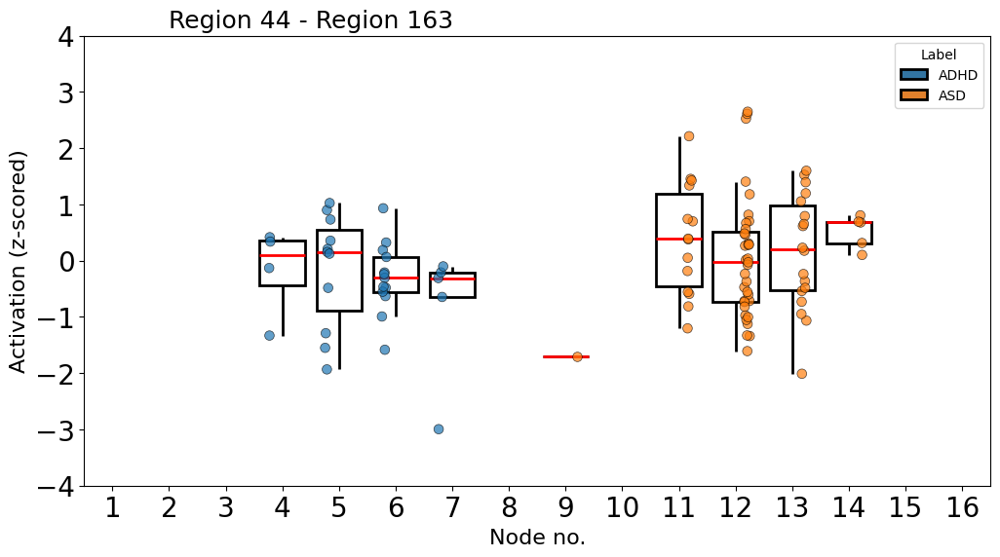

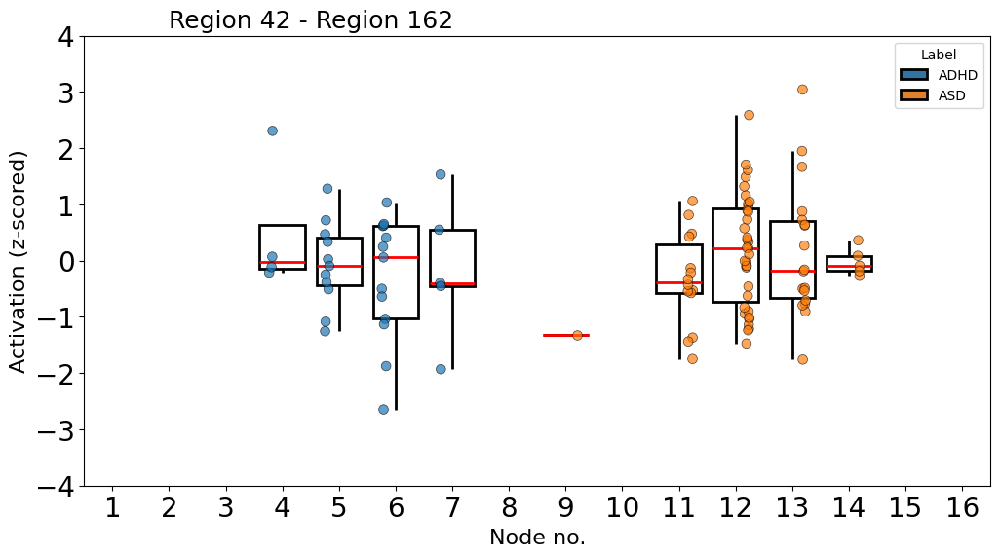

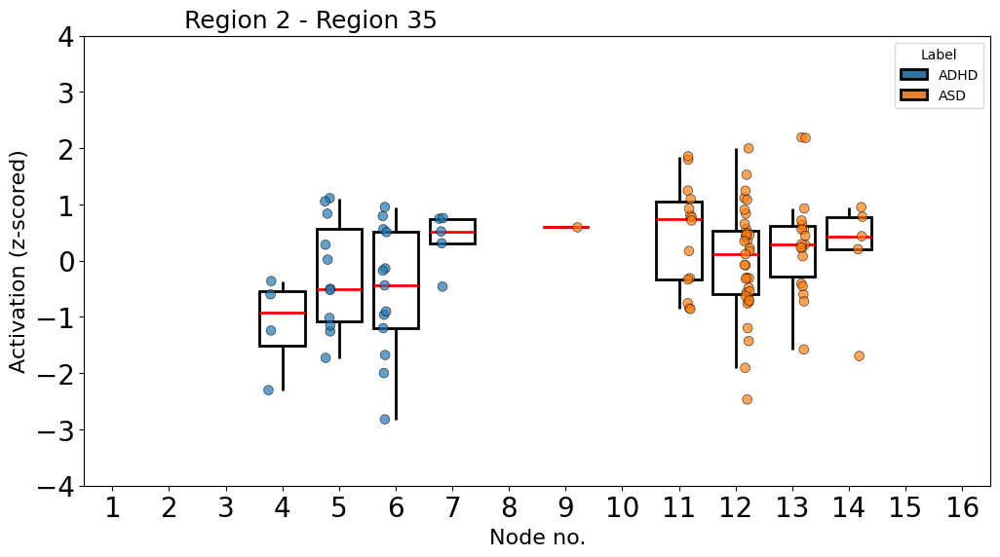

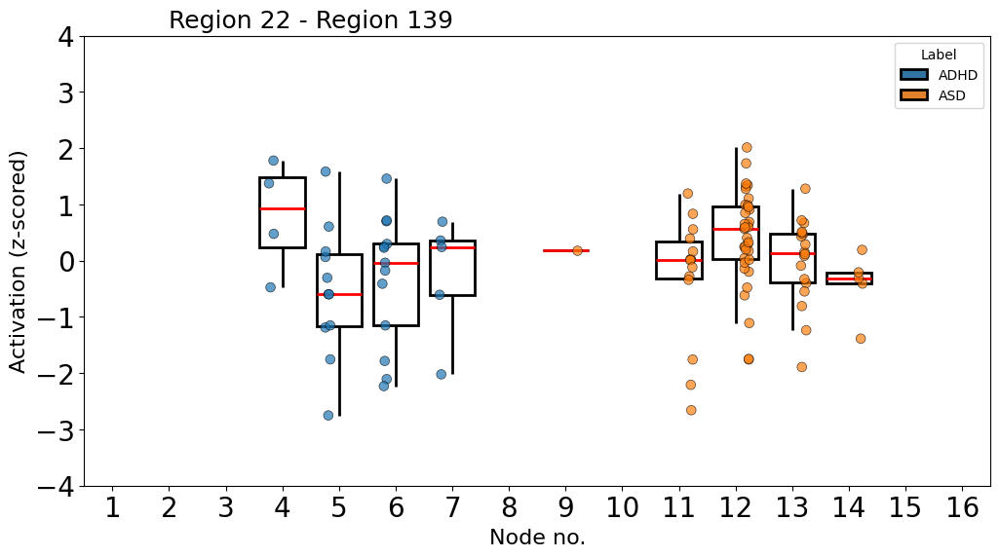

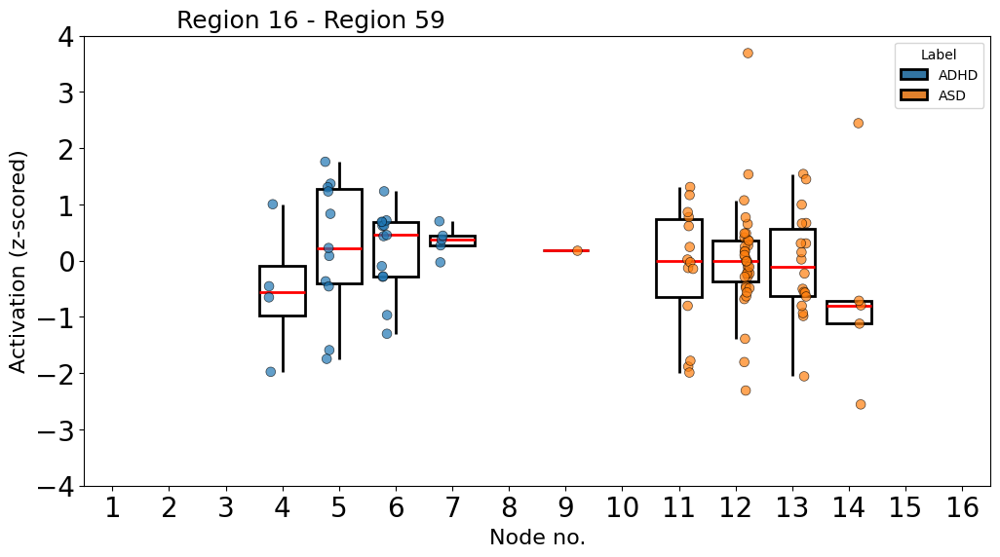

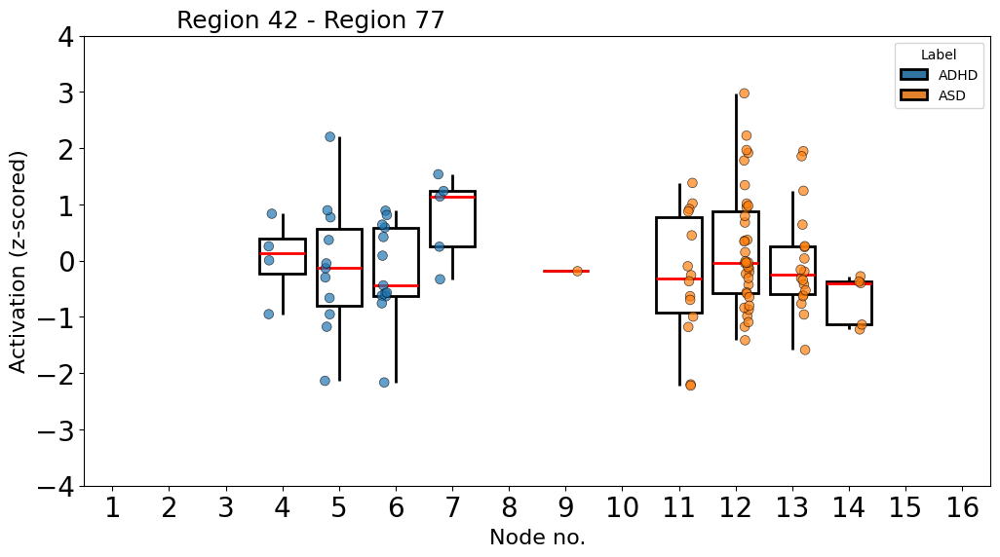

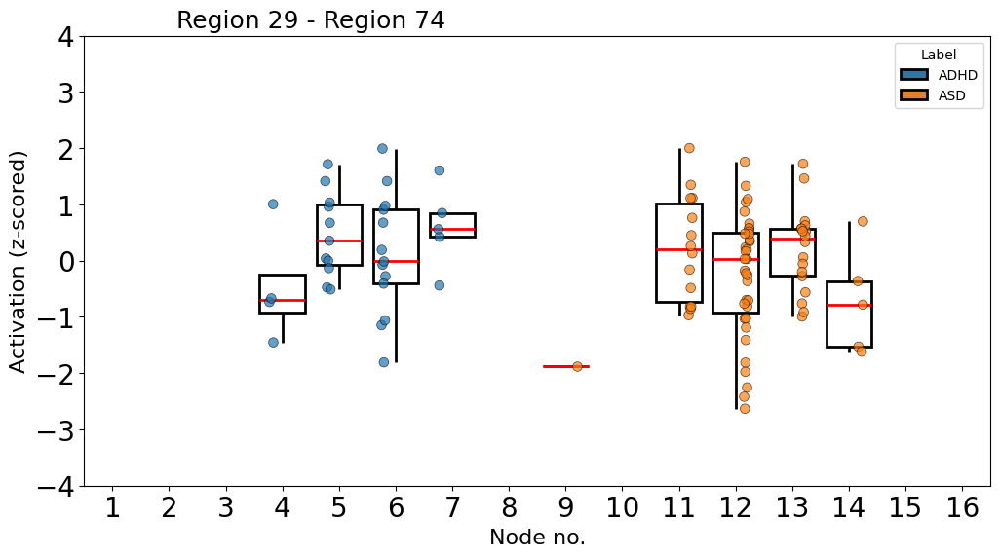

In [ ]:
for n, cpf in enumerate(corr_side_3):
  if(n < 100):
    feature = cpf[0]
    regions = feature_to_regions(feature, map_df)
    multinodes_paired_boxplot_validation(replication_df, feature, [i for i in range(1,17)], f"Region {regions[0]} - Region {regions[1]}")


## Pattern 4

In [ ]:
corr_side_4

[(17908, np.float64(0.8314509644800083), np.float64(-0.9878247544830194)),
 (2010, np.float64(0.8970447112132697), np.float64(-0.8734452796813936)),
 (5511, np.float64(0.8228639728540529), np.float64(-0.9081374907864754)),
 (5924, np.float64(0.8162875903174577), np.float64(-0.8835835928602652))]

In [ ]:
stability_dict = stability_of_mapper_features(discovery_df, replication_df, [f[0] for f in corr_side_4[:5]])
stability_dict

{17908: 1.0,
 2010: 0.8888888888888888,
 5511: 0.7777777777777778,
 5924: 0.8888888888888888}

In [ ]:
average_stability(discovery_df, replication_df, [f[0] for f in corr_side_4])

0.8888888888888888

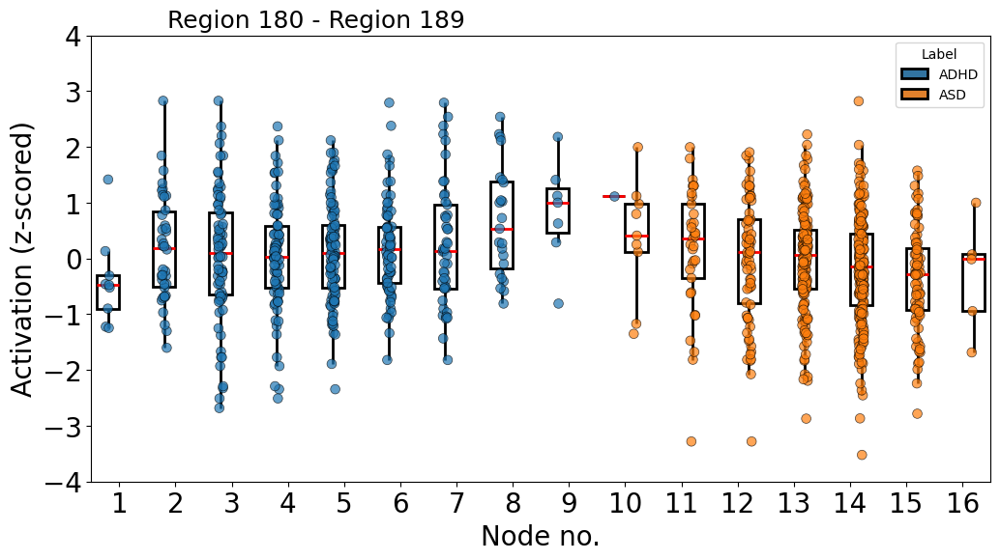

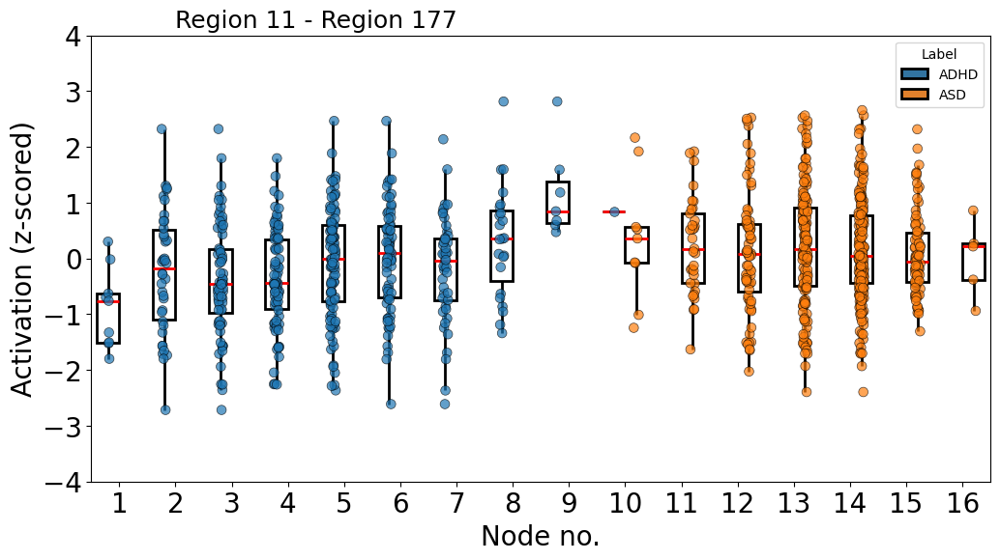

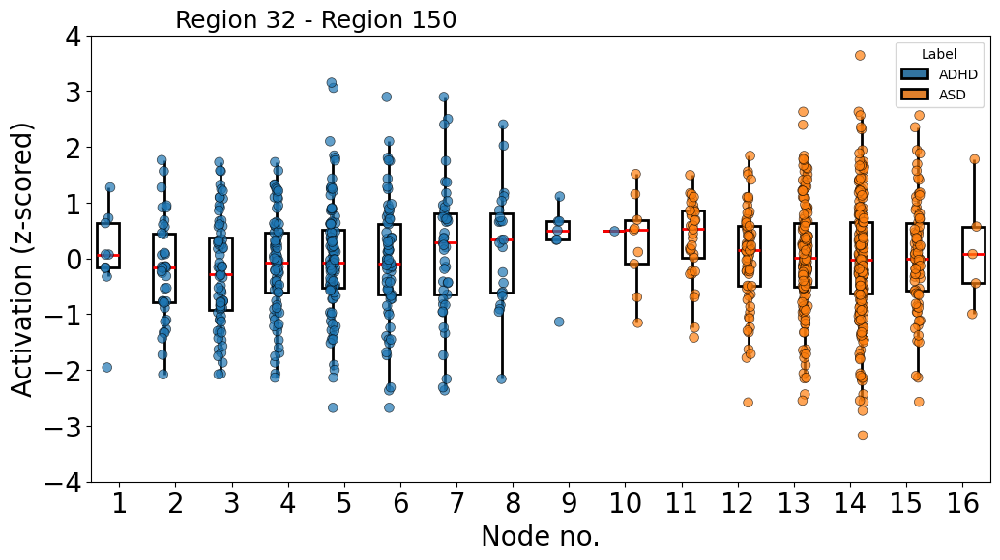

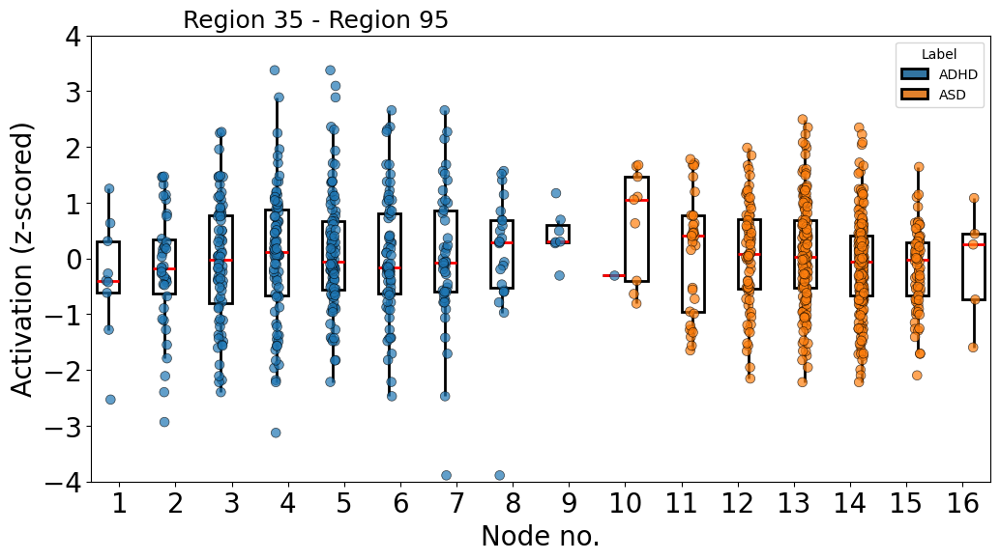

In [ ]:
for n, cpf in enumerate(corr_side_4):
  if(n < 100):
    feature = cpf[0]
    regions = feature_to_regions(feature, map_df)
    multinodes_paired_boxplot(discovery_df, feature, [i for i in range(1,17)], f"Region {regions[0]} - Region {regions[1]}")


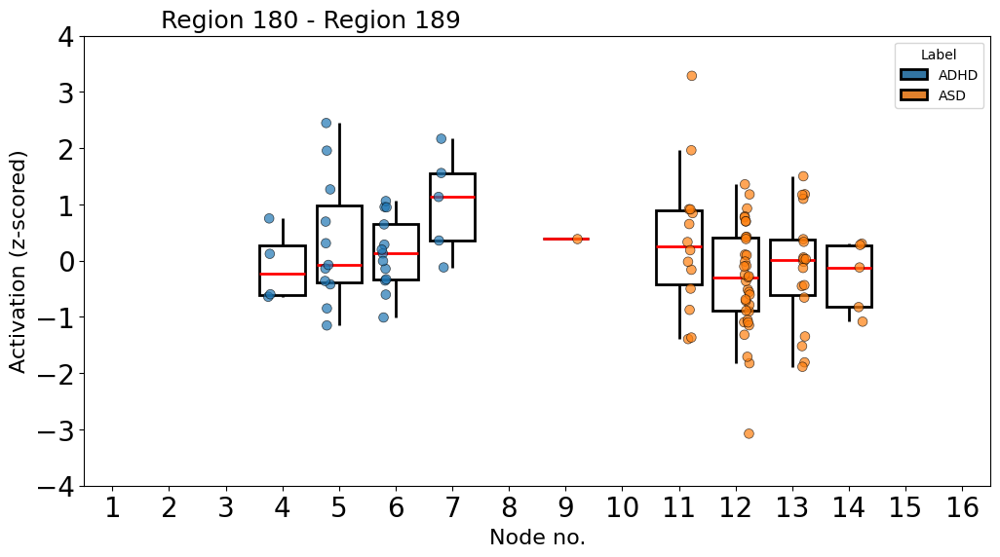

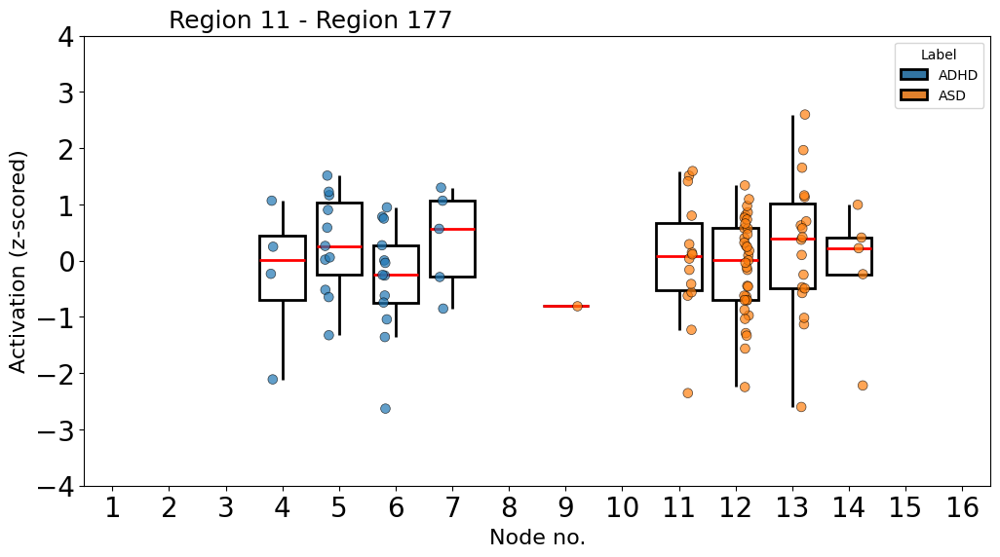

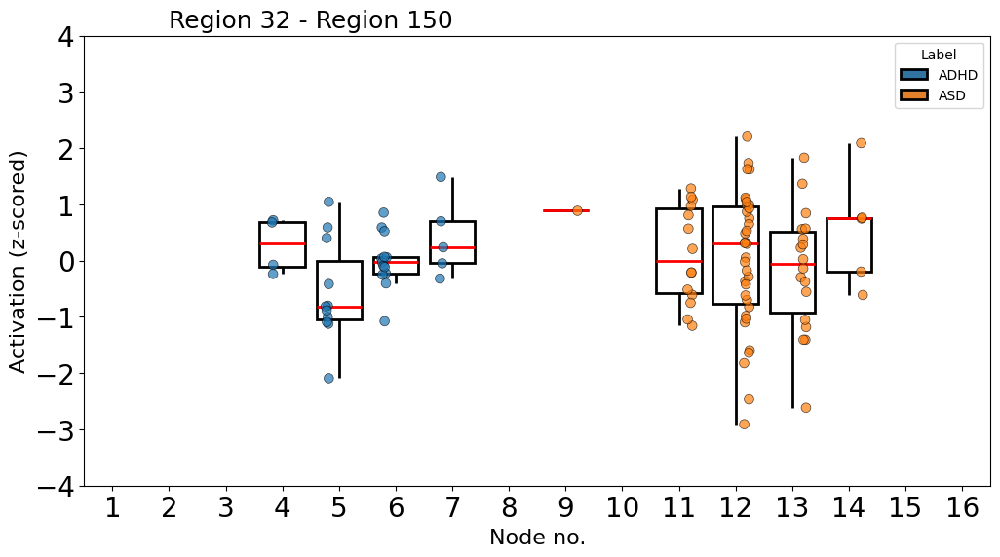

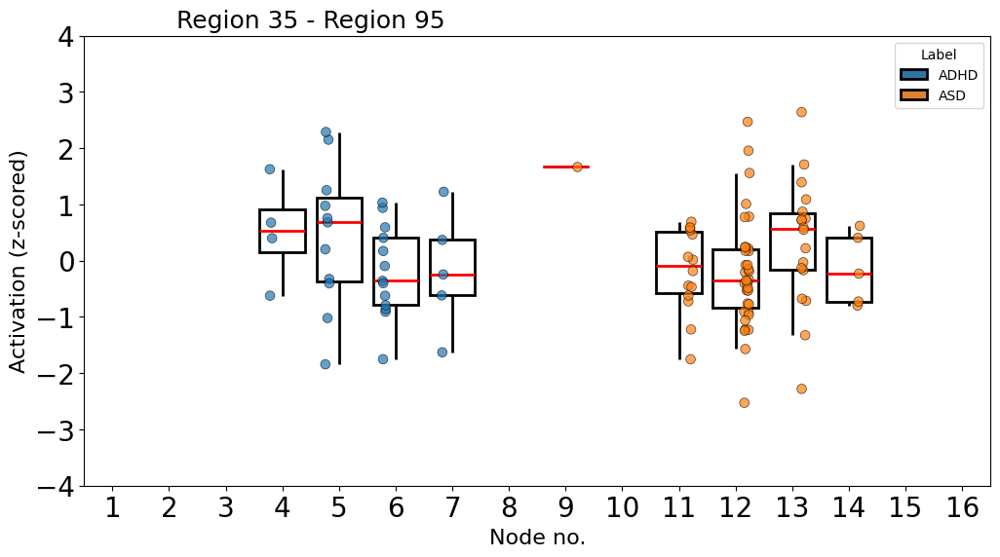

In [ ]:
for n, cpf in enumerate(corr_side_4):
  if(n < 100):
    feature = cpf[0]
    regions = feature_to_regions(feature, map_df)
    multinodes_paired_boxplot_validation(replication_df, feature, [i for i in range(1,17)], f"Region {regions[0]} - Region {regions[1]}")

## Log Subjects

In [ ]:
import csv
def get_subject_from_node(graph_file, vector_ids, node_id):
  map_node_id = list(graph_file['nodes'].keys())


  node = graph_file['nodes'][map_node_id[node_id-1]]['vertices']
  # print(node)
  subject_ids = []
  for i in node:
    subject_id = vector_ids[i]
    subject_ids.append(subject_id)
  return subject_ids

def log_subjects(graph_file, vector_ids, node_ids, file_name):
  subject_ids = []
  for node_id in node_ids:
    s_id = get_subject_from_node(graph_file, vector_ids, node_id)
    subject_ids.extend(s_id)

  subject_ids = list(set(subject_ids))
  output_file = f"{SOURCE_DIR}/extracted_subjects/{file_name}.csv"

  with open(output_file, mode='w', newline='') as file:
    writer = csv.writer(file)
    writer.writerow(['subject_id', 'label'])
    for subject_id in subject_ids:
      writer.writerow([subject_id, dataset.label_name[np.where(dataset.ids == subject_id)[0][0]]])

def get_intersection_two_nodes(graph_file, vector_ids, node_id_1, node_id_2):
  subjects = []
  node_1 = set(dataset.ids[filter_by_mapper_node(graph_file, discovery_df, node_id_1).index])
  node_2 = set(dataset.ids[filter_by_mapper_node(graph_file, discovery_df, node_id_2).index])
  b = node_1.intersection(node_2)
  for i in b:
    subjects.append((int(i), str(dataset.label_name[np.where(dataset.ids == i)[0][0]])))
  return subjects

def get_difference_two_nodes(graph_file, vector_ids, node_id_1, node_id_2):
  subjects = []
  node_1 = set(dataset.ids[filter_by_mapper_node(graph_file, discovery_df, node_id_1).index])
  node_2 = set(dataset.ids[filter_by_mapper_node(graph_file, discovery_df, node_id_2).index])
  b = node_1 - node_2
  for i in b:
    subjects.append((int(i), str(dataset.label_name[np.where(dataset.ids == i)[0][0]])))
  return subjects

def get_exclusive_subjects_from_node(graph_file, vector_ids, node_id, adj_nodes):
  subjects = []
  node = set(dataset.ids[filter_by_mapper_node(graph_file, discovery_df, node_id).index])
  for adj_node in adj_nodes:
    node -= set(dataset.ids[filter_by_mapper_node(graph_file, discovery_df, adj_node).index])

  for i in node:
    subjects.append((int(i), str(dataset.label_name[np.where(dataset.ids == i)[0][0]])))
  return subjects



In [ ]:
drive.flush_and_unmount()
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
indices = discovery_df.index
vector_ids = dataset.ids[indices]

In [ ]:
for node_id in range(1, 20):
  log_subjects(graph_file, vector_ids, [node_id], f"node_{node_id}_discovery_20_40")

In [ ]:
get_intersection_two_nodes(graph_file, vector_ids, 1, 2)

[(2773205, 'ADHD-Inattentive'),
 (25014, 'ADHD-Inattentive'),
 (3433846, 'ADHD-Combined'),
 (3378296, 'ADHD-Combined'),
 (3349205, 'ADHD-Inattentive'),
 (9002207, 'ADHD-Combined')]

In [ ]:
get_difference_two_nodes(graph_file, vector_ids, 1, 2)

[(25002, 'ADHD-Inattentive'),
 (2529026, 'ADHD-Inattentive'),
 (21039, 'ADHD-Combined')]

In [ ]:
get_difference_two_nodes(graph_file, vector_ids, 2, 1)

[(2174595, 'ADHD-Combined'),
 (4053388, 'ADHD-Combined'),
 (1561488, 'ADHD-Inattentive'),
 (2599965, 'ADHD-Combined'),
 (4055710, 'ADHD-Inattentive'),
 (4334113, 'ADHD-Inattentive'),
 (1341865, 'ADHD-Combined'),
 (4241194, 'ADHD-Combined'),
 (3712305, 'ADHD-Inattentive'),
 (10044, 'ADHD-Combined'),
 (3561920, 'ADHD-Combined'),
 (1843546, 'ADHD-Inattentive'),
 (1992284, 'ADHD-Combined'),
 (6383713, 'ADHD-Combined'),
 (7689953, 'ADHD-Inattentive'),
 (3691107, 'ADHD-Combined'),
 (10086, 'ADHD-Combined'),
 (3653737, 'ADHD-Combined'),
 (3672300, 'ADHD-Inattentive'),
 (10095, 'ADHD-Combined'),
 (4095229, 'ADHD-Combined')]

In [ ]:
for i in get_intersection_two_nodes(graph_file, vector_ids, 18, 19):
    print(i[0], i[1])

50985 Autism
50276 Autism


In [ ]:

for k in [2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18]:
  print(k)
  count = {
      'ADHD-Hyperactive': 0,
      'ADHD-Combined': 0,
      'ADHD-Inattentive': 0,
      'Asperger': 0,
      'Autism': 0,
  }

  for i in get_exclusive_subjects_from_node(graph_file, vector_ids, k, [k-1,k+1]):
    if(count[i[1]] == 0):
      print(i[0], i[1])
      count[i[1]] += 1



2
4055710 ADHD-Inattentive
1341865 ADHD-Combined
3
1771270 ADHD-Inattentive
1094669 ADHD-Combined
4
2141250 ADHD-Inattentive
4075719 ADHD-Combined
5
10001 ADHD-Inattentive
10032 ADHD-Combined
6
21025 ADHD-Inattentive
2950754 ADHD-Combined
7
10019 ADHD-Combined
1740607 ADHD-Inattentive
8
10118 ADHD-Combined
10087 ADHD-Inattentive
9
2014113 ADHD-Combined
1552181 ADHD-Inattentive
10
20008 ADHD-Combined
1996183 ADHD-Inattentive
11
50508 Autism
12
50511 Autism
50615 Asperger
13
50304 Autism
14
50984 Autism
15
51205 Autism
50284 Asperger
16
51211 Autism
50796 Asperger
17
51218 Autism
50803 Asperger
18
50189 Asperger


In [ ]:
count = {
    'ADHD-Hyperactive': 0,
    'ADHD-Combined': 0,
    'ADHD-Inattentive': 0,
    'Asperger': 0,
    'Autism': 0,
}
for i in get_intersection_two_nodes(graph_file, vector_ids, 19, 18):
  if(count[i[1]] == 0):
    print(i[0], i[1])
    count[i[1]] += 1

50985 Autism


In [ ]:
node_1 = set(dataset.ids[filter_by_mapper_node(graph_file, discovery_df, 1).index])
node_2 = set(dataset.ids[filter_by_mapper_node(graph_file, discovery_df, 2).index])
b = node_1.intersection(node_2)
for i in b:
  print(i, dataset.label_name[np.where(dataset.ids == i)[0][0]])

2773205 ADHD-Inattentive
25014 ADHD-Inattentive
3433846 ADHD-Combined
3378296 ADHD-Combined
3349205 ADHD-Inattentive
9002207 ADHD-Combined


In [ ]:
node_1 = set(dataset.ids[filter_by_mapper_node(graph_file, discovery_df, 4).index])
node_2 = set(dataset.ids[filter_by_mapper_node(graph_file, discovery_df, 5).index])
b = node_1 - node_2
for i in b:
  print(i, dataset.label_name[np.where(dataset.ids == i)[0][0]])


4095748 ADHD-Combined
1356553 ADHD-Combined
21002 ADHD-Combined
2628237 ADHD-Inattentive
2950672 ADHD-Combined
2570769 ADHD-Combined
21010 ADHD-Inattentive
3910672 ADHD-Combined
2196753 ADHD-Inattentive
3446674 ADHD-Inattentive
10007 ADHD-Inattentive
3827352 ADHD-Inattentive
10018 ADHD-Combined
21027 ADHD-Inattentive
2024999 ADHD-Combined
1883688 ADHD-Inattentive
2940712 ADHD-Inattentive
10025 ADHD-Combined
10026 ADHD-Combined
10028 ADHD-Inattentive
2260910 ADHD-Combined
2601519 ADHD-Inattentive
2030383 ADHD-Combined
21044 ADHD-Combined
10037 ADHD-Combined
21046 ADHD-Combined
2228148 ADHD-Combined
10040 ADHD-Combined
1187766 ADHD-Combined
2854839 ADHD-Inattentive
3976121 ADHD-Combined
3542588 ADHD-Combined
3856956 ADHD-Inattentive
10047 ADHD-Combined
2141250 ADHD-Inattentive
1628610 ADHD-Combined
3601861 ADHD-Combined
4075719 ADHD-Combined
10060 ADHD-Combined
10062 ADHD-Inattentive
1038415 ADHD-Inattentive
3834703 ADHD-Combined
3619797 ADHD-Combined
4073815 ADHD-Inattentive
10072 ADHD-

In [ ]:
get_exclusive_subjects_from_node(graph_file, vector_ids, 2, [1,3])

[(4055710, 'ADHD-Inattentive'), (1341865, 'ADHD-Combined')]

In [ ]:
get_difference_two_nodes(graph_file, vector_ids, 2, 3)

[(1341865, 'ADHD-Combined'),
 (3349205, 'ADHD-Inattentive'),
 (25014, 'ADHD-Inattentive'),
 (2773205, 'ADHD-Inattentive'),
 (3433846, 'ADHD-Combined'),
 (3378296, 'ADHD-Combined'),
 (4055710, 'ADHD-Inattentive'),
 (9002207, 'ADHD-Combined')]